In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import pickle

from time import time

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.autograd as autograd
from torch.autograd import Variable
import torch.optim as optim

In [3]:
torch.__version__

'0.3.1.post3'

In [4]:
USE_CUDA = torch.cuda.is_available()
USE_CUDA

True

In [5]:
def cuda_wrapper(torch_obj):
    if USE_CUDA:
        return torch_obj.cuda()
    else:
        return torch_obj

In [6]:
from torchvision.datasets import MNIST, CIFAR10
from torchvision import transforms
from torch.utils.data import TensorDataset, DataLoader

In [7]:
batch_size = 25

In [8]:
kwargs = {'num_workers': 1, 'pin_memory': True} if USE_CUDA else {}

dataset = CIFAR10

train_loader = torch.utils.data.DataLoader(
    dataset(
        './data', train=True, download=True, transform=transforms.ToTensor()
    ),
    batch_size=batch_size, shuffle=True, **kwargs
)

test_loader = torch.utils.data.DataLoader(
    dataset(
        './data', train=False, transform=transforms.ToTensor()
    ),
    batch_size=batch_size, shuffle=True, **kwargs
)

Files already downloaded and verified


In [9]:
print(train_loader.dataset.train_data.shape)
print(test_loader.dataset.test_data.shape)

(50000, 32, 32, 3)
(10000, 32, 32, 3)


In [10]:
from sklearn.model_selection import train_test_split

train_dataset_labelled, train_dataset_unlabelled, train_labels_labelled, train_labels_unlabelled = train_test_split(
    train_loader.dataset.train_data, np.array(train_loader.dataset.train_labels), train_size=4000
)
train_dataset_labelled.shape, train_dataset_unlabelled.shape, train_labels_labelled.shape, train_labels_unlabelled.shape

/home/golikov/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2026: FutureWarning: From version 0.21, test_size will always complement train_size unless both are specified.
  FutureWarning)


((4000, 32, 32, 3), (46000, 32, 32, 3), (4000,), (46000,))

In [11]:
np.sum(np.array(train_loader.dataset.train_labels) == 0) / np.array(train_loader.dataset.train_labels).shape[0]

0.10000000000000001

In [12]:
np.max(train_dataset_labelled)

255

In [13]:
train_loader_labelled = DataLoader(
    TensorDataset(
        torch.from_numpy(np.transpose(train_dataset_labelled, (0,3,1,2))).float() / 255, 
        torch.Tensor(train_labels_labelled).long()
    ),
    batch_size=batch_size, shuffle=True, **kwargs
)
train_loader_unlabelled = DataLoader(
    TensorDataset(
        torch.from_numpy(np.transpose(train_dataset_unlabelled, (0,3,1,2))).float() / 255, 
        torch.Tensor(train_labels_unlabelled).long()
    ),
    batch_size=batch_size, shuffle=True, **kwargs
)

In [14]:
input_shape = train_loader.dataset.train_data.shape[1:]
input_shape = input_shape[-1:] + input_shape[:-1]
output_size = 10

**WAE-WGAN**

In [23]:
def binary_crossentropy_loss(x_true, x_distr):
    """
    Вычисляет бинарную кроссэнтропию между эмприческим распределением на данные
    и индуцированным моделью распределением, т. е. правдоподобие объектов x_true.
    Каждому объекту из x_true соответствуют K сэмплированных распределений
    на x из x_distr.
    i-му объекту соответствуют распределения с номерами i * K, ..., (i + 1) * K - 1.
    Требуется вычислить оценку логарифма правдоподобия для каждого объекта.
    Подсказка: не забывайте про вычислительную стабильность!

    Вход: x_true, Variable - матрица объектов размера n x D.
    Вход: x_distr, Variable - матрица параметров распределений Бернулли
    размера (n * K) x D.
    Выход: Variable, матрица размера n x K - оценки логарифма правдоподобия
    каждого сэмпла.
    """
    K = x_distr.shape[0] // x_true.shape[0]
    #print(x_true.shape, x_distr.shape)
    n, D = x_true.shape
    eps = 1e-5
    x_distr = torch.clamp(x_distr.view(n, K, D), eps, 1-eps)
    x_true = x_true.view(n, 1, D)
    return -torch.sum(torch.log(x_distr) * x_true + torch.log(1 - x_distr) * (1 - x_true), dim=2)

In [24]:
class ReshapeLayer(nn.Module):
    def __init__(self, *args):
        super(ReshapeLayer, self).__init__()
        self.shape = args

    def forward(self, x):
        return x.view(x.shape[0], *self.shape)

In [25]:
class GeneratorConditioned(nn.Module):
    def __init__(self, input_shape, latent_dim, output_dim):
        super(type(self), self).__init__()
        assert input_shape[1] == input_shape[2]
        self.latent_dim = latent_dim

        self.image_processor = nn.Sequential(
            nn.Conv2d(input_shape[0], 16, 5, padding=2),
            nn.Softplus(),
            nn.Conv2d(16, 32, 5, padding=2),
            nn.Softplus(),
            nn.Conv2d(32, 32, 5, padding=2, stride=2),
            nn.Softplus(),
            ReshapeLayer(-1)
        )
        self.noise_processor = nn.Sequential(
            nn.Linear(latent_dim, latent_dim*2),
            nn.Softplus(),
            nn.Linear(latent_dim*2, latent_dim*2),
            nn.Softplus()
        )
        self.output_layer = nn.Linear(32 * 16 * 16 + latent_dim * 2, output_dim)

    def forward(self, X, Z=None):
        if Z is None:
            Z = torch.normal(means=cuda_wrapper(Variable(torch.zeros(X.shape[0], self.latent_dim))))
        return self.output_layer(torch.cat([self.image_processor(X), self.noise_processor(Z)], dim=-1))

In [26]:
class Discriminator(nn.Module):
    def __init__(self, input_dim, hidden_dim, hidden_count=2):
        super(type(self), self).__init__()

        self.layers = nn.ModuleList([
            nn.Linear(input_dim, hidden_dim),
            nn.LeakyReLU(negative_slope=0.2)
        ])
        for _ in range(hidden_count-1):
            self.layers.append(nn.Linear(hidden_dim, hidden_dim))
            self.layers.append(nn.LeakyReLU(negative_slope=0.2))
        self.layers.append(nn.Linear(hidden_dim, 1))

    def forward(self, X):
        Z = X
        for layer in self.layers:
            Z = layer(Z)
        return Z

In [36]:
class ModelConvolutional(nn.Module):
    def __init__(
        self, input_shape, output_size 
    ):
        super(type(self), self).__init__()
        assert input_shape[1] == input_shape[2]
        self.layers = nn.ModuleList([
            nn.Dropout(p=0.2),
            nn.Conv2d(input_shape[0], 96, 3, padding=1),
            nn.BatchNorm2d(96),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(96, 96, 3, padding=1),
            nn.BatchNorm2d(96),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(96, 96, 3, padding=1),
            nn.BatchNorm2d(96),
            nn.LeakyReLU(negative_slope=0.2),
            nn.MaxPool2d(2),
            nn.BatchNorm2d(96),
            
            nn.Dropout(p=0.5),
            nn.Conv2d(96, 192, 3, padding=1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(192, 192, 3, padding=1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(192, 192, 3, padding=1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.MaxPool2d(2),
            nn.BatchNorm2d(192),
            
            nn.Dropout(p=0.5),
            nn.Conv2d(192, 192, 3),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(192, 192, 1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(192, 192, 1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.AvgPool2d(6)
        ])
        self.output_layer = nn.utils.weight_norm(nn.Linear(192, 10))
        
    def forward(self, X):
        for layer in self.layers:
            X = layer(X)
        X = X.view(X.shape[0], -1)
        return F.softmax(self.output_layer(X), dim=-1)

In [28]:
def to_one_hot(y, n_dims=None):
    """ Take integer y (tensor or variable) with n dims and convert it to 1-hot representation with n+1 dims. """
    y_tensor = y.data if isinstance(y, Variable) else y
    y_tensor = y_tensor.type(torch.cuda.LongTensor).view(-1, 1)
    n_dims = n_dims if n_dims is not None else int(torch.max(y_tensor)) + 1
    y_one_hot = torch.zeros(y_tensor.size()[0], n_dims).cuda().scatter_(1, y_tensor, 1)
    y_one_hot = y_one_hot.view(*y.shape, -1)
    return Variable(y_one_hot) if isinstance(y, Variable) else y_one_hot

In [37]:
def sample_gumbel(input):
    noise = cuda_wrapper(torch.rand(input.size()))
    eps = 1e-20
    noise.add_(eps).log_().neg_()
    noise.add_(eps).log_().neg_()
    return Variable(noise)

def gumbel_softmax_sample(input, temperature=1, hard=False):
    noise = sample_gumbel(input)
    x = (input + noise) / temperature
    x = F.softmax(x, dim=-1)

    if hard == True:
        _, max_inx = torch.max(x, x.dim()-1)
        x_hard = cuda_wrapper(torch.FloatTensor(x.size())).zero_().scatter_(x.dim()-1, max_inx.data, 1.0)
        x2 = x.clone()
        tmp = Variable(x_hard-x2.data)
        tmp.detach_()

        x = tmp + x
        
    return x.view_as(input)

In [46]:
class WAE_WGAN_SemiSupervised(nn.Module):
    def __init__(self, input_shape, latent_dim, n_classes,
                 regularization_factor=10, lipschitz_constraint_factor=2):

        super(type(self), self).__init__()
        self.input_shape = input_shape
        self.latent_dim = latent_dim
        self.regularization_factor = regularization_factor
        self.lipschitz_constraint_factor = lipschitz_constraint_factor
        
        self.proposal_generator = GeneratorConditioned(input_shape, latent_dim*2, latent_dim)
        self.proposal_discriminator = Discriminator(latent_dim, latent_dim*2)
        
        self.classifier = ModelConvolutional(input_shape, n_classes)
        
        self.generative_network = nn.Sequential(
            nn.Linear(latent_dim + n_classes, 32 * 16 * 16),
            ReshapeLayer(32, 16, 16),
            nn.Softplus(),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(32, 32, 5, padding=2, stride=2),
            #nn.ConvTranspose2d(32, 32, 5, padding=2, stride=2),
            nn.Softplus(),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(32, 16, 5, padding=2, stride=2),
            #nn.ConvTranspose2d(32, 16, 5, padding=2),
            nn.Softplus(),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(16, input_shape[0], 5, padding=2),
            #nn.ConvTranspose2d(16, input_shape[0], 6, padding=2),
            nn.Sigmoid()
        )

    def prior_distr(self, n):
        mu = cuda_wrapper(Variable(torch.zeros(n, self.latent_dim)))
        sigma = cuda_wrapper(Variable(torch.ones(n, self.latent_dim)))
        return mu, sigma

    def sample_latent(self, X):
        return self.proposal_generator(X)

    def sample_prior(self, num_samples):
        return torch.normal(*self.prior_distr(num_samples))
    
    def classify(self, X):
        return self.classifier(X)

    def generative_distr(self, Z, Y_one_hot):
        return self.generative_network(torch.cat([Z, Y_one_hot], dim=-1))

    def batch_loss(self, X, Y_target=None):
        n = X.shape[0]
        
        Y_distr = self.classify(X)
        if Y_target is None:
            Y_one_hot = gumbel_softmax_sample(Y_distr)
            supervised_loss = None
            accuracy = None
        else:
            Y_one_hot = to_one_hot(Y_target)
            supervised_loss = F.nll_loss(torch.log(Y_distr), Y_target)
            accuracy = torch.mean((torch.max(Y_distr, dim=-1)[1] == Y_target).float())
        
        Z = self.sample_latent(X)
        Z_prior = self.sample_prior(n)
        X_rec = self.generative_distr(Z, sample_gumbel(Y_distr))
        #reconstruction_loss = torch.sum((X_rec - X) ** 2) / n
        reconstruction_loss = torch.sum(binary_crossentropy_loss(X.view(n, -1), X_rec.view(n, -1))) / n
        discriminator_loss = torch.mean(self.proposal_discriminator(Z_prior) - self.proposal_discriminator(Z))
        eps = cuda_wrapper(torch.rand(Z.size(0), 1))
        Z_hat = Variable(Z_prior.data * eps + Z.data * (1 - eps), requires_grad=True)
        value_hat = self.proposal_discriminator(Z_hat)
        value_hat_grad_sqr_norm = torch.sum(
            autograd.grad([torch.sum(value_hat)], [Z_hat], create_graph=True)[0] ** 2, dim=-1
        )
        lipschitz_loss = torch.mean((torch.sqrt(value_hat_grad_sqr_norm) - 1) ** 2)
        return reconstruction_loss - discriminator_loss * self.regularization_factor,\
               (discriminator_loss + lipschitz_loss * self.lipschitz_constraint_factor) * self.regularization_factor,\
               supervised_loss, accuracy

    def generate_samples(self, Y_target):
        return self.generative_distr(self.sample_prior(Y_target.size(0)), to_one_hot(Y_target))

In [21]:
def batch_generator(data, labels, batch_size):
    assert data.shape[0] == labels.shape[0]
    data_size = data.shape[0]
    indices = np.random.permutation(data_size)
    for i in range(0, data_size, batch_size):
        if i+batch_size > data_size:
            yield torch.from_numpy(data[indices[i:]] / 256).float(), torch.from_numpy(labels[indices[i:]])
        else:
            yield (
                torch.from_numpy(data[indices[i:i+batch_size]] / 256).float(), 
                torch.from_numpy(labels[indices[i:i+batch_size]])
            )

In [22]:
def batch_generator_same_labels(data, labels, batch_size, num_labels=10):
    assert data.shape[0] == labels.shape[0]
    for label in np.random.permutation(num_labels):
        batch_gen = batch_generator(data[labels == label], labels[labels == label], batch_size)
        for X, _ in batch_gen:
            yield X, label

Epoch 1 of 2000 took 35.51s;
train unlabelled reconstruction loss: 2136.45;
train labelled reconstruction loss: 2132.77; train labelled classification loss: 2.23; train accuracy: 0.172
test labelled reconstruction loss: 2133.87; test labelled classification loss: 2.16; test accuracy: 0.222
Epoch 2 of 2000 took 34.97s;
train unlabelled reconstruction loss: 2028.51;
train labelled reconstruction loss: 1936.46; train labelled classification loss: 2.13; train accuracy: 0.222
test labelled reconstruction loss: 1936.58; test labelled classification loss: 2.09; test accuracy: 0.240
Epoch 3 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1901.43;
train labelled reconstruction loss: 1881.06; train labelled classification loss: 2.08; train accuracy: 0.231
test labelled reconstruction loss: 1883.79; test labelled classification loss: 2.05; test accuracy: 0.255
Epoch 4 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1871.17;
train labelled reconstruction loss: 1861.21; train 

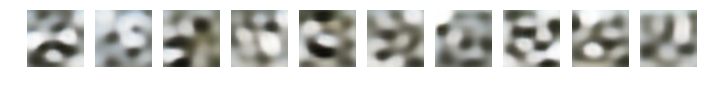

Epoch 11 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1810.31;
train labelled reconstruction loss: 1808.14; train labelled classification loss: 1.87; train accuracy: 0.343
test labelled reconstruction loss: 1812.87; test labelled classification loss: 1.86; test accuracy: 0.337
Epoch 12 of 2000 took 35.51s;
train unlabelled reconstruction loss: 1807.06;
train labelled reconstruction loss: 1804.16; train labelled classification loss: 1.85; train accuracy: 0.343
test labelled reconstruction loss: 1810.15; test labelled classification loss: 1.85; test accuracy: 0.344
Epoch 13 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1801.52;
train labelled reconstruction loss: 1798.79; train labelled classification loss: 1.84; train accuracy: 0.349
test labelled reconstruction loss: 1803.69; test labelled classification loss: 1.84; test accuracy: 0.346
Epoch 14 of 2000 took 35.01s;
train unlabelled reconstruction loss: 1795.20;
train labelled reconstruction loss: 1785.46; tr

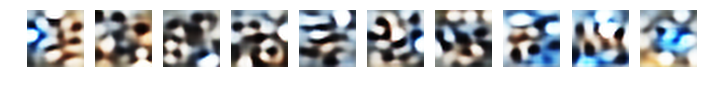

Epoch 21 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1759.05;
train labelled reconstruction loss: 1757.36; train labelled classification loss: 1.75; train accuracy: 0.384
test labelled reconstruction loss: 1758.77; test labelled classification loss: 1.76; test accuracy: 0.373
Epoch 22 of 2000 took 34.95s;
train unlabelled reconstruction loss: 1757.31;
train labelled reconstruction loss: 1756.13; train labelled classification loss: 1.74; train accuracy: 0.386
test labelled reconstruction loss: 1758.92; test labelled classification loss: 1.75; test accuracy: 0.375
Epoch 23 of 2000 took 35.08s;
train unlabelled reconstruction loss: 1754.52;
train labelled reconstruction loss: 1753.15; train labelled classification loss: 1.73; train accuracy: 0.386
test labelled reconstruction loss: 1756.41; test labelled classification loss: 1.74; test accuracy: 0.384
Epoch 24 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1752.49;
train labelled reconstruction loss: 1751.13; tr

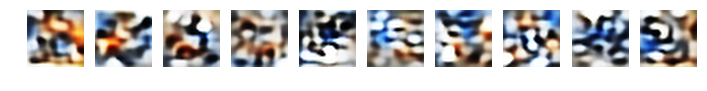

Epoch 31 of 2000 took 35.40s;
train unlabelled reconstruction loss: 1742.80;
train labelled reconstruction loss: 1743.55; train labelled classification loss: 1.67; train accuracy: 0.415
test labelled reconstruction loss: 1748.32; test labelled classification loss: 1.69; test accuracy: 0.398
Epoch 32 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1741.34;
train labelled reconstruction loss: 1740.95; train labelled classification loss: 1.67; train accuracy: 0.407
test labelled reconstruction loss: 1743.54; test labelled classification loss: 1.68; test accuracy: 0.402
Epoch 33 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1740.52;
train labelled reconstruction loss: 1740.22; train labelled classification loss: 1.65; train accuracy: 0.415
test labelled reconstruction loss: 1742.78; test labelled classification loss: 1.68; test accuracy: 0.399
Epoch 34 of 2000 took 35.52s;
train unlabelled reconstruction loss: 1739.27;
train labelled reconstruction loss: 1738.06; tr

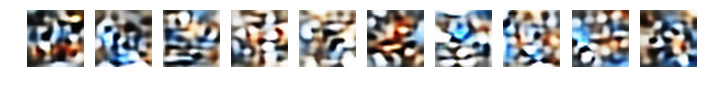

Epoch 41 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1733.26;
train labelled reconstruction loss: 1731.90; train labelled classification loss: 1.62; train accuracy: 0.427
test labelled reconstruction loss: 1735.56; test labelled classification loss: 1.63; test accuracy: 0.423
Epoch 42 of 2000 took 35.30s;
train unlabelled reconstruction loss: 1732.47;
train labelled reconstruction loss: 1731.70; train labelled classification loss: 1.61; train accuracy: 0.433
test labelled reconstruction loss: 1734.57; test labelled classification loss: 1.63; test accuracy: 0.424
Epoch 43 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1731.07;
train labelled reconstruction loss: 1730.95; train labelled classification loss: 1.60; train accuracy: 0.432
test labelled reconstruction loss: 1733.80; test labelled classification loss: 1.63; test accuracy: 0.418
Epoch 44 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1731.17;
train labelled reconstruction loss: 1731.42; tr

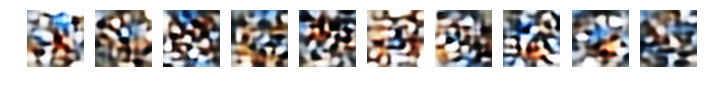

Epoch 51 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1726.94;
train labelled reconstruction loss: 1727.35; train labelled classification loss: 1.55; train accuracy: 0.459
test labelled reconstruction loss: 1729.41; test labelled classification loss: 1.59; test accuracy: 0.437
Epoch 52 of 2000 took 35.37s;
train unlabelled reconstruction loss: 1725.78;
train labelled reconstruction loss: 1725.03; train labelled classification loss: 1.55; train accuracy: 0.456
test labelled reconstruction loss: 1729.77; test labelled classification loss: 1.58; test accuracy: 0.437
Epoch 53 of 2000 took 35.43s;
train unlabelled reconstruction loss: 1725.34;
train labelled reconstruction loss: 1723.74; train labelled classification loss: 1.54; train accuracy: 0.466
test labelled reconstruction loss: 1727.16; test labelled classification loss: 1.58; test accuracy: 0.441
Epoch 54 of 2000 took 35.07s;
train unlabelled reconstruction loss: 1724.59;
train labelled reconstruction loss: 1723.25; tr

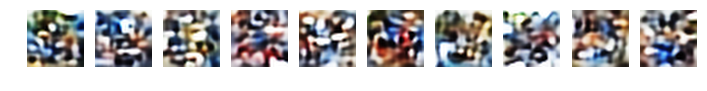

Epoch 61 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1719.73;
train labelled reconstruction loss: 1718.37; train labelled classification loss: 1.51; train accuracy: 0.481
test labelled reconstruction loss: 1722.13; test labelled classification loss: 1.55; test accuracy: 0.450
Epoch 62 of 2000 took 34.94s;
train unlabelled reconstruction loss: 1718.66;
train labelled reconstruction loss: 1718.40; train labelled classification loss: 1.50; train accuracy: 0.474
test labelled reconstruction loss: 1721.31; test labelled classification loss: 1.55; test accuracy: 0.454
Epoch 63 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1718.50;
train labelled reconstruction loss: 1717.54; train labelled classification loss: 1.50; train accuracy: 0.475
test labelled reconstruction loss: 1721.95; test labelled classification loss: 1.54; test accuracy: 0.453
Epoch 64 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1717.86;
train labelled reconstruction loss: 1716.75; tr

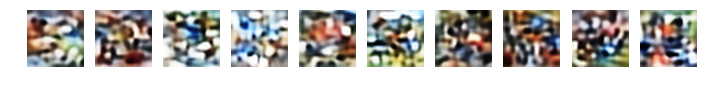

Epoch 71 of 2000 took 36.19s;
train unlabelled reconstruction loss: 1715.01;
train labelled reconstruction loss: 1715.27; train labelled classification loss: 1.47; train accuracy: 0.486
test labelled reconstruction loss: 1718.79; test labelled classification loss: 1.52; test accuracy: 0.465
Epoch 72 of 2000 took 36.16s;
train unlabelled reconstruction loss: 1714.96;
train labelled reconstruction loss: 1714.31; train labelled classification loss: 1.45; train accuracy: 0.498
test labelled reconstruction loss: 1718.33; test labelled classification loss: 1.51; test accuracy: 0.463
Epoch 73 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1714.24;
train labelled reconstruction loss: 1714.39; train labelled classification loss: 1.45; train accuracy: 0.499
test labelled reconstruction loss: 1718.19; test labelled classification loss: 1.51; test accuracy: 0.465
Epoch 74 of 2000 took 35.51s;
train unlabelled reconstruction loss: 1713.96;
train labelled reconstruction loss: 1713.14; tr

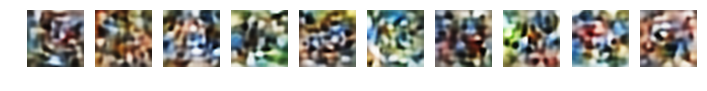

Epoch 81 of 2000 took 36.52s;
train unlabelled reconstruction loss: 1711.84;
train labelled reconstruction loss: 1712.33; train labelled classification loss: 1.42; train accuracy: 0.510
test labelled reconstruction loss: 1717.30; test labelled classification loss: 1.49; test accuracy: 0.474
Epoch 82 of 2000 took 35.35s;
train unlabelled reconstruction loss: 1711.70;
train labelled reconstruction loss: 1711.15; train labelled classification loss: 1.41; train accuracy: 0.513
test labelled reconstruction loss: 1717.28; test labelled classification loss: 1.48; test accuracy: 0.473
Epoch 83 of 2000 took 35.74s;
train unlabelled reconstruction loss: 1711.69;
train labelled reconstruction loss: 1710.86; train labelled classification loss: 1.42; train accuracy: 0.517
test labelled reconstruction loss: 1715.09; test labelled classification loss: 1.48; test accuracy: 0.481
Epoch 84 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1711.22;
train labelled reconstruction loss: 1711.17; tr

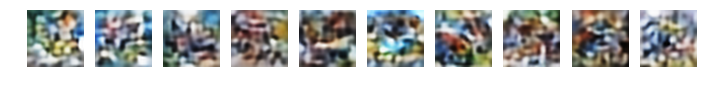

Epoch 91 of 2000 took 35.65s;
train unlabelled reconstruction loss: 1709.73;
train labelled reconstruction loss: 1711.26; train labelled classification loss: 1.38; train accuracy: 0.526
test labelled reconstruction loss: 1716.18; test labelled classification loss: 1.46; test accuracy: 0.477
Epoch 92 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1709.23;
train labelled reconstruction loss: 1708.93; train labelled classification loss: 1.39; train accuracy: 0.516
test labelled reconstruction loss: 1712.51; test labelled classification loss: 1.46; test accuracy: 0.485
Epoch 93 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1709.03;
train labelled reconstruction loss: 1709.38; train labelled classification loss: 1.37; train accuracy: 0.531
test labelled reconstruction loss: 1715.43; test labelled classification loss: 1.46; test accuracy: 0.481
Epoch 94 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1709.00;
train labelled reconstruction loss: 1708.30; tr

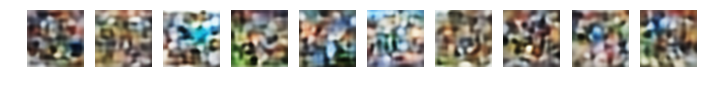

Epoch 101 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1707.20;
train labelled reconstruction loss: 1707.38; train labelled classification loss: 1.35; train accuracy: 0.534
test labelled reconstruction loss: 1711.74; test labelled classification loss: 1.43; test accuracy: 0.486
Epoch 102 of 2000 took 35.00s;
train unlabelled reconstruction loss: 1707.16;
train labelled reconstruction loss: 1706.55; train labelled classification loss: 1.36; train accuracy: 0.528
test labelled reconstruction loss: 1711.34; test labelled classification loss: 1.43; test accuracy: 0.486
Epoch 103 of 2000 took 35.47s;
train unlabelled reconstruction loss: 1706.64;
train labelled reconstruction loss: 1706.21; train labelled classification loss: 1.35; train accuracy: 0.531
test labelled reconstruction loss: 1711.48; test labelled classification loss: 1.44; test accuracy: 0.493
Epoch 104 of 2000 took 35.95s;
train unlabelled reconstruction loss: 1706.81;
train labelled reconstruction loss: 1705.78

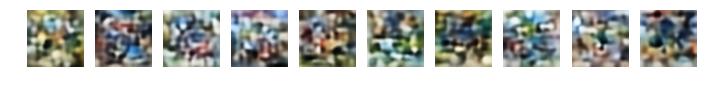

Epoch 111 of 2000 took 35.84s;
train unlabelled reconstruction loss: 1705.45;
train labelled reconstruction loss: 1704.74; train labelled classification loss: 1.33; train accuracy: 0.549
test labelled reconstruction loss: 1711.22; test labelled classification loss: 1.42; test accuracy: 0.499
Epoch 112 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1705.51;
train labelled reconstruction loss: 1705.39; train labelled classification loss: 1.32; train accuracy: 0.551
test labelled reconstruction loss: 1710.20; test labelled classification loss: 1.43; test accuracy: 0.491
Epoch 113 of 2000 took 35.61s;
train unlabelled reconstruction loss: 1705.59;
train labelled reconstruction loss: 1704.91; train labelled classification loss: 1.32; train accuracy: 0.558
test labelled reconstruction loss: 1709.57; test labelled classification loss: 1.41; test accuracy: 0.500
Epoch 114 of 2000 took 35.22s;
train unlabelled reconstruction loss: 1705.31;
train labelled reconstruction loss: 1704.49

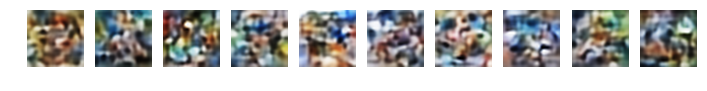

Epoch 121 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1704.15;
train labelled reconstruction loss: 1703.70; train labelled classification loss: 1.29; train accuracy: 0.566
test labelled reconstruction loss: 1709.19; test labelled classification loss: 1.40; test accuracy: 0.499
Epoch 122 of 2000 took 35.32s;
train unlabelled reconstruction loss: 1704.05;
train labelled reconstruction loss: 1703.59; train labelled classification loss: 1.28; train accuracy: 0.561
test labelled reconstruction loss: 1708.49; test labelled classification loss: 1.41; test accuracy: 0.508
Epoch 123 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1703.91;
train labelled reconstruction loss: 1703.02; train labelled classification loss: 1.28; train accuracy: 0.562
test labelled reconstruction loss: 1708.24; test labelled classification loss: 1.39; test accuracy: 0.505
Epoch 124 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1703.95;
train labelled reconstruction loss: 1703.44

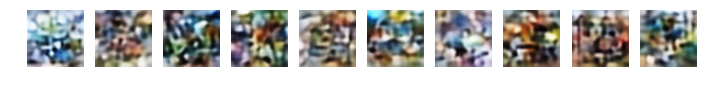

Epoch 131 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1703.07;
train labelled reconstruction loss: 1702.63; train labelled classification loss: 1.26; train accuracy: 0.565
test labelled reconstruction loss: 1707.62; test labelled classification loss: 1.38; test accuracy: 0.512
Epoch 132 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1703.03;
train labelled reconstruction loss: 1702.40; train labelled classification loss: 1.26; train accuracy: 0.571
test labelled reconstruction loss: 1707.61; test labelled classification loss: 1.39; test accuracy: 0.504
Epoch 133 of 2000 took 35.95s;
train unlabelled reconstruction loss: 1703.02;
train labelled reconstruction loss: 1702.60; train labelled classification loss: 1.25; train accuracy: 0.571
test labelled reconstruction loss: 1707.81; test labelled classification loss: 1.38; test accuracy: 0.508
Epoch 134 of 2000 took 34.61s;
train unlabelled reconstruction loss: 1702.99;
train labelled reconstruction loss: 1703.28

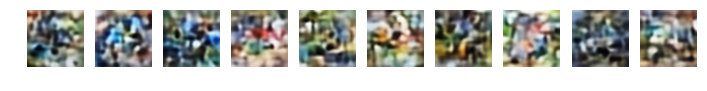

Epoch 141 of 2000 took 35.96s;
train unlabelled reconstruction loss: 1702.39;
train labelled reconstruction loss: 1702.24; train labelled classification loss: 1.23; train accuracy: 0.581
test labelled reconstruction loss: 1707.71; test labelled classification loss: 1.37; test accuracy: 0.515
Epoch 142 of 2000 took 35.11s;
train unlabelled reconstruction loss: 1702.14;
train labelled reconstruction loss: 1702.01; train labelled classification loss: 1.23; train accuracy: 0.591
test labelled reconstruction loss: 1706.94; test labelled classification loss: 1.36; test accuracy: 0.515
Epoch 143 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1701.91;
train labelled reconstruction loss: 1701.81; train labelled classification loss: 1.23; train accuracy: 0.582
test labelled reconstruction loss: 1707.57; test labelled classification loss: 1.37; test accuracy: 0.513
Epoch 144 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1702.03;
train labelled reconstruction loss: 1702.12

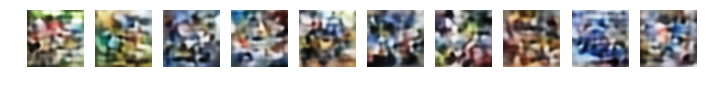

Epoch 151 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1701.34;
train labelled reconstruction loss: 1700.91; train labelled classification loss: 1.20; train accuracy: 0.598
test labelled reconstruction loss: 1706.53; test labelled classification loss: 1.36; test accuracy: 0.516
Epoch 152 of 2000 took 35.94s;
train unlabelled reconstruction loss: 1701.46;
train labelled reconstruction loss: 1700.80; train labelled classification loss: 1.21; train accuracy: 0.590
test labelled reconstruction loss: 1706.19; test labelled classification loss: 1.36; test accuracy: 0.517
Epoch 153 of 2000 took 35.43s;
train unlabelled reconstruction loss: 1701.37;
train labelled reconstruction loss: 1701.06; train labelled classification loss: 1.20; train accuracy: 0.590
test labelled reconstruction loss: 1707.26; test labelled classification loss: 1.36; test accuracy: 0.518
Epoch 154 of 2000 took 35.40s;
train unlabelled reconstruction loss: 1701.33;
train labelled reconstruction loss: 1700.78

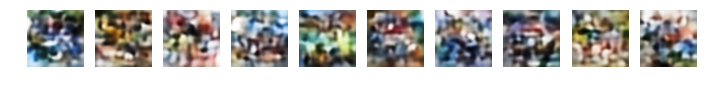

Epoch 161 of 2000 took 35.48s;
train unlabelled reconstruction loss: 1700.85;
train labelled reconstruction loss: 1700.62; train labelled classification loss: 1.19; train accuracy: 0.601
test labelled reconstruction loss: 1706.40; test labelled classification loss: 1.34; test accuracy: 0.529
Epoch 162 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1700.78;
train labelled reconstruction loss: 1700.58; train labelled classification loss: 1.18; train accuracy: 0.616
test labelled reconstruction loss: 1707.25; test labelled classification loss: 1.34; test accuracy: 0.525
Epoch 163 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1700.55;
train labelled reconstruction loss: 1700.17; train labelled classification loss: 1.17; train accuracy: 0.602
test labelled reconstruction loss: 1706.31; test labelled classification loss: 1.33; test accuracy: 0.533
Epoch 164 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1700.62;
train labelled reconstruction loss: 1700.12

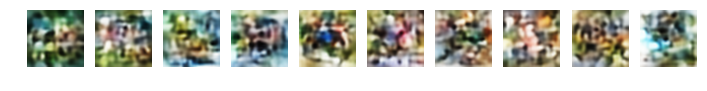

Epoch 171 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1700.25;
train labelled reconstruction loss: 1700.07; train labelled classification loss: 1.16; train accuracy: 0.601
test labelled reconstruction loss: 1706.25; test labelled classification loss: 1.32; test accuracy: 0.533
Epoch 172 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1700.14;
train labelled reconstruction loss: 1699.37; train labelled classification loss: 1.15; train accuracy: 0.619
test labelled reconstruction loss: 1704.90; test labelled classification loss: 1.33; test accuracy: 0.526
Epoch 173 of 2000 took 35.24s;
train unlabelled reconstruction loss: 1699.96;
train labelled reconstruction loss: 1699.83; train labelled classification loss: 1.15; train accuracy: 0.619
test labelled reconstruction loss: 1705.92; test labelled classification loss: 1.32; test accuracy: 0.528
Epoch 174 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1700.16;
train labelled reconstruction loss: 1699.89

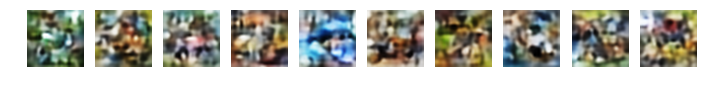

Epoch 181 of 2000 took 35.35s;
train unlabelled reconstruction loss: 1699.70;
train labelled reconstruction loss: 1699.76; train labelled classification loss: 1.12; train accuracy: 0.636
test labelled reconstruction loss: 1706.82; test labelled classification loss: 1.30; test accuracy: 0.535
Epoch 182 of 2000 took 35.98s;
train unlabelled reconstruction loss: 1699.71;
train labelled reconstruction loss: 1698.90; train labelled classification loss: 1.12; train accuracy: 0.635
test labelled reconstruction loss: 1704.90; test labelled classification loss: 1.31; test accuracy: 0.527
Epoch 183 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1699.52;
train labelled reconstruction loss: 1699.21; train labelled classification loss: 1.13; train accuracy: 0.625
test labelled reconstruction loss: 1704.51; test labelled classification loss: 1.32; test accuracy: 0.528
Epoch 184 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1699.59;
train labelled reconstruction loss: 1699.15

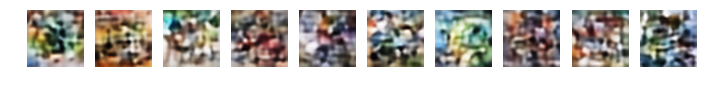

Epoch 191 of 2000 took 35.97s;
train unlabelled reconstruction loss: 1699.31;
train labelled reconstruction loss: 1698.85; train labelled classification loss: 1.11; train accuracy: 0.637
test labelled reconstruction loss: 1704.76; test labelled classification loss: 1.31; test accuracy: 0.535
Epoch 192 of 2000 took 35.61s;
train unlabelled reconstruction loss: 1699.35;
train labelled reconstruction loss: 1699.02; train labelled classification loss: 1.09; train accuracy: 0.633
test labelled reconstruction loss: 1704.86; test labelled classification loss: 1.30; test accuracy: 0.536
Epoch 193 of 2000 took 35.65s;
train unlabelled reconstruction loss: 1699.26;
train labelled reconstruction loss: 1698.76; train labelled classification loss: 1.10; train accuracy: 0.632
test labelled reconstruction loss: 1704.62; test labelled classification loss: 1.31; test accuracy: 0.535
Epoch 194 of 2000 took 35.90s;
train unlabelled reconstruction loss: 1698.94;
train labelled reconstruction loss: 1699.15

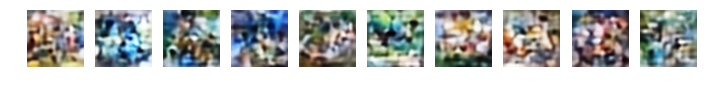

Epoch 201 of 2000 took 35.75s;
train unlabelled reconstruction loss: 1698.83;
train labelled reconstruction loss: 1698.19; train labelled classification loss: 1.09; train accuracy: 0.634
test labelled reconstruction loss: 1704.87; test labelled classification loss: 1.29; test accuracy: 0.542
Epoch 202 of 2000 took 35.99s;
train unlabelled reconstruction loss: 1698.74;
train labelled reconstruction loss: 1698.30; train labelled classification loss: 1.08; train accuracy: 0.639
test labelled reconstruction loss: 1704.60; test labelled classification loss: 1.30; test accuracy: 0.541
Epoch 203 of 2000 took 35.52s;
train unlabelled reconstruction loss: 1698.55;
train labelled reconstruction loss: 1698.10; train labelled classification loss: 1.08; train accuracy: 0.643
test labelled reconstruction loss: 1705.87; test labelled classification loss: 1.30; test accuracy: 0.536
Epoch 204 of 2000 took 35.33s;
train unlabelled reconstruction loss: 1698.63;
train labelled reconstruction loss: 1698.37

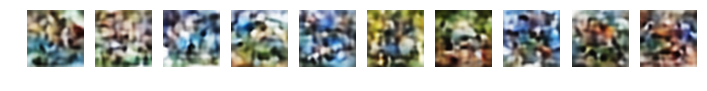

Epoch 211 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1698.49;
train labelled reconstruction loss: 1698.43; train labelled classification loss: 1.06; train accuracy: 0.657
test labelled reconstruction loss: 1705.42; test labelled classification loss: 1.28; test accuracy: 0.547
Epoch 212 of 2000 took 35.28s;
train unlabelled reconstruction loss: 1698.41;
train labelled reconstruction loss: 1698.31; train labelled classification loss: 1.06; train accuracy: 0.649
test labelled reconstruction loss: 1704.48; test labelled classification loss: 1.28; test accuracy: 0.551
Epoch 213 of 2000 took 35.23s;
train unlabelled reconstruction loss: 1698.41;
train labelled reconstruction loss: 1698.18; train labelled classification loss: 1.05; train accuracy: 0.658
test labelled reconstruction loss: 1704.25; test labelled classification loss: 1.29; test accuracy: 0.545
Epoch 214 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1698.47;
train labelled reconstruction loss: 1698.04

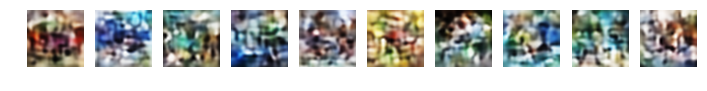

Epoch 221 of 2000 took 35.48s;
train unlabelled reconstruction loss: 1698.30;
train labelled reconstruction loss: 1697.85; train labelled classification loss: 1.04; train accuracy: 0.664
test labelled reconstruction loss: 1704.02; test labelled classification loss: 1.27; test accuracy: 0.551
Epoch 222 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1698.30;
train labelled reconstruction loss: 1697.61; train labelled classification loss: 1.04; train accuracy: 0.665
test labelled reconstruction loss: 1703.58; test labelled classification loss: 1.28; test accuracy: 0.547
Epoch 223 of 2000 took 35.58s;
train unlabelled reconstruction loss: 1698.07;
train labelled reconstruction loss: 1697.55; train labelled classification loss: 1.03; train accuracy: 0.660
test labelled reconstruction loss: 1703.84; test labelled classification loss: 1.27; test accuracy: 0.545
Epoch 224 of 2000 took 35.41s;
train unlabelled reconstruction loss: 1697.98;
train labelled reconstruction loss: 1697.42

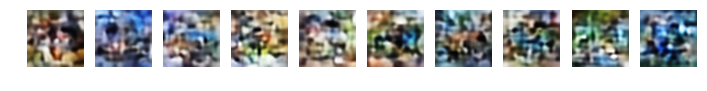

Epoch 231 of 2000 took 35.44s;
train unlabelled reconstruction loss: 1697.95;
train labelled reconstruction loss: 1697.99; train labelled classification loss: 1.00; train accuracy: 0.671
test labelled reconstruction loss: 1704.27; test labelled classification loss: 1.27; test accuracy: 0.556
Epoch 232 of 2000 took 35.21s;
train unlabelled reconstruction loss: 1697.94;
train labelled reconstruction loss: 1697.81; train labelled classification loss: 1.00; train accuracy: 0.669
test labelled reconstruction loss: 1704.31; test labelled classification loss: 1.26; test accuracy: 0.555
Epoch 233 of 2000 took 35.39s;
train unlabelled reconstruction loss: 1697.65;
train labelled reconstruction loss: 1698.14; train labelled classification loss: 1.00; train accuracy: 0.674
test labelled reconstruction loss: 1705.24; test labelled classification loss: 1.26; test accuracy: 0.559
Epoch 234 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1697.71;
train labelled reconstruction loss: 1697.35

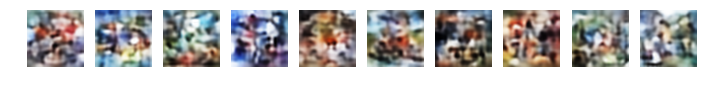

Epoch 241 of 2000 took 35.30s;
train unlabelled reconstruction loss: 1697.50;
train labelled reconstruction loss: 1697.43; train labelled classification loss: 0.98; train accuracy: 0.678
test labelled reconstruction loss: 1704.13; test labelled classification loss: 1.25; test accuracy: 0.556
Epoch 242 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1697.55;
train labelled reconstruction loss: 1697.14; train labelled classification loss: 0.99; train accuracy: 0.676
test labelled reconstruction loss: 1703.13; test labelled classification loss: 1.24; test accuracy: 0.562
Epoch 243 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1697.44;
train labelled reconstruction loss: 1697.36; train labelled classification loss: 0.99; train accuracy: 0.672
test labelled reconstruction loss: 1703.55; test labelled classification loss: 1.26; test accuracy: 0.560
Epoch 244 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1697.39;
train labelled reconstruction loss: 1697.26

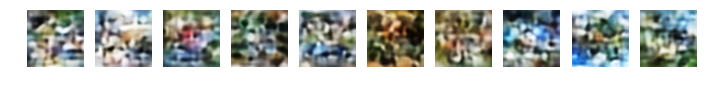

Epoch 251 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1697.29;
train labelled reconstruction loss: 1696.91; train labelled classification loss: 0.96; train accuracy: 0.697
test labelled reconstruction loss: 1703.30; test labelled classification loss: 1.26; test accuracy: 0.554
Epoch 252 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1697.32;
train labelled reconstruction loss: 1696.98; train labelled classification loss: 0.95; train accuracy: 0.697
test labelled reconstruction loss: 1703.96; test labelled classification loss: 1.24; test accuracy: 0.564
Epoch 253 of 2000 took 35.20s;
train unlabelled reconstruction loss: 1697.41;
train labelled reconstruction loss: 1696.85; train labelled classification loss: 0.94; train accuracy: 0.707
test labelled reconstruction loss: 1703.07; test labelled classification loss: 1.26; test accuracy: 0.551
Epoch 254 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1697.27;
train labelled reconstruction loss: 1696.63

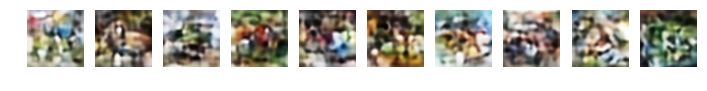

Epoch 261 of 2000 took 35.31s;
train unlabelled reconstruction loss: 1697.07;
train labelled reconstruction loss: 1697.00; train labelled classification loss: 0.93; train accuracy: 0.700
test labelled reconstruction loss: 1704.27; test labelled classification loss: 1.25; test accuracy: 0.564
Epoch 262 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1696.99;
train labelled reconstruction loss: 1696.77; train labelled classification loss: 0.93; train accuracy: 0.703
test labelled reconstruction loss: 1703.74; test labelled classification loss: 1.25; test accuracy: 0.560
Epoch 263 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1697.22;
train labelled reconstruction loss: 1696.75; train labelled classification loss: 0.94; train accuracy: 0.691
test labelled reconstruction loss: 1703.13; test labelled classification loss: 1.24; test accuracy: 0.561
Epoch 264 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1697.00;
train labelled reconstruction loss: 1696.78

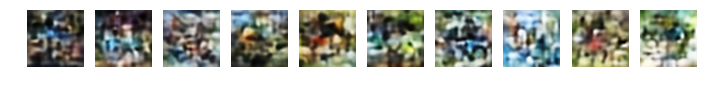

Epoch 271 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1696.77;
train labelled reconstruction loss: 1696.61; train labelled classification loss: 0.92; train accuracy: 0.706
test labelled reconstruction loss: 1703.14; test labelled classification loss: 1.23; test accuracy: 0.571
Epoch 272 of 2000 took 35.51s;
train unlabelled reconstruction loss: 1696.90;
train labelled reconstruction loss: 1696.61; train labelled classification loss: 0.91; train accuracy: 0.705
test labelled reconstruction loss: 1703.12; test labelled classification loss: 1.25; test accuracy: 0.561
Epoch 273 of 2000 took 35.50s;
train unlabelled reconstruction loss: 1696.81;
train labelled reconstruction loss: 1696.30; train labelled classification loss: 0.91; train accuracy: 0.709
test labelled reconstruction loss: 1703.95; test labelled classification loss: 1.24; test accuracy: 0.563
Epoch 274 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1696.99;
train labelled reconstruction loss: 1696.70

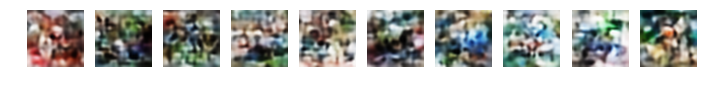

Epoch 281 of 2000 took 35.59s;
train unlabelled reconstruction loss: 1696.81;
train labelled reconstruction loss: 1696.34; train labelled classification loss: 0.89; train accuracy: 0.717
test labelled reconstruction loss: 1703.23; test labelled classification loss: 1.23; test accuracy: 0.564
Epoch 282 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1696.70;
train labelled reconstruction loss: 1696.32; train labelled classification loss: 0.88; train accuracy: 0.726
test labelled reconstruction loss: 1702.95; test labelled classification loss: 1.23; test accuracy: 0.566
Epoch 283 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1696.72;
train labelled reconstruction loss: 1696.51; train labelled classification loss: 0.88; train accuracy: 0.715
test labelled reconstruction loss: 1703.72; test labelled classification loss: 1.24; test accuracy: 0.569
Epoch 284 of 2000 took 35.09s;
train unlabelled reconstruction loss: 1696.68;
train labelled reconstruction loss: 1696.80

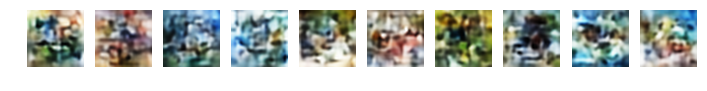

Epoch 291 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1696.69;
train labelled reconstruction loss: 1696.42; train labelled classification loss: 0.86; train accuracy: 0.730
test labelled reconstruction loss: 1703.62; test labelled classification loss: 1.22; test accuracy: 0.565
Epoch 292 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1696.56;
train labelled reconstruction loss: 1696.17; train labelled classification loss: 0.88; train accuracy: 0.717
test labelled reconstruction loss: 1703.08; test labelled classification loss: 1.22; test accuracy: 0.574
Epoch 293 of 2000 took 35.32s;
train unlabelled reconstruction loss: 1696.67;
train labelled reconstruction loss: 1696.60; train labelled classification loss: 0.86; train accuracy: 0.728
test labelled reconstruction loss: 1703.55; test labelled classification loss: 1.22; test accuracy: 0.569
Epoch 294 of 2000 took 35.96s;
train unlabelled reconstruction loss: 1696.69;
train labelled reconstruction loss: 1696.16

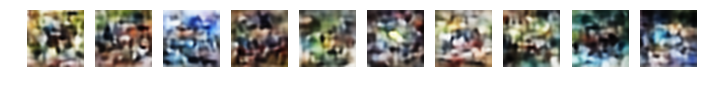

Epoch 301 of 2000 took 35.36s;
train unlabelled reconstruction loss: 1696.49;
train labelled reconstruction loss: 1696.74; train labelled classification loss: 0.86; train accuracy: 0.724
test labelled reconstruction loss: 1703.96; test labelled classification loss: 1.21; test accuracy: 0.570
Epoch 302 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1696.70;
train labelled reconstruction loss: 1696.43; train labelled classification loss: 0.85; train accuracy: 0.731
test labelled reconstruction loss: 1704.25; test labelled classification loss: 1.21; test accuracy: 0.578
Epoch 303 of 2000 took 35.69s;
train unlabelled reconstruction loss: 1696.57;
train labelled reconstruction loss: 1696.49; train labelled classification loss: 0.85; train accuracy: 0.739
test labelled reconstruction loss: 1702.94; test labelled classification loss: 1.22; test accuracy: 0.573
Epoch 304 of 2000 took 35.52s;
train unlabelled reconstruction loss: 1696.52;
train labelled reconstruction loss: 1696.37

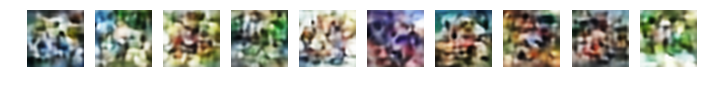

Epoch 311 of 2000 took 35.45s;
train unlabelled reconstruction loss: 1696.58;
train labelled reconstruction loss: 1695.84; train labelled classification loss: 0.84; train accuracy: 0.726
test labelled reconstruction loss: 1703.70; test labelled classification loss: 1.22; test accuracy: 0.570
Epoch 312 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1696.62;
train labelled reconstruction loss: 1696.08; train labelled classification loss: 0.82; train accuracy: 0.738
test labelled reconstruction loss: 1703.66; test labelled classification loss: 1.21; test accuracy: 0.570
Epoch 313 of 2000 took 35.38s;
train unlabelled reconstruction loss: 1696.41;
train labelled reconstruction loss: 1695.88; train labelled classification loss: 0.83; train accuracy: 0.731
test labelled reconstruction loss: 1703.09; test labelled classification loss: 1.22; test accuracy: 0.575
Epoch 314 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1696.53;
train labelled reconstruction loss: 1695.96

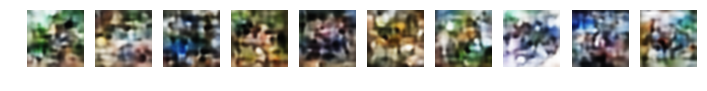

Epoch 321 of 2000 took 35.34s;
train unlabelled reconstruction loss: 1696.44;
train labelled reconstruction loss: 1695.87; train labelled classification loss: 0.80; train accuracy: 0.745
test labelled reconstruction loss: 1703.22; test labelled classification loss: 1.19; test accuracy: 0.580
Epoch 322 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1696.50;
train labelled reconstruction loss: 1696.21; train labelled classification loss: 0.81; train accuracy: 0.750
test labelled reconstruction loss: 1703.30; test labelled classification loss: 1.23; test accuracy: 0.570
Epoch 323 of 2000 took 35.74s;
train unlabelled reconstruction loss: 1696.30;
train labelled reconstruction loss: 1695.99; train labelled classification loss: 0.81; train accuracy: 0.747
test labelled reconstruction loss: 1704.42; test labelled classification loss: 1.21; test accuracy: 0.571
Epoch 324 of 2000 took 35.66s;
train unlabelled reconstruction loss: 1696.37;
train labelled reconstruction loss: 1696.09

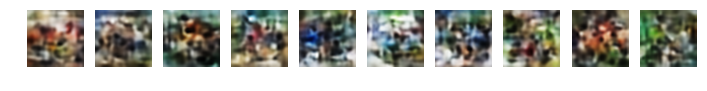

Epoch 331 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1696.46;
train labelled reconstruction loss: 1696.32; train labelled classification loss: 0.79; train accuracy: 0.753
test labelled reconstruction loss: 1703.67; test labelled classification loss: 1.20; test accuracy: 0.579
Epoch 332 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1696.31;
train labelled reconstruction loss: 1696.52; train labelled classification loss: 0.78; train accuracy: 0.748
test labelled reconstruction loss: 1703.30; test labelled classification loss: 1.20; test accuracy: 0.580
Epoch 333 of 2000 took 34.94s;
train unlabelled reconstruction loss: 1696.29;
train labelled reconstruction loss: 1696.55; train labelled classification loss: 0.78; train accuracy: 0.756
test labelled reconstruction loss: 1704.16; test labelled classification loss: 1.19; test accuracy: 0.579
Epoch 334 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1696.21;
train labelled reconstruction loss: 1695.80

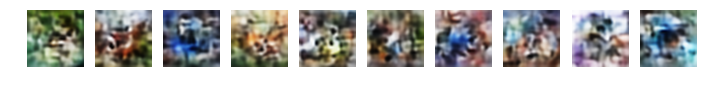

Epoch 341 of 2000 took 35.05s;
train unlabelled reconstruction loss: 1696.19;
train labelled reconstruction loss: 1695.88; train labelled classification loss: 0.75; train accuracy: 0.764
test labelled reconstruction loss: 1703.19; test labelled classification loss: 1.19; test accuracy: 0.579
Epoch 342 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1696.20;
train labelled reconstruction loss: 1695.84; train labelled classification loss: 0.75; train accuracy: 0.772
test labelled reconstruction loss: 1703.74; test labelled classification loss: 1.18; test accuracy: 0.581
Epoch 343 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1696.18;
train labelled reconstruction loss: 1696.10; train labelled classification loss: 0.76; train accuracy: 0.773
test labelled reconstruction loss: 1703.87; test labelled classification loss: 1.20; test accuracy: 0.577
Epoch 344 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1696.22;
train labelled reconstruction loss: 1696.05

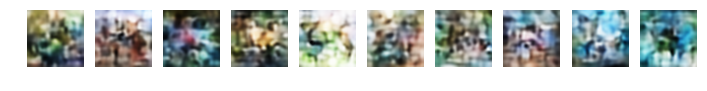

Epoch 351 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1696.32;
train labelled reconstruction loss: 1695.94; train labelled classification loss: 0.74; train accuracy: 0.767
test labelled reconstruction loss: 1703.05; test labelled classification loss: 1.20; test accuracy: 0.581
Epoch 352 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1696.14;
train labelled reconstruction loss: 1695.51; train labelled classification loss: 0.73; train accuracy: 0.771
test labelled reconstruction loss: 1703.38; test labelled classification loss: 1.21; test accuracy: 0.572
Epoch 353 of 2000 took 34.96s;
train unlabelled reconstruction loss: 1696.32;
train labelled reconstruction loss: 1695.96; train labelled classification loss: 0.74; train accuracy: 0.774
test labelled reconstruction loss: 1703.61; test labelled classification loss: 1.19; test accuracy: 0.581
Epoch 354 of 2000 took 35.03s;
train unlabelled reconstruction loss: 1696.31;
train labelled reconstruction loss: 1695.83

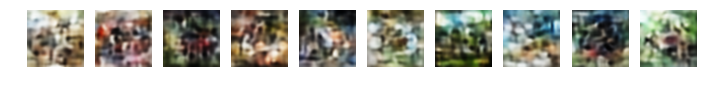

Epoch 361 of 2000 took 35.61s;
train unlabelled reconstruction loss: 1696.19;
train labelled reconstruction loss: 1696.03; train labelled classification loss: 0.71; train accuracy: 0.780
test labelled reconstruction loss: 1703.14; test labelled classification loss: 1.21; test accuracy: 0.578
Epoch 362 of 2000 took 35.40s;
train unlabelled reconstruction loss: 1696.18;
train labelled reconstruction loss: 1696.57; train labelled classification loss: 0.72; train accuracy: 0.785
test labelled reconstruction loss: 1704.16; test labelled classification loss: 1.20; test accuracy: 0.585
Epoch 363 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1696.25;
train labelled reconstruction loss: 1695.99; train labelled classification loss: 0.71; train accuracy: 0.781
test labelled reconstruction loss: 1703.54; test labelled classification loss: 1.19; test accuracy: 0.578
Epoch 364 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1696.19;
train labelled reconstruction loss: 1695.57

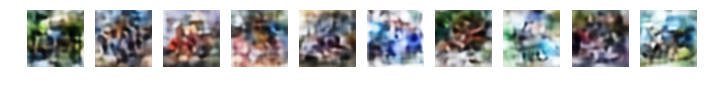

Epoch 371 of 2000 took 35.42s;
train unlabelled reconstruction loss: 1696.00;
train labelled reconstruction loss: 1695.82; train labelled classification loss: 0.68; train accuracy: 0.794
test labelled reconstruction loss: 1703.65; test labelled classification loss: 1.18; test accuracy: 0.591
Epoch 372 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1696.33;
train labelled reconstruction loss: 1695.85; train labelled classification loss: 0.70; train accuracy: 0.780
test labelled reconstruction loss: 1703.48; test labelled classification loss: 1.20; test accuracy: 0.584
Epoch 373 of 2000 took 35.66s;
train unlabelled reconstruction loss: 1696.14;
train labelled reconstruction loss: 1696.03; train labelled classification loss: 0.69; train accuracy: 0.788
test labelled reconstruction loss: 1703.94; test labelled classification loss: 1.18; test accuracy: 0.586
Epoch 374 of 2000 took 35.69s;
train unlabelled reconstruction loss: 1696.14;
train labelled reconstruction loss: 1696.08

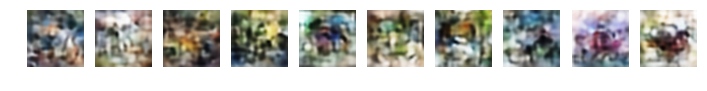

Epoch 381 of 2000 took 35.41s;
train unlabelled reconstruction loss: 1696.12;
train labelled reconstruction loss: 1695.83; train labelled classification loss: 0.68; train accuracy: 0.800
test labelled reconstruction loss: 1703.89; test labelled classification loss: 1.19; test accuracy: 0.583
Epoch 382 of 2000 took 35.28s;
train unlabelled reconstruction loss: 1696.15;
train labelled reconstruction loss: 1695.75; train labelled classification loss: 0.67; train accuracy: 0.798
test labelled reconstruction loss: 1704.27; test labelled classification loss: 1.18; test accuracy: 0.586
Epoch 383 of 2000 took 35.71s;
train unlabelled reconstruction loss: 1696.23;
train labelled reconstruction loss: 1695.86; train labelled classification loss: 0.67; train accuracy: 0.795
test labelled reconstruction loss: 1704.51; test labelled classification loss: 1.18; test accuracy: 0.586
Epoch 384 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1696.18;
train labelled reconstruction loss: 1695.79

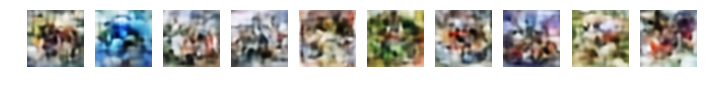

Epoch 391 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1696.06;
train labelled reconstruction loss: 1695.70; train labelled classification loss: 0.66; train accuracy: 0.798
test labelled reconstruction loss: 1704.43; test labelled classification loss: 1.20; test accuracy: 0.587
Epoch 392 of 2000 took 36.86s;
train unlabelled reconstruction loss: 1696.16;
train labelled reconstruction loss: 1696.00; train labelled classification loss: 0.66; train accuracy: 0.799
test labelled reconstruction loss: 1703.99; test labelled classification loss: 1.19; test accuracy: 0.584
Epoch 393 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1696.03;
train labelled reconstruction loss: 1695.83; train labelled classification loss: 0.66; train accuracy: 0.801
test labelled reconstruction loss: 1703.79; test labelled classification loss: 1.19; test accuracy: 0.581
Epoch 394 of 2000 took 36.24s;
train unlabelled reconstruction loss: 1695.92;
train labelled reconstruction loss: 1695.41

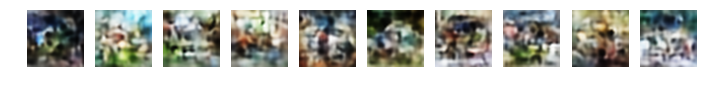

Epoch 401 of 2000 took 35.37s;
train unlabelled reconstruction loss: 1695.97;
train labelled reconstruction loss: 1695.72; train labelled classification loss: 0.64; train accuracy: 0.805
test labelled reconstruction loss: 1703.42; test labelled classification loss: 1.17; test accuracy: 0.594
Epoch 402 of 2000 took 35.52s;
train unlabelled reconstruction loss: 1695.99;
train labelled reconstruction loss: 1695.71; train labelled classification loss: 0.63; train accuracy: 0.812
test labelled reconstruction loss: 1703.39; test labelled classification loss: 1.19; test accuracy: 0.584
Epoch 403 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1695.93;
train labelled reconstruction loss: 1695.56; train labelled classification loss: 0.63; train accuracy: 0.813
test labelled reconstruction loss: 1703.77; test labelled classification loss: 1.18; test accuracy: 0.590
Epoch 404 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1696.00;
train labelled reconstruction loss: 1695.57

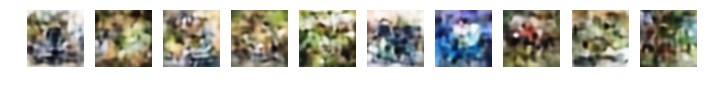

Epoch 411 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1695.98;
train labelled reconstruction loss: 1696.31; train labelled classification loss: 0.62; train accuracy: 0.811
test labelled reconstruction loss: 1703.94; test labelled classification loss: 1.18; test accuracy: 0.589
Epoch 412 of 2000 took 35.50s;
train unlabelled reconstruction loss: 1696.03;
train labelled reconstruction loss: 1695.66; train labelled classification loss: 0.63; train accuracy: 0.818
test labelled reconstruction loss: 1703.46; test labelled classification loss: 1.18; test accuracy: 0.591
Epoch 413 of 2000 took 35.66s;
train unlabelled reconstruction loss: 1695.84;
train labelled reconstruction loss: 1695.48; train labelled classification loss: 0.61; train accuracy: 0.819
test labelled reconstruction loss: 1703.46; test labelled classification loss: 1.18; test accuracy: 0.589
Epoch 414 of 2000 took 35.27s;
train unlabelled reconstruction loss: 1695.86;
train labelled reconstruction loss: 1695.68

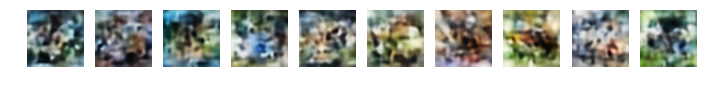

Epoch 421 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1695.85;
train labelled reconstruction loss: 1695.42; train labelled classification loss: 0.60; train accuracy: 0.820
test labelled reconstruction loss: 1703.51; test labelled classification loss: 1.18; test accuracy: 0.585
Epoch 422 of 2000 took 34.79s;
train unlabelled reconstruction loss: 1695.72;
train labelled reconstruction loss: 1696.06; train labelled classification loss: 0.59; train accuracy: 0.827
test labelled reconstruction loss: 1703.95; test labelled classification loss: 1.20; test accuracy: 0.585
Epoch 423 of 2000 took 35.97s;
train unlabelled reconstruction loss: 1695.72;
train labelled reconstruction loss: 1695.44; train labelled classification loss: 0.59; train accuracy: 0.828
test labelled reconstruction loss: 1703.99; test labelled classification loss: 1.19; test accuracy: 0.584
Epoch 424 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1695.76;
train labelled reconstruction loss: 1695.33

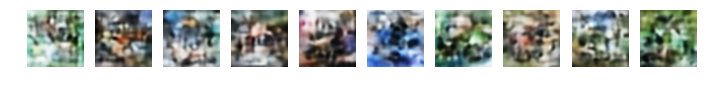

Epoch 431 of 2000 took 34.95s;
train unlabelled reconstruction loss: 1695.74;
train labelled reconstruction loss: 1695.53; train labelled classification loss: 0.57; train accuracy: 0.836
test labelled reconstruction loss: 1703.53; test labelled classification loss: 1.19; test accuracy: 0.581
Epoch 432 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1695.69;
train labelled reconstruction loss: 1695.67; train labelled classification loss: 0.57; train accuracy: 0.829
test labelled reconstruction loss: 1704.17; test labelled classification loss: 1.18; test accuracy: 0.592
Epoch 433 of 2000 took 35.64s;
train unlabelled reconstruction loss: 1695.67;
train labelled reconstruction loss: 1695.50; train labelled classification loss: 0.57; train accuracy: 0.831
test labelled reconstruction loss: 1703.44; test labelled classification loss: 1.19; test accuracy: 0.586
Epoch 434 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1695.66;
train labelled reconstruction loss: 1695.17

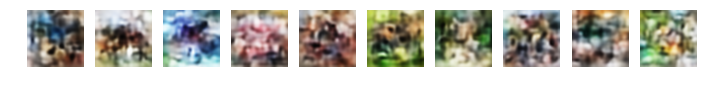

Epoch 441 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1695.70;
train labelled reconstruction loss: 1695.59; train labelled classification loss: 0.56; train accuracy: 0.836
test labelled reconstruction loss: 1703.46; test labelled classification loss: 1.18; test accuracy: 0.588
Epoch 442 of 2000 took 35.94s;
train unlabelled reconstruction loss: 1695.66;
train labelled reconstruction loss: 1695.02; train labelled classification loss: 0.57; train accuracy: 0.829
test labelled reconstruction loss: 1703.45; test labelled classification loss: 1.19; test accuracy: 0.586
Epoch 443 of 2000 took 35.37s;
train unlabelled reconstruction loss: 1695.65;
train labelled reconstruction loss: 1695.39; train labelled classification loss: 0.56; train accuracy: 0.835
test labelled reconstruction loss: 1703.78; test labelled classification loss: 1.18; test accuracy: 0.588
Epoch 444 of 2000 took 35.58s;
train unlabelled reconstruction loss: 1695.61;
train labelled reconstruction loss: 1695.17

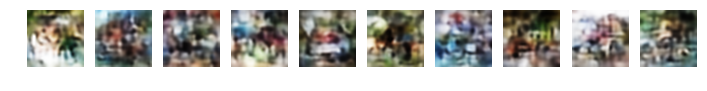

Epoch 451 of 2000 took 34.85s;
train unlabelled reconstruction loss: 1695.51;
train labelled reconstruction loss: 1695.24; train labelled classification loss: 0.54; train accuracy: 0.846
test labelled reconstruction loss: 1704.04; test labelled classification loss: 1.17; test accuracy: 0.592
Epoch 452 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1695.54;
train labelled reconstruction loss: 1695.24; train labelled classification loss: 0.53; train accuracy: 0.847
test labelled reconstruction loss: 1703.72; test labelled classification loss: 1.17; test accuracy: 0.593
Epoch 453 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1695.55;
train labelled reconstruction loss: 1695.74; train labelled classification loss: 0.53; train accuracy: 0.841
test labelled reconstruction loss: 1703.51; test labelled classification loss: 1.18; test accuracy: 0.593
Epoch 454 of 2000 took 35.31s;
train unlabelled reconstruction loss: 1695.66;
train labelled reconstruction loss: 1695.67

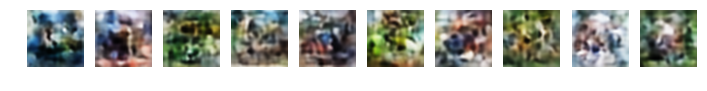

Epoch 461 of 2000 took 35.71s;
train unlabelled reconstruction loss: 1695.64;
train labelled reconstruction loss: 1695.09; train labelled classification loss: 0.51; train accuracy: 0.856
test labelled reconstruction loss: 1703.19; test labelled classification loss: 1.19; test accuracy: 0.591
Epoch 462 of 2000 took 35.51s;
train unlabelled reconstruction loss: 1695.78;
train labelled reconstruction loss: 1695.29; train labelled classification loss: 0.52; train accuracy: 0.854
test labelled reconstruction loss: 1703.22; test labelled classification loss: 1.18; test accuracy: 0.599
Epoch 463 of 2000 took 35.56s;
train unlabelled reconstruction loss: 1695.47;
train labelled reconstruction loss: 1695.58; train labelled classification loss: 0.53; train accuracy: 0.848
test labelled reconstruction loss: 1703.79; test labelled classification loss: 1.19; test accuracy: 0.589
Epoch 464 of 2000 took 35.63s;
train unlabelled reconstruction loss: 1695.49;
train labelled reconstruction loss: 1695.17

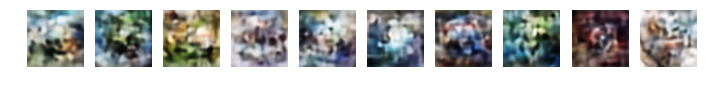

Epoch 471 of 2000 took 35.25s;
train unlabelled reconstruction loss: 1695.47;
train labelled reconstruction loss: 1695.41; train labelled classification loss: 0.51; train accuracy: 0.862
test labelled reconstruction loss: 1703.57; test labelled classification loss: 1.19; test accuracy: 0.591
Epoch 472 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1695.46;
train labelled reconstruction loss: 1695.34; train labelled classification loss: 0.49; train accuracy: 0.866
test labelled reconstruction loss: 1703.57; test labelled classification loss: 1.18; test accuracy: 0.594
Epoch 473 of 2000 took 35.59s;
train unlabelled reconstruction loss: 1695.42;
train labelled reconstruction loss: 1694.99; train labelled classification loss: 0.50; train accuracy: 0.856
test labelled reconstruction loss: 1703.04; test labelled classification loss: 1.19; test accuracy: 0.592
Epoch 474 of 2000 took 35.94s;
train unlabelled reconstruction loss: 1695.38;
train labelled reconstruction loss: 1696.00

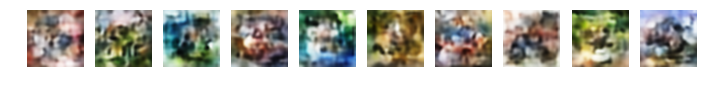

Epoch 481 of 2000 took 35.63s;
train unlabelled reconstruction loss: 1696.06;
train labelled reconstruction loss: 1695.47; train labelled classification loss: 0.48; train accuracy: 0.865
test labelled reconstruction loss: 1704.60; test labelled classification loss: 1.18; test accuracy: 0.595
Epoch 482 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1695.54;
train labelled reconstruction loss: 1695.51; train labelled classification loss: 0.49; train accuracy: 0.855
test labelled reconstruction loss: 1703.85; test labelled classification loss: 1.17; test accuracy: 0.596
Epoch 483 of 2000 took 35.09s;
train unlabelled reconstruction loss: 1695.38;
train labelled reconstruction loss: 1695.11; train labelled classification loss: 0.48; train accuracy: 0.863
test labelled reconstruction loss: 1703.42; test labelled classification loss: 1.19; test accuracy: 0.593
Epoch 484 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1695.57;
train labelled reconstruction loss: 1694.92

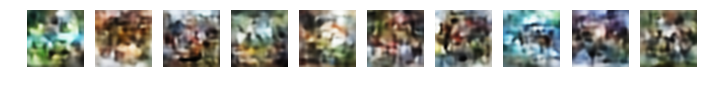

Epoch 491 of 2000 took 35.29s;
train unlabelled reconstruction loss: 1695.27;
train labelled reconstruction loss: 1694.87; train labelled classification loss: 0.48; train accuracy: 0.869
test labelled reconstruction loss: 1703.41; test labelled classification loss: 1.19; test accuracy: 0.593
Epoch 492 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1695.40;
train labelled reconstruction loss: 1694.90; train labelled classification loss: 0.46; train accuracy: 0.870
test labelled reconstruction loss: 1703.23; test labelled classification loss: 1.18; test accuracy: 0.593
Epoch 493 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1695.32;
train labelled reconstruction loss: 1694.76; train labelled classification loss: 0.46; train accuracy: 0.868
test labelled reconstruction loss: 1703.25; test labelled classification loss: 1.18; test accuracy: 0.593
Epoch 494 of 2000 took 35.45s;
train unlabelled reconstruction loss: 1695.35;
train labelled reconstruction loss: 1694.99

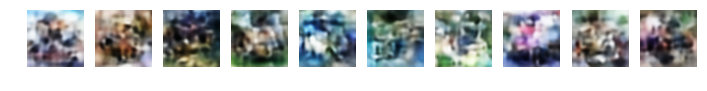

Epoch 501 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1695.42;
train labelled reconstruction loss: 1694.85; train labelled classification loss: 0.45; train accuracy: 0.871
test labelled reconstruction loss: 1704.44; test labelled classification loss: 1.21; test accuracy: 0.584
Epoch 502 of 2000 took 36.12s;
train unlabelled reconstruction loss: 1695.29;
train labelled reconstruction loss: 1694.92; train labelled classification loss: 0.43; train accuracy: 0.882
test labelled reconstruction loss: 1703.43; test labelled classification loss: 1.17; test accuracy: 0.600
Epoch 503 of 2000 took 35.44s;
train unlabelled reconstruction loss: 1695.25;
train labelled reconstruction loss: 1694.74; train labelled classification loss: 0.45; train accuracy: 0.870
test labelled reconstruction loss: 1703.33; test labelled classification loss: 1.18; test accuracy: 0.599
Epoch 504 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1695.35;
train labelled reconstruction loss: 1694.91

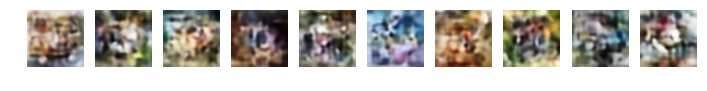

Epoch 511 of 2000 took 35.41s;
train unlabelled reconstruction loss: 1695.14;
train labelled reconstruction loss: 1694.88; train labelled classification loss: 0.43; train accuracy: 0.886
test labelled reconstruction loss: 1703.07; test labelled classification loss: 1.18; test accuracy: 0.596
Epoch 512 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1695.32;
train labelled reconstruction loss: 1694.73; train labelled classification loss: 0.44; train accuracy: 0.880
test labelled reconstruction loss: 1703.95; test labelled classification loss: 1.20; test accuracy: 0.594
Epoch 513 of 2000 took 35.98s;
train unlabelled reconstruction loss: 1695.20;
train labelled reconstruction loss: 1694.95; train labelled classification loss: 0.44; train accuracy: 0.876
test labelled reconstruction loss: 1703.29; test labelled classification loss: 1.18; test accuracy: 0.598
Epoch 514 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1695.39;
train labelled reconstruction loss: 1695.16

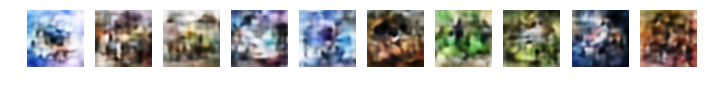

Epoch 521 of 2000 took 35.44s;
train unlabelled reconstruction loss: 1695.36;
train labelled reconstruction loss: 1694.93; train labelled classification loss: 0.42; train accuracy: 0.883
test labelled reconstruction loss: 1703.88; test labelled classification loss: 1.19; test accuracy: 0.596
Epoch 522 of 2000 took 35.60s;
train unlabelled reconstruction loss: 1695.22;
train labelled reconstruction loss: 1695.30; train labelled classification loss: 0.42; train accuracy: 0.885
test labelled reconstruction loss: 1703.29; test labelled classification loss: 1.17; test accuracy: 0.598
Epoch 523 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1695.30;
train labelled reconstruction loss: 1695.04; train labelled classification loss: 0.42; train accuracy: 0.892
test labelled reconstruction loss: 1703.69; test labelled classification loss: 1.18; test accuracy: 0.601
Epoch 524 of 2000 took 35.97s;
train unlabelled reconstruction loss: 1695.25;
train labelled reconstruction loss: 1694.77

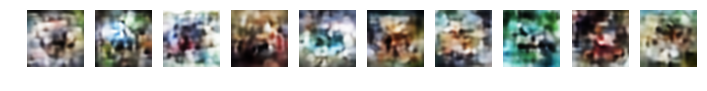

Epoch 531 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1695.19;
train labelled reconstruction loss: 1694.65; train labelled classification loss: 0.39; train accuracy: 0.897
test labelled reconstruction loss: 1703.64; test labelled classification loss: 1.19; test accuracy: 0.594
Epoch 532 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1695.20;
train labelled reconstruction loss: 1694.63; train labelled classification loss: 0.39; train accuracy: 0.901
test labelled reconstruction loss: 1704.04; test labelled classification loss: 1.20; test accuracy: 0.597
Epoch 533 of 2000 took 35.58s;
train unlabelled reconstruction loss: 1695.37;
train labelled reconstruction loss: 1694.88; train labelled classification loss: 0.40; train accuracy: 0.889
test labelled reconstruction loss: 1703.83; test labelled classification loss: 1.19; test accuracy: 0.598
Epoch 534 of 2000 took 35.11s;
train unlabelled reconstruction loss: 1695.19;
train labelled reconstruction loss: 1695.10

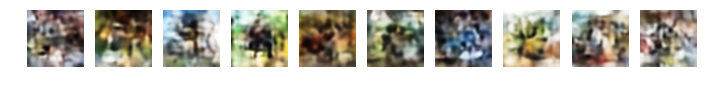

Epoch 541 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1695.16;
train labelled reconstruction loss: 1694.57; train labelled classification loss: 0.39; train accuracy: 0.894
test labelled reconstruction loss: 1703.15; test labelled classification loss: 1.19; test accuracy: 0.595
Epoch 542 of 2000 took 34.92s;
train unlabelled reconstruction loss: 1695.10;
train labelled reconstruction loss: 1694.60; train labelled classification loss: 0.40; train accuracy: 0.893
test labelled reconstruction loss: 1703.44; test labelled classification loss: 1.19; test accuracy: 0.598
Epoch 543 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1695.15;
train labelled reconstruction loss: 1694.68; train labelled classification loss: 0.38; train accuracy: 0.897
test labelled reconstruction loss: 1703.40; test labelled classification loss: 1.21; test accuracy: 0.598
Epoch 544 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1695.18;
train labelled reconstruction loss: 1694.82

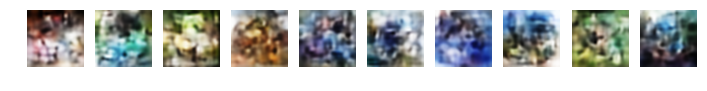

Epoch 551 of 2000 took 35.26s;
train unlabelled reconstruction loss: 1695.17;
train labelled reconstruction loss: 1694.39; train labelled classification loss: 0.38; train accuracy: 0.895
test labelled reconstruction loss: 1703.46; test labelled classification loss: 1.20; test accuracy: 0.596
Epoch 552 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1695.19;
train labelled reconstruction loss: 1694.88; train labelled classification loss: 0.37; train accuracy: 0.909
test labelled reconstruction loss: 1703.76; test labelled classification loss: 1.20; test accuracy: 0.601
Epoch 553 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1695.01;
train labelled reconstruction loss: 1694.88; train labelled classification loss: 0.37; train accuracy: 0.905
test labelled reconstruction loss: 1703.99; test labelled classification loss: 1.19; test accuracy: 0.602
Epoch 554 of 2000 took 35.33s;
train unlabelled reconstruction loss: 1695.05;
train labelled reconstruction loss: 1694.80

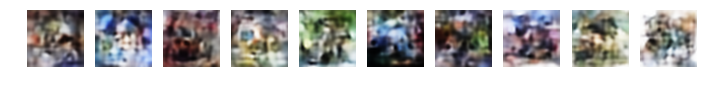

Epoch 561 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1695.03;
train labelled reconstruction loss: 1694.71; train labelled classification loss: 0.35; train accuracy: 0.911
test labelled reconstruction loss: 1703.50; test labelled classification loss: 1.20; test accuracy: 0.599
Epoch 562 of 2000 took 35.09s;
train unlabelled reconstruction loss: 1695.16;
train labelled reconstruction loss: 1695.16; train labelled classification loss: 0.36; train accuracy: 0.907
test labelled reconstruction loss: 1703.74; test labelled classification loss: 1.21; test accuracy: 0.597
Epoch 563 of 2000 took 35.98s;
train unlabelled reconstruction loss: 1695.10;
train labelled reconstruction loss: 1694.85; train labelled classification loss: 0.35; train accuracy: 0.906
test labelled reconstruction loss: 1704.01; test labelled classification loss: 1.20; test accuracy: 0.602
Epoch 564 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1695.14;
train labelled reconstruction loss: 1694.71

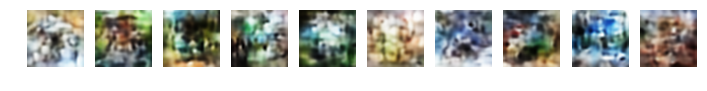

Epoch 571 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1694.97;
train labelled reconstruction loss: 1694.96; train labelled classification loss: 0.34; train accuracy: 0.915
test labelled reconstruction loss: 1703.64; test labelled classification loss: 1.20; test accuracy: 0.600
Epoch 572 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1695.07;
train labelled reconstruction loss: 1694.73; train labelled classification loss: 0.34; train accuracy: 0.917
test labelled reconstruction loss: 1703.64; test labelled classification loss: 1.20; test accuracy: 0.602
Epoch 573 of 2000 took 35.65s;
train unlabelled reconstruction loss: 1694.94;
train labelled reconstruction loss: 1694.65; train labelled classification loss: 0.34; train accuracy: 0.910
test labelled reconstruction loss: 1703.41; test labelled classification loss: 1.21; test accuracy: 0.592
Epoch 574 of 2000 took 34.89s;
train unlabelled reconstruction loss: 1695.07;
train labelled reconstruction loss: 1694.76

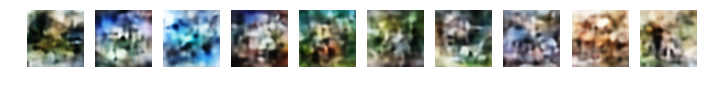

Epoch 581 of 2000 took 35.65s;
train unlabelled reconstruction loss: 1695.06;
train labelled reconstruction loss: 1694.98; train labelled classification loss: 0.35; train accuracy: 0.910
test labelled reconstruction loss: 1703.72; test labelled classification loss: 1.20; test accuracy: 0.603
Epoch 582 of 2000 took 35.29s;
train unlabelled reconstruction loss: 1695.19;
train labelled reconstruction loss: 1694.82; train labelled classification loss: 0.33; train accuracy: 0.920
test labelled reconstruction loss: 1704.35; test labelled classification loss: 1.22; test accuracy: 0.595
Epoch 583 of 2000 took 36.45s;
train unlabelled reconstruction loss: 1695.10;
train labelled reconstruction loss: 1694.39; train labelled classification loss: 0.32; train accuracy: 0.923
test labelled reconstruction loss: 1703.24; test labelled classification loss: 1.19; test accuracy: 0.603
Epoch 584 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1694.96;
train labelled reconstruction loss: 1695.08

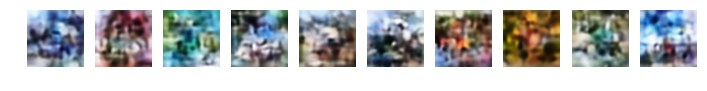

Epoch 591 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1695.02;
train labelled reconstruction loss: 1694.50; train labelled classification loss: 0.32; train accuracy: 0.919
test labelled reconstruction loss: 1703.95; test labelled classification loss: 1.21; test accuracy: 0.598
Epoch 592 of 2000 took 35.48s;
train unlabelled reconstruction loss: 1695.01;
train labelled reconstruction loss: 1695.11; train labelled classification loss: 0.33; train accuracy: 0.918
test labelled reconstruction loss: 1704.01; test labelled classification loss: 1.21; test accuracy: 0.600
Epoch 593 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1694.92;
train labelled reconstruction loss: 1694.60; train labelled classification loss: 0.31; train accuracy: 0.926
test labelled reconstruction loss: 1703.50; test labelled classification loss: 1.22; test accuracy: 0.595
Epoch 594 of 2000 took 35.33s;
train unlabelled reconstruction loss: 1695.00;
train labelled reconstruction loss: 1694.52

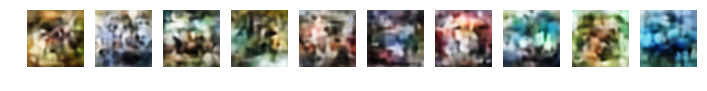

Epoch 601 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1694.91;
train labelled reconstruction loss: 1694.47; train labelled classification loss: 0.31; train accuracy: 0.919
test labelled reconstruction loss: 1703.73; test labelled classification loss: 1.21; test accuracy: 0.600
Epoch 602 of 2000 took 35.21s;
train unlabelled reconstruction loss: 1694.99;
train labelled reconstruction loss: 1694.83; train labelled classification loss: 0.30; train accuracy: 0.920
test labelled reconstruction loss: 1704.79; test labelled classification loss: 1.24; test accuracy: 0.592
Epoch 603 of 2000 took 36.00s;
train unlabelled reconstruction loss: 1694.99;
train labelled reconstruction loss: 1694.78; train labelled classification loss: 0.30; train accuracy: 0.922
test labelled reconstruction loss: 1704.12; test labelled classification loss: 1.20; test accuracy: 0.604
Epoch 604 of 2000 took 35.97s;
train unlabelled reconstruction loss: 1694.90;
train labelled reconstruction loss: 1694.75

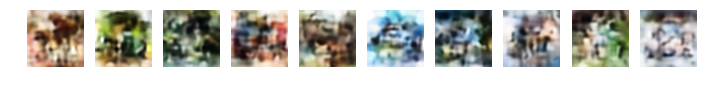

Epoch 611 of 2000 took 37.36s;
train unlabelled reconstruction loss: 1694.88;
train labelled reconstruction loss: 1694.46; train labelled classification loss: 0.29; train accuracy: 0.932
test labelled reconstruction loss: 1704.04; test labelled classification loss: 1.22; test accuracy: 0.602
Epoch 612 of 2000 took 36.96s;
train unlabelled reconstruction loss: 1694.92;
train labelled reconstruction loss: 1694.88; train labelled classification loss: 0.28; train accuracy: 0.936
test labelled reconstruction loss: 1704.41; test labelled classification loss: 1.21; test accuracy: 0.597
Epoch 613 of 2000 took 35.94s;
train unlabelled reconstruction loss: 1695.01;
train labelled reconstruction loss: 1694.57; train labelled classification loss: 0.29; train accuracy: 0.926
test labelled reconstruction loss: 1703.76; test labelled classification loss: 1.21; test accuracy: 0.599
Epoch 614 of 2000 took 34.97s;
train unlabelled reconstruction loss: 1694.90;
train labelled reconstruction loss: 1694.29

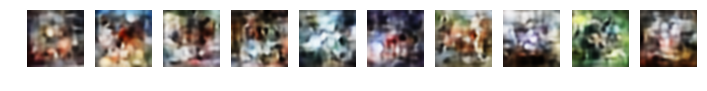

Epoch 621 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1694.86;
train labelled reconstruction loss: 1694.59; train labelled classification loss: 0.28; train accuracy: 0.923
test labelled reconstruction loss: 1703.94; test labelled classification loss: 1.21; test accuracy: 0.603
Epoch 622 of 2000 took 35.08s;
train unlabelled reconstruction loss: 1694.83;
train labelled reconstruction loss: 1694.22; train labelled classification loss: 0.28; train accuracy: 0.932
test labelled reconstruction loss: 1703.66; test labelled classification loss: 1.20; test accuracy: 0.603
Epoch 623 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1694.90;
train labelled reconstruction loss: 1694.37; train labelled classification loss: 0.27; train accuracy: 0.932
test labelled reconstruction loss: 1704.00; test labelled classification loss: 1.22; test accuracy: 0.601
Epoch 624 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1694.65;
train labelled reconstruction loss: 1694.83

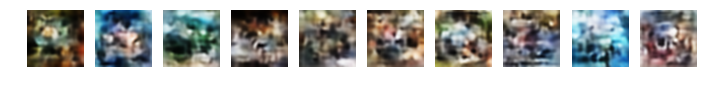

Epoch 631 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1694.67;
train labelled reconstruction loss: 1694.70; train labelled classification loss: 0.27; train accuracy: 0.936
test labelled reconstruction loss: 1703.76; test labelled classification loss: 1.21; test accuracy: 0.604
Epoch 632 of 2000 took 36.00s;
train unlabelled reconstruction loss: 1694.72;
train labelled reconstruction loss: 1694.45; train labelled classification loss: 0.27; train accuracy: 0.934
test labelled reconstruction loss: 1703.77; test labelled classification loss: 1.22; test accuracy: 0.604
Epoch 633 of 2000 took 36.02s;
train unlabelled reconstruction loss: 1694.78;
train labelled reconstruction loss: 1694.46; train labelled classification loss: 0.27; train accuracy: 0.932
test labelled reconstruction loss: 1703.63; test labelled classification loss: 1.23; test accuracy: 0.600
Epoch 634 of 2000 took 35.16s;
train unlabelled reconstruction loss: 1694.77;
train labelled reconstruction loss: 1694.32

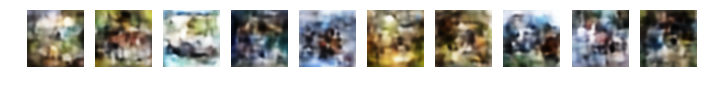

Epoch 641 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1694.74;
train labelled reconstruction loss: 1694.77; train labelled classification loss: 0.27; train accuracy: 0.936
test labelled reconstruction loss: 1704.63; test labelled classification loss: 1.23; test accuracy: 0.606
Epoch 642 of 2000 took 35.20s;
train unlabelled reconstruction loss: 1694.68;
train labelled reconstruction loss: 1694.44; train labelled classification loss: 0.27; train accuracy: 0.933
test labelled reconstruction loss: 1703.26; test labelled classification loss: 1.22; test accuracy: 0.605
Epoch 643 of 2000 took 35.57s;
train unlabelled reconstruction loss: 1694.88;
train labelled reconstruction loss: 1694.26; train labelled classification loss: 0.26; train accuracy: 0.941
test labelled reconstruction loss: 1704.03; test labelled classification loss: 1.23; test accuracy: 0.606
Epoch 644 of 2000 took 35.57s;
train unlabelled reconstruction loss: 1694.89;
train labelled reconstruction loss: 1694.29

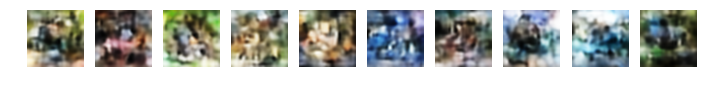

Epoch 651 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1694.73;
train labelled reconstruction loss: 1694.92; train labelled classification loss: 0.25; train accuracy: 0.941
test labelled reconstruction loss: 1704.58; test labelled classification loss: 1.24; test accuracy: 0.595
Epoch 652 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1694.75;
train labelled reconstruction loss: 1694.23; train labelled classification loss: 0.25; train accuracy: 0.941
test labelled reconstruction loss: 1703.38; test labelled classification loss: 1.22; test accuracy: 0.608
Epoch 653 of 2000 took 35.75s;
train unlabelled reconstruction loss: 1694.76;
train labelled reconstruction loss: 1694.37; train labelled classification loss: 0.25; train accuracy: 0.940
test labelled reconstruction loss: 1703.91; test labelled classification loss: 1.21; test accuracy: 0.603
Epoch 654 of 2000 took 35.20s;
train unlabelled reconstruction loss: 1694.58;
train labelled reconstruction loss: 1694.61

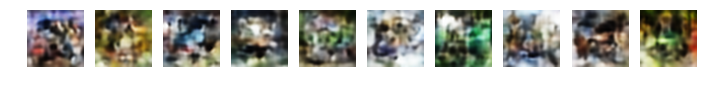

Epoch 661 of 2000 took 35.99s;
train unlabelled reconstruction loss: 1694.69;
train labelled reconstruction loss: 1694.27; train labelled classification loss: 0.24; train accuracy: 0.943
test labelled reconstruction loss: 1703.84; test labelled classification loss: 1.24; test accuracy: 0.597
Epoch 662 of 2000 took 35.47s;
train unlabelled reconstruction loss: 1694.85;
train labelled reconstruction loss: 1694.43; train labelled classification loss: 0.24; train accuracy: 0.941
test labelled reconstruction loss: 1704.10; test labelled classification loss: 1.24; test accuracy: 0.599
Epoch 663 of 2000 took 36.08s;
train unlabelled reconstruction loss: 1694.63;
train labelled reconstruction loss: 1694.58; train labelled classification loss: 0.23; train accuracy: 0.946
test labelled reconstruction loss: 1705.35; test labelled classification loss: 1.24; test accuracy: 0.601
Epoch 664 of 2000 took 36.25s;
train unlabelled reconstruction loss: 1694.66;
train labelled reconstruction loss: 1694.32

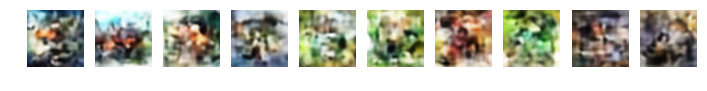

Epoch 671 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1694.76;
train labelled reconstruction loss: 1694.55; train labelled classification loss: 0.24; train accuracy: 0.944
test labelled reconstruction loss: 1704.67; test labelled classification loss: 1.21; test accuracy: 0.612
Epoch 672 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1694.84;
train labelled reconstruction loss: 1694.32; train labelled classification loss: 0.23; train accuracy: 0.944
test labelled reconstruction loss: 1704.23; test labelled classification loss: 1.22; test accuracy: 0.611
Epoch 673 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1694.73;
train labelled reconstruction loss: 1694.76; train labelled classification loss: 0.23; train accuracy: 0.945
test labelled reconstruction loss: 1703.98; test labelled classification loss: 1.24; test accuracy: 0.601
Epoch 674 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1694.55;
train labelled reconstruction loss: 1694.33

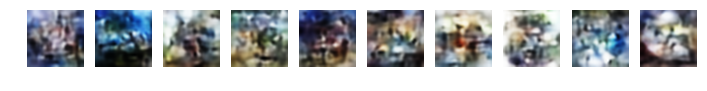

Epoch 681 of 2000 took 35.16s;
train unlabelled reconstruction loss: 1694.66;
train labelled reconstruction loss: 1694.36; train labelled classification loss: 0.22; train accuracy: 0.946
test labelled reconstruction loss: 1703.75; test labelled classification loss: 1.21; test accuracy: 0.609
Epoch 682 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1694.60;
train labelled reconstruction loss: 1694.61; train labelled classification loss: 0.21; train accuracy: 0.948
test labelled reconstruction loss: 1704.67; test labelled classification loss: 1.24; test accuracy: 0.602
Epoch 683 of 2000 took 36.05s;
train unlabelled reconstruction loss: 1694.72;
train labelled reconstruction loss: 1694.05; train labelled classification loss: 0.22; train accuracy: 0.953
test labelled reconstruction loss: 1703.82; test labelled classification loss: 1.22; test accuracy: 0.611
Epoch 684 of 2000 took 35.99s;
train unlabelled reconstruction loss: 1694.68;
train labelled reconstruction loss: 1694.10

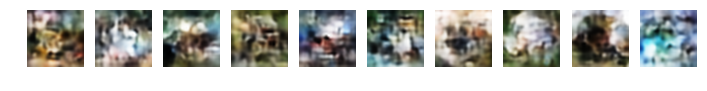

Epoch 691 of 2000 took 35.75s;
train unlabelled reconstruction loss: 1694.63;
train labelled reconstruction loss: 1694.36; train labelled classification loss: 0.21; train accuracy: 0.954
test labelled reconstruction loss: 1704.50; test labelled classification loss: 1.22; test accuracy: 0.607
Epoch 692 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1694.67;
train labelled reconstruction loss: 1694.07; train labelled classification loss: 0.20; train accuracy: 0.956
test labelled reconstruction loss: 1703.63; test labelled classification loss: 1.22; test accuracy: 0.615
Epoch 693 of 2000 took 35.41s;
train unlabelled reconstruction loss: 1694.61;
train labelled reconstruction loss: 1694.34; train labelled classification loss: 0.21; train accuracy: 0.951
test labelled reconstruction loss: 1703.92; test labelled classification loss: 1.25; test accuracy: 0.604
Epoch 694 of 2000 took 35.19s;
train unlabelled reconstruction loss: 1694.63;
train labelled reconstruction loss: 1694.15

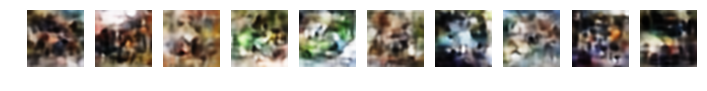

Epoch 701 of 2000 took 35.43s;
train unlabelled reconstruction loss: 1694.66;
train labelled reconstruction loss: 1694.26; train labelled classification loss: 0.20; train accuracy: 0.950
test labelled reconstruction loss: 1703.84; test labelled classification loss: 1.22; test accuracy: 0.607
Epoch 702 of 2000 took 35.47s;
train unlabelled reconstruction loss: 1694.56;
train labelled reconstruction loss: 1694.40; train labelled classification loss: 0.20; train accuracy: 0.954
test labelled reconstruction loss: 1705.08; test labelled classification loss: 1.25; test accuracy: 0.600
Epoch 703 of 2000 took 35.34s;
train unlabelled reconstruction loss: 1694.55;
train labelled reconstruction loss: 1694.32; train labelled classification loss: 0.19; train accuracy: 0.963
test labelled reconstruction loss: 1704.77; test labelled classification loss: 1.24; test accuracy: 0.608
Epoch 704 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1694.69;
train labelled reconstruction loss: 1694.44

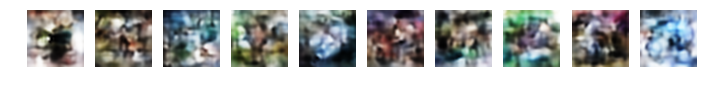

Epoch 711 of 2000 took 35.69s;
train unlabelled reconstruction loss: 1694.64;
train labelled reconstruction loss: 1694.57; train labelled classification loss: 0.19; train accuracy: 0.955
test labelled reconstruction loss: 1703.72; test labelled classification loss: 1.24; test accuracy: 0.608
Epoch 712 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1694.58;
train labelled reconstruction loss: 1694.25; train labelled classification loss: 0.18; train accuracy: 0.962
test labelled reconstruction loss: 1704.18; test labelled classification loss: 1.26; test accuracy: 0.601
Epoch 713 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1694.64;
train labelled reconstruction loss: 1694.21; train labelled classification loss: 0.20; train accuracy: 0.953
test labelled reconstruction loss: 1703.94; test labelled classification loss: 1.23; test accuracy: 0.609
Epoch 714 of 2000 took 35.34s;
train unlabelled reconstruction loss: 1694.72;
train labelled reconstruction loss: 1694.31

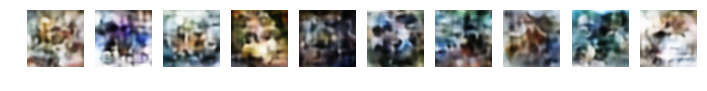

Epoch 721 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1694.56;
train labelled reconstruction loss: 1694.66; train labelled classification loss: 0.19; train accuracy: 0.959
test labelled reconstruction loss: 1704.68; test labelled classification loss: 1.25; test accuracy: 0.605
Epoch 722 of 2000 took 36.31s;
train unlabelled reconstruction loss: 1694.64;
train labelled reconstruction loss: 1694.51; train labelled classification loss: 0.19; train accuracy: 0.957
test labelled reconstruction loss: 1703.91; test labelled classification loss: 1.25; test accuracy: 0.603
Epoch 723 of 2000 took 37.20s;
train unlabelled reconstruction loss: 1694.44;
train labelled reconstruction loss: 1694.46; train labelled classification loss: 0.19; train accuracy: 0.961
test labelled reconstruction loss: 1705.48; test labelled classification loss: 1.25; test accuracy: 0.609
Epoch 724 of 2000 took 36.92s;
train unlabelled reconstruction loss: 1694.57;
train labelled reconstruction loss: 1694.23

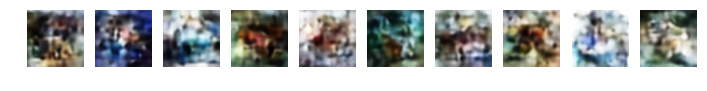

Epoch 731 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1694.68;
train labelled reconstruction loss: 1694.25; train labelled classification loss: 0.17; train accuracy: 0.961
test labelled reconstruction loss: 1703.83; test labelled classification loss: 1.26; test accuracy: 0.605
Epoch 732 of 2000 took 35.74s;
train unlabelled reconstruction loss: 1694.40;
train labelled reconstruction loss: 1694.04; train labelled classification loss: 0.18; train accuracy: 0.958
test labelled reconstruction loss: 1703.58; test labelled classification loss: 1.27; test accuracy: 0.602
Epoch 733 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1694.69;
train labelled reconstruction loss: 1694.23; train labelled classification loss: 0.18; train accuracy: 0.958
test labelled reconstruction loss: 1703.97; test labelled classification loss: 1.25; test accuracy: 0.607
Epoch 734 of 2000 took 35.09s;
train unlabelled reconstruction loss: 1694.45;
train labelled reconstruction loss: 1694.02

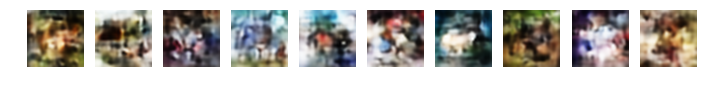

Epoch 741 of 2000 took 35.90s;
train unlabelled reconstruction loss: 1694.32;
train labelled reconstruction loss: 1694.44; train labelled classification loss: 0.16; train accuracy: 0.968
test labelled reconstruction loss: 1704.58; test labelled classification loss: 1.26; test accuracy: 0.608
Epoch 742 of 2000 took 35.03s;
train unlabelled reconstruction loss: 1694.66;
train labelled reconstruction loss: 1694.07; train labelled classification loss: 0.17; train accuracy: 0.963
test labelled reconstruction loss: 1703.83; test labelled classification loss: 1.24; test accuracy: 0.613
Epoch 743 of 2000 took 35.75s;
train unlabelled reconstruction loss: 1694.44;
train labelled reconstruction loss: 1694.51; train labelled classification loss: 0.17; train accuracy: 0.960
test labelled reconstruction loss: 1704.03; test labelled classification loss: 1.25; test accuracy: 0.613
Epoch 744 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1694.46;
train labelled reconstruction loss: 1694.19

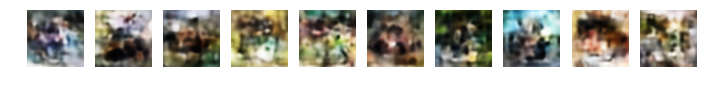

Epoch 751 of 2000 took 35.84s;
train unlabelled reconstruction loss: 1694.40;
train labelled reconstruction loss: 1694.16; train labelled classification loss: 0.17; train accuracy: 0.962
test labelled reconstruction loss: 1703.82; test labelled classification loss: 1.25; test accuracy: 0.617
Epoch 752 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1694.46;
train labelled reconstruction loss: 1694.17; train labelled classification loss: 0.17; train accuracy: 0.964
test labelled reconstruction loss: 1703.56; test labelled classification loss: 1.27; test accuracy: 0.606
Epoch 753 of 2000 took 35.61s;
train unlabelled reconstruction loss: 1694.47;
train labelled reconstruction loss: 1693.89; train labelled classification loss: 0.17; train accuracy: 0.965
test labelled reconstruction loss: 1703.72; test labelled classification loss: 1.24; test accuracy: 0.613
Epoch 754 of 2000 took 35.49s;
train unlabelled reconstruction loss: 1694.42;
train labelled reconstruction loss: 1694.13

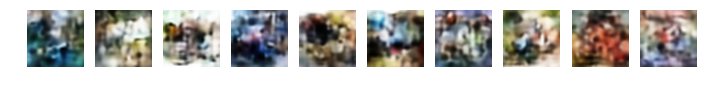

Epoch 761 of 2000 took 35.28s;
train unlabelled reconstruction loss: 1694.51;
train labelled reconstruction loss: 1693.80; train labelled classification loss: 0.15; train accuracy: 0.969
test labelled reconstruction loss: 1703.57; test labelled classification loss: 1.27; test accuracy: 0.610
Epoch 762 of 2000 took 35.60s;
train unlabelled reconstruction loss: 1694.45;
train labelled reconstruction loss: 1694.44; train labelled classification loss: 0.16; train accuracy: 0.964
test labelled reconstruction loss: 1704.38; test labelled classification loss: 1.26; test accuracy: 0.610
Epoch 763 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1694.42;
train labelled reconstruction loss: 1694.15; train labelled classification loss: 0.16; train accuracy: 0.962
test labelled reconstruction loss: 1703.74; test labelled classification loss: 1.27; test accuracy: 0.606
Epoch 764 of 2000 took 35.65s;
train unlabelled reconstruction loss: 1694.56;
train labelled reconstruction loss: 1694.25

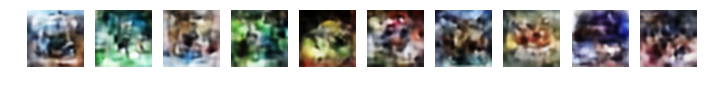

Epoch 771 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1694.34;
train labelled reconstruction loss: 1694.04; train labelled classification loss: 0.15; train accuracy: 0.969
test labelled reconstruction loss: 1703.93; test labelled classification loss: 1.28; test accuracy: 0.605
Epoch 772 of 2000 took 35.19s;
train unlabelled reconstruction loss: 1694.48;
train labelled reconstruction loss: 1694.08; train labelled classification loss: 0.15; train accuracy: 0.967
test labelled reconstruction loss: 1703.88; test labelled classification loss: 1.27; test accuracy: 0.607
Epoch 773 of 2000 took 35.40s;
train unlabelled reconstruction loss: 1694.37;
train labelled reconstruction loss: 1693.91; train labelled classification loss: 0.16; train accuracy: 0.967
test labelled reconstruction loss: 1703.93; test labelled classification loss: 1.27; test accuracy: 0.602
Epoch 774 of 2000 took 35.18s;
train unlabelled reconstruction loss: 1694.37;
train labelled reconstruction loss: 1694.04

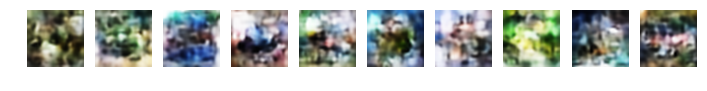

Epoch 781 of 2000 took 35.47s;
train unlabelled reconstruction loss: 1694.44;
train labelled reconstruction loss: 1694.22; train labelled classification loss: 0.15; train accuracy: 0.967
test labelled reconstruction loss: 1704.11; test labelled classification loss: 1.27; test accuracy: 0.610
Epoch 782 of 2000 took 35.64s;
train unlabelled reconstruction loss: 1694.47;
train labelled reconstruction loss: 1693.95; train labelled classification loss: 0.14; train accuracy: 0.970
test labelled reconstruction loss: 1703.80; test labelled classification loss: 1.25; test accuracy: 0.614
Epoch 783 of 2000 took 35.97s;
train unlabelled reconstruction loss: 1694.32;
train labelled reconstruction loss: 1694.14; train labelled classification loss: 0.15; train accuracy: 0.969
test labelled reconstruction loss: 1704.51; test labelled classification loss: 1.26; test accuracy: 0.616
Epoch 784 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1694.30;
train labelled reconstruction loss: 1694.02

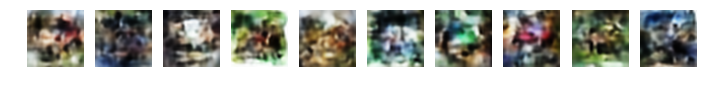

Epoch 791 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1694.40;
train labelled reconstruction loss: 1694.10; train labelled classification loss: 0.15; train accuracy: 0.966
test labelled reconstruction loss: 1704.00; test labelled classification loss: 1.29; test accuracy: 0.604
Epoch 792 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1694.45;
train labelled reconstruction loss: 1694.00; train labelled classification loss: 0.14; train accuracy: 0.969
test labelled reconstruction loss: 1703.43; test labelled classification loss: 1.27; test accuracy: 0.613
Epoch 793 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1694.38;
train labelled reconstruction loss: 1694.08; train labelled classification loss: 0.14; train accuracy: 0.969
test labelled reconstruction loss: 1703.92; test labelled classification loss: 1.26; test accuracy: 0.612
Epoch 794 of 2000 took 35.61s;
train unlabelled reconstruction loss: 1694.33;
train labelled reconstruction loss: 1693.76

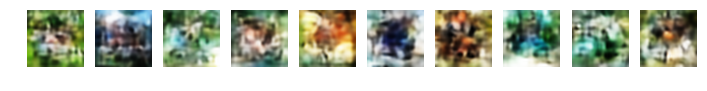

Epoch 801 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1694.28;
train labelled reconstruction loss: 1694.12; train labelled classification loss: 0.14; train accuracy: 0.970
test labelled reconstruction loss: 1704.00; test labelled classification loss: 1.28; test accuracy: 0.610
Epoch 802 of 2000 took 35.29s;
train unlabelled reconstruction loss: 1694.38;
train labelled reconstruction loss: 1694.40; train labelled classification loss: 0.15; train accuracy: 0.968
test labelled reconstruction loss: 1704.20; test labelled classification loss: 1.27; test accuracy: 0.618
Epoch 803 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1694.44;
train labelled reconstruction loss: 1693.78; train labelled classification loss: 0.13; train accuracy: 0.970
test labelled reconstruction loss: 1703.57; test labelled classification loss: 1.27; test accuracy: 0.618
Epoch 804 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1694.29;
train labelled reconstruction loss: 1693.79

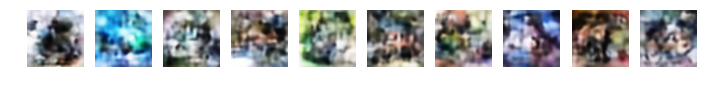

Epoch 811 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1694.27;
train labelled reconstruction loss: 1693.85; train labelled classification loss: 0.13; train accuracy: 0.969
test labelled reconstruction loss: 1703.94; test labelled classification loss: 1.28; test accuracy: 0.607
Epoch 812 of 2000 took 35.90s;
train unlabelled reconstruction loss: 1694.15;
train labelled reconstruction loss: 1693.71; train labelled classification loss: 0.13; train accuracy: 0.972
test labelled reconstruction loss: 1703.54; test labelled classification loss: 1.29; test accuracy: 0.609
Epoch 813 of 2000 took 35.47s;
train unlabelled reconstruction loss: 1694.15;
train labelled reconstruction loss: 1693.97; train labelled classification loss: 0.13; train accuracy: 0.972
test labelled reconstruction loss: 1703.68; test labelled classification loss: 1.30; test accuracy: 0.606
Epoch 814 of 2000 took 34.79s;
train unlabelled reconstruction loss: 1694.39;
train labelled reconstruction loss: 1693.96

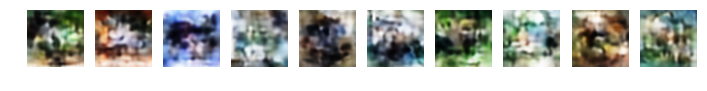

Epoch 821 of 2000 took 35.43s;
train unlabelled reconstruction loss: 1694.31;
train labelled reconstruction loss: 1693.71; train labelled classification loss: 0.12; train accuracy: 0.974
test labelled reconstruction loss: 1703.65; test labelled classification loss: 1.29; test accuracy: 0.611
Epoch 822 of 2000 took 34.96s;
train unlabelled reconstruction loss: 1694.38;
train labelled reconstruction loss: 1694.29; train labelled classification loss: 0.13; train accuracy: 0.970
test labelled reconstruction loss: 1704.53; test labelled classification loss: 1.30; test accuracy: 0.616
Epoch 823 of 2000 took 35.75s;
train unlabelled reconstruction loss: 1694.47;
train labelled reconstruction loss: 1694.11; train labelled classification loss: 0.13; train accuracy: 0.967
test labelled reconstruction loss: 1704.09; test labelled classification loss: 1.30; test accuracy: 0.606
Epoch 824 of 2000 took 35.99s;
train unlabelled reconstruction loss: 1694.30;
train labelled reconstruction loss: 1693.79

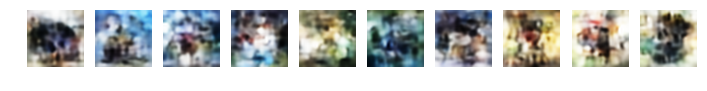

Epoch 831 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1694.28;
train labelled reconstruction loss: 1694.05; train labelled classification loss: 0.12; train accuracy: 0.977
test labelled reconstruction loss: 1704.20; test labelled classification loss: 1.30; test accuracy: 0.613
Epoch 832 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1694.35;
train labelled reconstruction loss: 1693.90; train labelled classification loss: 0.12; train accuracy: 0.974
test labelled reconstruction loss: 1704.19; test labelled classification loss: 1.28; test accuracy: 0.615
Epoch 833 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1694.17;
train labelled reconstruction loss: 1693.81; train labelled classification loss: 0.13; train accuracy: 0.968
test labelled reconstruction loss: 1703.52; test labelled classification loss: 1.28; test accuracy: 0.608
Epoch 834 of 2000 took 35.21s;
train unlabelled reconstruction loss: 1694.41;
train labelled reconstruction loss: 1694.12

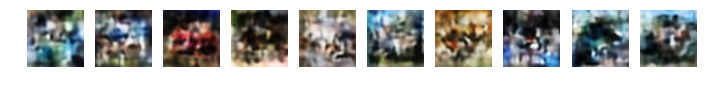

Epoch 841 of 2000 took 35.60s;
train unlabelled reconstruction loss: 1694.20;
train labelled reconstruction loss: 1693.71; train labelled classification loss: 0.12; train accuracy: 0.976
test labelled reconstruction loss: 1704.38; test labelled classification loss: 1.29; test accuracy: 0.611
Epoch 842 of 2000 took 35.36s;
train unlabelled reconstruction loss: 1694.42;
train labelled reconstruction loss: 1693.85; train labelled classification loss: 0.12; train accuracy: 0.970
test labelled reconstruction loss: 1703.93; test labelled classification loss: 1.31; test accuracy: 0.609
Epoch 843 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1694.26;
train labelled reconstruction loss: 1693.84; train labelled classification loss: 0.11; train accuracy: 0.977
test labelled reconstruction loss: 1704.14; test labelled classification loss: 1.29; test accuracy: 0.613
Epoch 844 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1694.28;
train labelled reconstruction loss: 1693.72

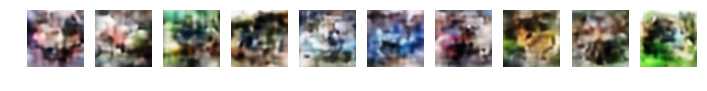

Epoch 851 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1694.30;
train labelled reconstruction loss: 1693.88; train labelled classification loss: 0.11; train accuracy: 0.978
test labelled reconstruction loss: 1704.27; test labelled classification loss: 1.31; test accuracy: 0.607
Epoch 852 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1694.27;
train labelled reconstruction loss: 1693.79; train labelled classification loss: 0.12; train accuracy: 0.974
test labelled reconstruction loss: 1703.92; test labelled classification loss: 1.28; test accuracy: 0.615
Epoch 853 of 2000 took 35.64s;
train unlabelled reconstruction loss: 1694.26;
train labelled reconstruction loss: 1693.76; train labelled classification loss: 0.12; train accuracy: 0.977
test labelled reconstruction loss: 1704.08; test labelled classification loss: 1.28; test accuracy: 0.619
Epoch 854 of 2000 took 34.99s;
train unlabelled reconstruction loss: 1694.11;
train labelled reconstruction loss: 1694.26

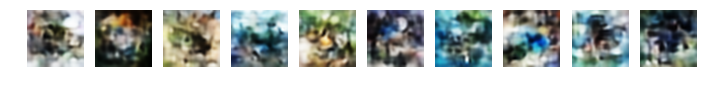

Epoch 861 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1694.26;
train labelled reconstruction loss: 1694.15; train labelled classification loss: 0.11; train accuracy: 0.979
test labelled reconstruction loss: 1704.44; test labelled classification loss: 1.31; test accuracy: 0.614
Epoch 862 of 2000 took 35.29s;
train unlabelled reconstruction loss: 1694.14;
train labelled reconstruction loss: 1693.89; train labelled classification loss: 0.11; train accuracy: 0.978
test labelled reconstruction loss: 1703.79; test labelled classification loss: 1.32; test accuracy: 0.613
Epoch 863 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1694.17;
train labelled reconstruction loss: 1693.77; train labelled classification loss: 0.11; train accuracy: 0.976
test labelled reconstruction loss: 1704.24; test labelled classification loss: 1.28; test accuracy: 0.617
Epoch 864 of 2000 took 35.66s;
train unlabelled reconstruction loss: 1694.12;
train labelled reconstruction loss: 1693.77

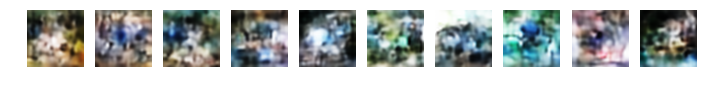

Epoch 871 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1694.35;
train labelled reconstruction loss: 1693.86; train labelled classification loss: 0.10; train accuracy: 0.979
test labelled reconstruction loss: 1704.35; test labelled classification loss: 1.30; test accuracy: 0.617
Epoch 872 of 2000 took 35.74s;
train unlabelled reconstruction loss: 1694.18;
train labelled reconstruction loss: 1693.76; train labelled classification loss: 0.10; train accuracy: 0.980
test labelled reconstruction loss: 1703.70; test labelled classification loss: 1.29; test accuracy: 0.614
Epoch 873 of 2000 took 35.61s;
train unlabelled reconstruction loss: 1694.31;
train labelled reconstruction loss: 1694.09; train labelled classification loss: 0.10; train accuracy: 0.981
test labelled reconstruction loss: 1703.83; test labelled classification loss: 1.29; test accuracy: 0.618
Epoch 874 of 2000 took 35.23s;
train unlabelled reconstruction loss: 1694.14;
train labelled reconstruction loss: 1693.78

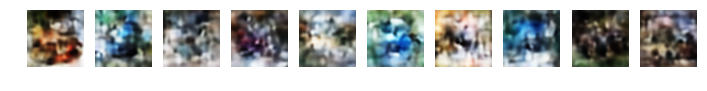

Epoch 881 of 2000 took 35.84s;
train unlabelled reconstruction loss: 1694.14;
train labelled reconstruction loss: 1693.91; train labelled classification loss: 0.10; train accuracy: 0.979
test labelled reconstruction loss: 1704.44; test labelled classification loss: 1.30; test accuracy: 0.613
Epoch 882 of 2000 took 35.21s;
train unlabelled reconstruction loss: 1694.12;
train labelled reconstruction loss: 1693.73; train labelled classification loss: 0.10; train accuracy: 0.979
test labelled reconstruction loss: 1703.96; test labelled classification loss: 1.30; test accuracy: 0.611
Epoch 883 of 2000 took 35.71s;
train unlabelled reconstruction loss: 1694.09;
train labelled reconstruction loss: 1693.83; train labelled classification loss: 0.10; train accuracy: 0.979
test labelled reconstruction loss: 1704.17; test labelled classification loss: 1.31; test accuracy: 0.616
Epoch 884 of 2000 took 35.65s;
train unlabelled reconstruction loss: 1694.19;
train labelled reconstruction loss: 1693.89

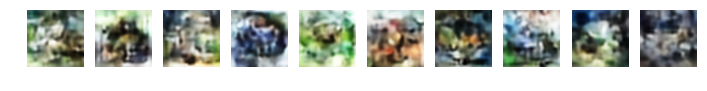

Epoch 891 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1694.22;
train labelled reconstruction loss: 1693.69; train labelled classification loss: 0.10; train accuracy: 0.978
test labelled reconstruction loss: 1703.71; test labelled classification loss: 1.32; test accuracy: 0.612
Epoch 892 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1694.20;
train labelled reconstruction loss: 1693.62; train labelled classification loss: 0.10; train accuracy: 0.980
test labelled reconstruction loss: 1704.34; test labelled classification loss: 1.31; test accuracy: 0.618
Epoch 893 of 2000 took 35.71s;
train unlabelled reconstruction loss: 1695.08;
train labelled reconstruction loss: 1694.29; train labelled classification loss: 0.10; train accuracy: 0.980
test labelled reconstruction loss: 1704.72; test labelled classification loss: 1.32; test accuracy: 0.613
Epoch 894 of 2000 took 34.95s;
train unlabelled reconstruction loss: 1694.19;
train labelled reconstruction loss: 1693.87

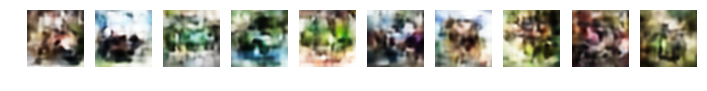

Epoch 901 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1694.18;
train labelled reconstruction loss: 1693.74; train labelled classification loss: 0.10; train accuracy: 0.980
test labelled reconstruction loss: 1703.73; test labelled classification loss: 1.29; test accuracy: 0.618
Epoch 902 of 2000 took 34.92s;
train unlabelled reconstruction loss: 1694.20;
train labelled reconstruction loss: 1693.59; train labelled classification loss: 0.10; train accuracy: 0.982
test labelled reconstruction loss: 1704.21; test labelled classification loss: 1.32; test accuracy: 0.615
Epoch 903 of 2000 took 35.65s;
train unlabelled reconstruction loss: 1694.31;
train labelled reconstruction loss: 1693.71; train labelled classification loss: 0.09; train accuracy: 0.986
test labelled reconstruction loss: 1704.06; test labelled classification loss: 1.29; test accuracy: 0.627
Epoch 904 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1694.17;
train labelled reconstruction loss: 1693.79

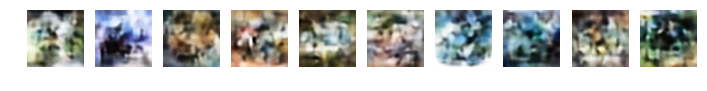

Epoch 911 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1694.12;
train labelled reconstruction loss: 1693.79; train labelled classification loss: 0.09; train accuracy: 0.984
test labelled reconstruction loss: 1703.84; test labelled classification loss: 1.33; test accuracy: 0.613
Epoch 912 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1694.08;
train labelled reconstruction loss: 1693.91; train labelled classification loss: 0.09; train accuracy: 0.980
test labelled reconstruction loss: 1704.56; test labelled classification loss: 1.32; test accuracy: 0.613
Epoch 913 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1694.20;
train labelled reconstruction loss: 1694.29; train labelled classification loss: 0.10; train accuracy: 0.981
test labelled reconstruction loss: 1704.12; test labelled classification loss: 1.34; test accuracy: 0.612
Epoch 914 of 2000 took 35.11s;
train unlabelled reconstruction loss: 1694.30;
train labelled reconstruction loss: 1693.56

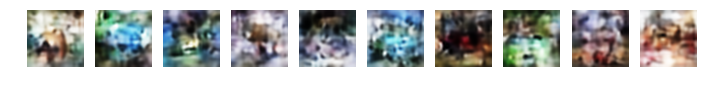

Epoch 921 of 2000 took 36.07s;
train unlabelled reconstruction loss: 1694.06;
train labelled reconstruction loss: 1693.65; train labelled classification loss: 0.09; train accuracy: 0.982
test labelled reconstruction loss: 1704.31; test labelled classification loss: 1.31; test accuracy: 0.624
Epoch 922 of 2000 took 35.51s;
train unlabelled reconstruction loss: 1694.15;
train labelled reconstruction loss: 1693.85; train labelled classification loss: 0.09; train accuracy: 0.982
test labelled reconstruction loss: 1704.99; test labelled classification loss: 1.33; test accuracy: 0.615
Epoch 923 of 2000 took 35.48s;
train unlabelled reconstruction loss: 1694.08;
train labelled reconstruction loss: 1693.91; train labelled classification loss: 0.09; train accuracy: 0.982
test labelled reconstruction loss: 1704.73; test labelled classification loss: 1.30; test accuracy: 0.621
Epoch 924 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1694.63;
train labelled reconstruction loss: 1695.76

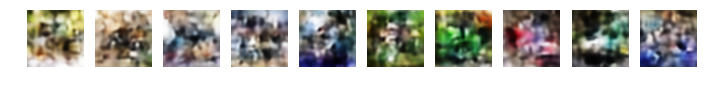

Epoch 931 of 2000 took 35.12s;
train unlabelled reconstruction loss: 1694.10;
train labelled reconstruction loss: 1693.60; train labelled classification loss: 0.09; train accuracy: 0.979
test labelled reconstruction loss: 1704.58; test labelled classification loss: 1.33; test accuracy: 0.620
Epoch 932 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1694.13;
train labelled reconstruction loss: 1693.52; train labelled classification loss: 0.09; train accuracy: 0.977
test labelled reconstruction loss: 1703.87; test labelled classification loss: 1.35; test accuracy: 0.615
Epoch 933 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1694.21;
train labelled reconstruction loss: 1694.03; train labelled classification loss: 0.09; train accuracy: 0.981
test labelled reconstruction loss: 1703.92; test labelled classification loss: 1.32; test accuracy: 0.617
Epoch 934 of 2000 took 35.58s;
train unlabelled reconstruction loss: 1694.12;
train labelled reconstruction loss: 1693.82

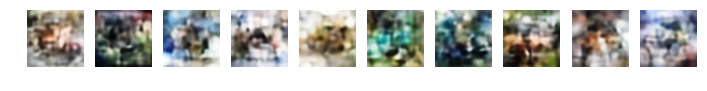

Epoch 941 of 2000 took 35.63s;
train unlabelled reconstruction loss: 1694.01;
train labelled reconstruction loss: 1693.65; train labelled classification loss: 0.08; train accuracy: 0.984
test labelled reconstruction loss: 1704.10; test labelled classification loss: 1.32; test accuracy: 0.616
Epoch 942 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1693.93;
train labelled reconstruction loss: 1693.68; train labelled classification loss: 0.08; train accuracy: 0.984
test labelled reconstruction loss: 1703.76; test labelled classification loss: 1.32; test accuracy: 0.615
Epoch 943 of 2000 took 35.35s;
train unlabelled reconstruction loss: 1694.03;
train labelled reconstruction loss: 1693.67; train labelled classification loss: 0.08; train accuracy: 0.983
test labelled reconstruction loss: 1704.26; test labelled classification loss: 1.34; test accuracy: 0.612
Epoch 944 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1693.95;
train labelled reconstruction loss: 1693.91

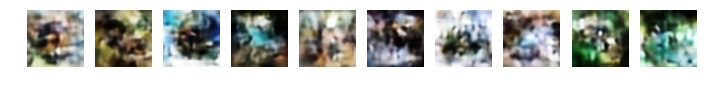

Epoch 951 of 2000 took 35.04s;
train unlabelled reconstruction loss: 1694.12;
train labelled reconstruction loss: 1693.76; train labelled classification loss: 0.08; train accuracy: 0.983
test labelled reconstruction loss: 1704.00; test labelled classification loss: 1.32; test accuracy: 0.622
Epoch 952 of 2000 took 35.94s;
train unlabelled reconstruction loss: 1694.20;
train labelled reconstruction loss: 1693.73; train labelled classification loss: 0.08; train accuracy: 0.983
test labelled reconstruction loss: 1704.12; test labelled classification loss: 1.31; test accuracy: 0.620
Epoch 953 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1694.25;
train labelled reconstruction loss: 1693.56; train labelled classification loss: 0.08; train accuracy: 0.983
test labelled reconstruction loss: 1704.39; test labelled classification loss: 1.32; test accuracy: 0.617
Epoch 954 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1694.11;
train labelled reconstruction loss: 1693.88

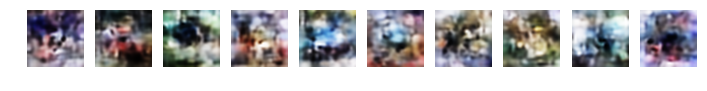

Epoch 961 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1693.92;
train labelled reconstruction loss: 1693.61; train labelled classification loss: 0.08; train accuracy: 0.983
test labelled reconstruction loss: 1703.97; test labelled classification loss: 1.34; test accuracy: 0.614
Epoch 962 of 2000 took 35.46s;
train unlabelled reconstruction loss: 1694.11;
train labelled reconstruction loss: 1693.71; train labelled classification loss: 0.08; train accuracy: 0.984
test labelled reconstruction loss: 1704.51; test labelled classification loss: 1.35; test accuracy: 0.615
Epoch 963 of 2000 took 35.30s;
train unlabelled reconstruction loss: 1693.99;
train labelled reconstruction loss: 1693.84; train labelled classification loss: 0.09; train accuracy: 0.980
test labelled reconstruction loss: 1703.95; test labelled classification loss: 1.34; test accuracy: 0.617
Epoch 964 of 2000 took 35.84s;
train unlabelled reconstruction loss: 1694.07;
train labelled reconstruction loss: 1693.61

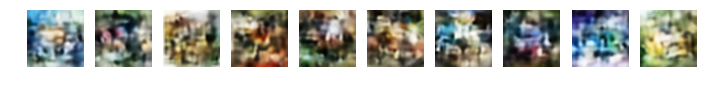

Epoch 971 of 2000 took 35.40s;
train unlabelled reconstruction loss: 1693.99;
train labelled reconstruction loss: 1693.44; train labelled classification loss: 0.07; train accuracy: 0.987
test labelled reconstruction loss: 1703.58; test labelled classification loss: 1.35; test accuracy: 0.613
Epoch 972 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1694.02;
train labelled reconstruction loss: 1693.81; train labelled classification loss: 0.07; train accuracy: 0.987
test labelled reconstruction loss: 1704.37; test labelled classification loss: 1.33; test accuracy: 0.620
Epoch 973 of 2000 took 35.69s;
train unlabelled reconstruction loss: 1694.14;
train labelled reconstruction loss: 1694.28; train labelled classification loss: 0.08; train accuracy: 0.983
test labelled reconstruction loss: 1704.25; test labelled classification loss: 1.34; test accuracy: 0.616
Epoch 974 of 2000 took 35.43s;
train unlabelled reconstruction loss: 1693.98;
train labelled reconstruction loss: 1693.53

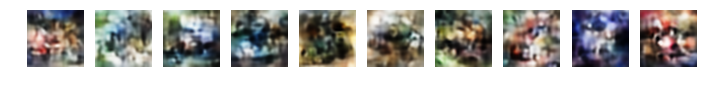

Epoch 981 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1694.05;
train labelled reconstruction loss: 1693.58; train labelled classification loss: 0.07; train accuracy: 0.988
test labelled reconstruction loss: 1704.08; test labelled classification loss: 1.36; test accuracy: 0.620
Epoch 982 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1694.01;
train labelled reconstruction loss: 1693.58; train labelled classification loss: 0.08; train accuracy: 0.983
test labelled reconstruction loss: 1703.85; test labelled classification loss: 1.35; test accuracy: 0.615
Epoch 983 of 2000 took 35.48s;
train unlabelled reconstruction loss: 1694.03;
train labelled reconstruction loss: 1693.57; train labelled classification loss: 0.07; train accuracy: 0.984
test labelled reconstruction loss: 1704.18; test labelled classification loss: 1.33; test accuracy: 0.619
Epoch 984 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1694.00;
train labelled reconstruction loss: 1693.72

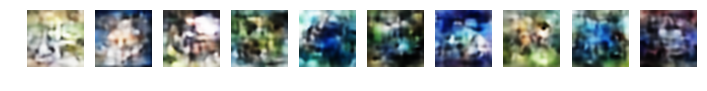

Epoch 991 of 2000 took 35.22s;
train unlabelled reconstruction loss: 1694.02;
train labelled reconstruction loss: 1693.75; train labelled classification loss: 0.07; train accuracy: 0.985
test labelled reconstruction loss: 1703.86; test labelled classification loss: 1.36; test accuracy: 0.609
Epoch 992 of 2000 took 36.04s;
train unlabelled reconstruction loss: 1693.95;
train labelled reconstruction loss: 1693.52; train labelled classification loss: 0.07; train accuracy: 0.987
test labelled reconstruction loss: 1704.27; test labelled classification loss: 1.38; test accuracy: 0.616
Epoch 993 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1693.94;
train labelled reconstruction loss: 1694.08; train labelled classification loss: 0.08; train accuracy: 0.984
test labelled reconstruction loss: 1704.89; test labelled classification loss: 1.35; test accuracy: 0.618
Epoch 994 of 2000 took 35.99s;
train unlabelled reconstruction loss: 1694.07;
train labelled reconstruction loss: 1693.70

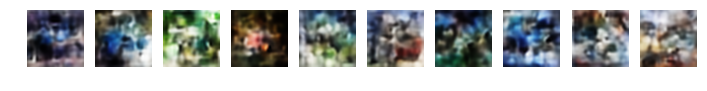

Epoch 1001 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1693.95;
train labelled reconstruction loss: 1693.85; train labelled classification loss: 0.07; train accuracy: 0.984
test labelled reconstruction loss: 1704.64; test labelled classification loss: 1.34; test accuracy: 0.618
Epoch 1002 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1694.10;
train labelled reconstruction loss: 1693.57; train labelled classification loss: 0.06; train accuracy: 0.987
test labelled reconstruction loss: 1704.23; test labelled classification loss: 1.32; test accuracy: 0.628
Epoch 1003 of 2000 took 35.36s;
train unlabelled reconstruction loss: 1693.98;
train labelled reconstruction loss: 1693.84; train labelled classification loss: 0.08; train accuracy: 0.981
test labelled reconstruction loss: 1704.52; test labelled classification loss: 1.36; test accuracy: 0.616
Epoch 1004 of 2000 took 35.95s;
train unlabelled reconstruction loss: 1693.89;
train labelled reconstruction loss: 169

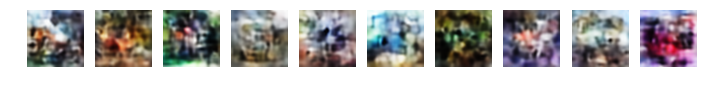

Epoch 1011 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1694.10;
train labelled reconstruction loss: 1693.69; train labelled classification loss: 0.06; train accuracy: 0.988
test labelled reconstruction loss: 1704.63; test labelled classification loss: 1.37; test accuracy: 0.610
Epoch 1012 of 2000 took 36.09s;
train unlabelled reconstruction loss: 1693.83;
train labelled reconstruction loss: 1693.86; train labelled classification loss: 0.07; train accuracy: 0.989
test labelled reconstruction loss: 1704.16; test labelled classification loss: 1.37; test accuracy: 0.610
Epoch 1013 of 2000 took 36.01s;
train unlabelled reconstruction loss: 1693.91;
train labelled reconstruction loss: 1693.74; train labelled classification loss: 0.07; train accuracy: 0.989
test labelled reconstruction loss: 1703.77; test labelled classification loss: 1.36; test accuracy: 0.613
Epoch 1014 of 2000 took 35.21s;
train unlabelled reconstruction loss: 1694.06;
train labelled reconstruction loss: 169

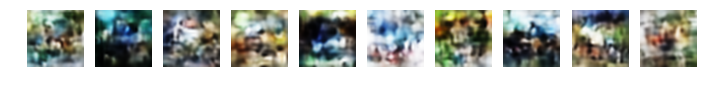

Epoch 1021 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1693.99;
train labelled reconstruction loss: 1693.84; train labelled classification loss: 0.06; train accuracy: 0.990
test labelled reconstruction loss: 1705.37; test labelled classification loss: 1.35; test accuracy: 0.615
Epoch 1022 of 2000 took 35.13s;
train unlabelled reconstruction loss: 1694.01;
train labelled reconstruction loss: 1693.74; train labelled classification loss: 0.07; train accuracy: 0.984
test labelled reconstruction loss: 1704.34; test labelled classification loss: 1.38; test accuracy: 0.621
Epoch 1023 of 2000 took 35.69s;
train unlabelled reconstruction loss: 1694.02;
train labelled reconstruction loss: 1693.72; train labelled classification loss: 0.06; train accuracy: 0.988
test labelled reconstruction loss: 1703.96; test labelled classification loss: 1.36; test accuracy: 0.622
Epoch 1024 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 169

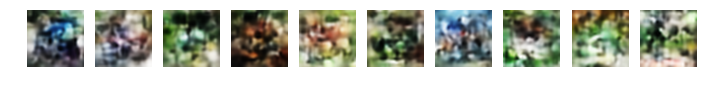

Epoch 1031 of 2000 took 36.00s;
train unlabelled reconstruction loss: 1693.83;
train labelled reconstruction loss: 1693.53; train labelled classification loss: 0.07; train accuracy: 0.985
test labelled reconstruction loss: 1703.98; test labelled classification loss: 1.35; test accuracy: 0.622
Epoch 1032 of 2000 took 35.58s;
train unlabelled reconstruction loss: 1693.99;
train labelled reconstruction loss: 1693.95; train labelled classification loss: 0.06; train accuracy: 0.987
test labelled reconstruction loss: 1705.60; test labelled classification loss: 1.36; test accuracy: 0.624
Epoch 1033 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1694.03;
train labelled reconstruction loss: 1693.64; train labelled classification loss: 0.06; train accuracy: 0.988
test labelled reconstruction loss: 1704.06; test labelled classification loss: 1.35; test accuracy: 0.624
Epoch 1034 of 2000 took 35.17s;
train unlabelled reconstruction loss: 1693.84;
train labelled reconstruction loss: 169

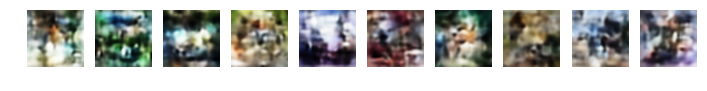

Epoch 1041 of 2000 took 35.66s;
train unlabelled reconstruction loss: 1693.87;
train labelled reconstruction loss: 1693.37; train labelled classification loss: 0.06; train accuracy: 0.987
test labelled reconstruction loss: 1704.24; test labelled classification loss: 1.37; test accuracy: 0.622
Epoch 1042 of 2000 took 35.49s;
train unlabelled reconstruction loss: 1693.94;
train labelled reconstruction loss: 1693.52; train labelled classification loss: 0.06; train accuracy: 0.986
test labelled reconstruction loss: 1703.75; test labelled classification loss: 1.36; test accuracy: 0.625
Epoch 1043 of 2000 took 35.44s;
train unlabelled reconstruction loss: 1693.82;
train labelled reconstruction loss: 1693.59; train labelled classification loss: 0.06; train accuracy: 0.989
test labelled reconstruction loss: 1703.96; test labelled classification loss: 1.39; test accuracy: 0.623
Epoch 1044 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 169

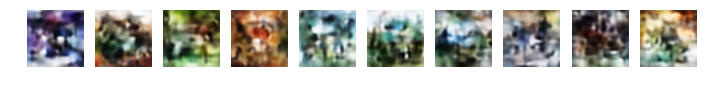

Epoch 1051 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1693.80;
train labelled reconstruction loss: 1693.52; train labelled classification loss: 0.06; train accuracy: 0.988
test labelled reconstruction loss: 1704.02; test labelled classification loss: 1.37; test accuracy: 0.616
Epoch 1052 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1693.86;
train labelled reconstruction loss: 1693.85; train labelled classification loss: 0.05; train accuracy: 0.992
test labelled reconstruction loss: 1704.77; test labelled classification loss: 1.34; test accuracy: 0.632
Epoch 1053 of 2000 took 35.54s;
train unlabelled reconstruction loss: 1693.91;
train labelled reconstruction loss: 1693.87; train labelled classification loss: 0.06; train accuracy: 0.986
test labelled reconstruction loss: 1705.71; test labelled classification loss: 1.37; test accuracy: 0.628
Epoch 1054 of 2000 took 35.32s;
train unlabelled reconstruction loss: 1693.88;
train labelled reconstruction loss: 169

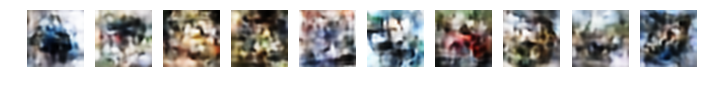

Epoch 1061 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1694.01;
train labelled reconstruction loss: 1693.56; train labelled classification loss: 0.06; train accuracy: 0.987
test labelled reconstruction loss: 1704.38; test labelled classification loss: 1.37; test accuracy: 0.624
Epoch 1062 of 2000 took 35.18s;
train unlabelled reconstruction loss: 1693.95;
train labelled reconstruction loss: 1693.40; train labelled classification loss: 0.06; train accuracy: 0.989
test labelled reconstruction loss: 1703.94; test labelled classification loss: 1.38; test accuracy: 0.625
Epoch 1063 of 2000 took 35.84s;
train unlabelled reconstruction loss: 1693.97;
train labelled reconstruction loss: 1693.90; train labelled classification loss: 0.06; train accuracy: 0.987
test labelled reconstruction loss: 1704.01; test labelled classification loss: 1.38; test accuracy: 0.623
Epoch 1064 of 2000 took 35.51s;
train unlabelled reconstruction loss: 1694.03;
train labelled reconstruction loss: 169

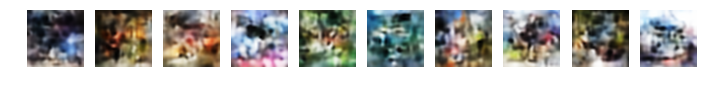

Epoch 1071 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1693.86;
train labelled reconstruction loss: 1693.42; train labelled classification loss: 0.06; train accuracy: 0.988
test labelled reconstruction loss: 1704.13; test labelled classification loss: 1.37; test accuracy: 0.623
Epoch 1072 of 2000 took 35.47s;
train unlabelled reconstruction loss: 1693.78;
train labelled reconstruction loss: 1693.67; train labelled classification loss: 0.05; train accuracy: 0.990
test labelled reconstruction loss: 1704.04; test labelled classification loss: 1.39; test accuracy: 0.617
Epoch 1073 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1693.84;
train labelled reconstruction loss: 1693.54; train labelled classification loss: 0.06; train accuracy: 0.987
test labelled reconstruction loss: 1704.48; test labelled classification loss: 1.38; test accuracy: 0.621
Epoch 1074 of 2000 took 35.19s;
train unlabelled reconstruction loss: 1693.74;
train labelled reconstruction loss: 169

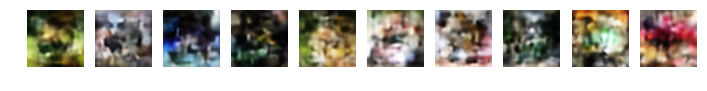

Epoch 1081 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1693.97;
train labelled reconstruction loss: 1693.48; train labelled classification loss: 0.05; train accuracy: 0.990
test labelled reconstruction loss: 1703.98; test labelled classification loss: 1.37; test accuracy: 0.626
Epoch 1082 of 2000 took 35.63s;
train unlabelled reconstruction loss: 1693.77;
train labelled reconstruction loss: 1693.33; train labelled classification loss: 0.06; train accuracy: 0.987
test labelled reconstruction loss: 1704.43; test labelled classification loss: 1.36; test accuracy: 0.622
Epoch 1083 of 2000 took 35.33s;
train unlabelled reconstruction loss: 1693.76;
train labelled reconstruction loss: 1693.54; train labelled classification loss: 0.05; train accuracy: 0.990
test labelled reconstruction loss: 1705.08; test labelled classification loss: 1.37; test accuracy: 0.621
Epoch 1084 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1694.02;
train labelled reconstruction loss: 169

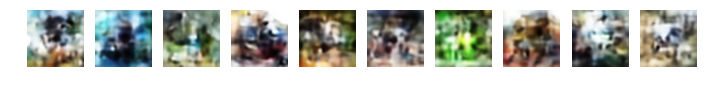

Epoch 1091 of 2000 took 35.27s;
train unlabelled reconstruction loss: 1693.92;
train labelled reconstruction loss: 1693.41; train labelled classification loss: 0.05; train accuracy: 0.991
test labelled reconstruction loss: 1704.00; test labelled classification loss: 1.38; test accuracy: 0.618
Epoch 1092 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1694.08;
train labelled reconstruction loss: 1695.78; train labelled classification loss: 0.05; train accuracy: 0.989
test labelled reconstruction loss: 1705.50; test labelled classification loss: 1.38; test accuracy: 0.617
Epoch 1093 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1694.00;
train labelled reconstruction loss: 1693.55; train labelled classification loss: 0.05; train accuracy: 0.987
test labelled reconstruction loss: 1704.46; test labelled classification loss: 1.39; test accuracy: 0.619
Epoch 1094 of 2000 took 35.35s;
train unlabelled reconstruction loss: 1693.91;
train labelled reconstruction loss: 169

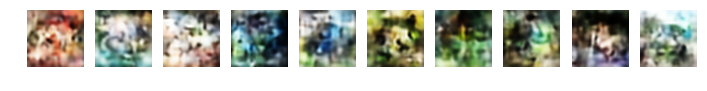

Epoch 1101 of 2000 took 35.90s;
train unlabelled reconstruction loss: 1693.78;
train labelled reconstruction loss: 1693.79; train labelled classification loss: 0.06; train accuracy: 0.988
test labelled reconstruction loss: 1704.97; test labelled classification loss: 1.37; test accuracy: 0.625
Epoch 1102 of 2000 took 35.35s;
train unlabelled reconstruction loss: 1693.88;
train labelled reconstruction loss: 1693.45; train labelled classification loss: 0.06; train accuracy: 0.987
test labelled reconstruction loss: 1704.54; test labelled classification loss: 1.40; test accuracy: 0.623
Epoch 1103 of 2000 took 35.07s;
train unlabelled reconstruction loss: 1693.92;
train labelled reconstruction loss: 1693.41; train labelled classification loss: 0.05; train accuracy: 0.989
test labelled reconstruction loss: 1703.92; test labelled classification loss: 1.36; test accuracy: 0.622
Epoch 1104 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1693.84;
train labelled reconstruction loss: 169

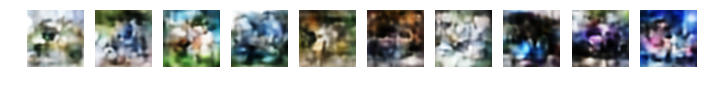

Epoch 1111 of 2000 took 35.50s;
train unlabelled reconstruction loss: 1693.80;
train labelled reconstruction loss: 1693.24; train labelled classification loss: 0.05; train accuracy: 0.992
test labelled reconstruction loss: 1704.42; test labelled classification loss: 1.37; test accuracy: 0.628
Epoch 1112 of 2000 took 35.75s;
train unlabelled reconstruction loss: 1693.80;
train labelled reconstruction loss: 1693.55; train labelled classification loss: 0.05; train accuracy: 0.987
test labelled reconstruction loss: 1704.47; test labelled classification loss: 1.39; test accuracy: 0.622
Epoch 1113 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1693.76;
train labelled reconstruction loss: 1693.53; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1704.07; test labelled classification loss: 1.42; test accuracy: 0.621
Epoch 1114 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1693.76;
train labelled reconstruction loss: 169

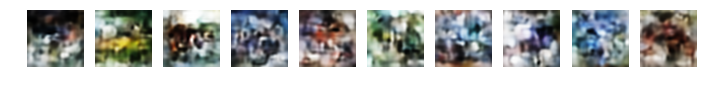

Epoch 1121 of 2000 took 35.84s;
train unlabelled reconstruction loss: 1693.82;
train labelled reconstruction loss: 1693.50; train labelled classification loss: 0.05; train accuracy: 0.990
test labelled reconstruction loss: 1704.33; test labelled classification loss: 1.40; test accuracy: 0.623
Epoch 1122 of 2000 took 35.38s;
train unlabelled reconstruction loss: 1693.77;
train labelled reconstruction loss: 1693.88; train labelled classification loss: 0.05; train accuracy: 0.990
test labelled reconstruction loss: 1704.53; test labelled classification loss: 1.41; test accuracy: 0.625
Epoch 1123 of 2000 took 36.33s;
train unlabelled reconstruction loss: 1693.75;
train labelled reconstruction loss: 1693.31; train labelled classification loss: 0.05; train accuracy: 0.991
test labelled reconstruction loss: 1704.43; test labelled classification loss: 1.37; test accuracy: 0.628
Epoch 1124 of 2000 took 36.23s;
train unlabelled reconstruction loss: 1693.80;
train labelled reconstruction loss: 169

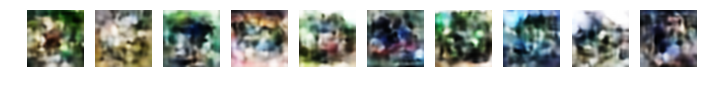

Epoch 1131 of 2000 took 35.96s;
train unlabelled reconstruction loss: 1693.76;
train labelled reconstruction loss: 1693.40; train labelled classification loss: 0.04; train accuracy: 0.994
test labelled reconstruction loss: 1704.58; test labelled classification loss: 1.39; test accuracy: 0.621
Epoch 1132 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1693.92;
train labelled reconstruction loss: 1693.45; train labelled classification loss: 0.05; train accuracy: 0.988
test labelled reconstruction loss: 1704.15; test labelled classification loss: 1.39; test accuracy: 0.623
Epoch 1133 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1693.77;
train labelled reconstruction loss: 1693.31; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1705.10; test labelled classification loss: 1.39; test accuracy: 0.617
Epoch 1134 of 2000 took 34.97s;
train unlabelled reconstruction loss: 1693.85;
train labelled reconstruction loss: 169

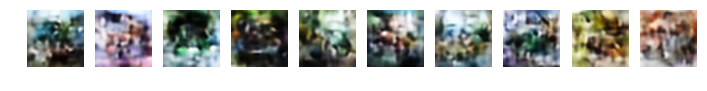

Epoch 1141 of 2000 took 35.53s;
train unlabelled reconstruction loss: 1693.64;
train labelled reconstruction loss: 1693.50; train labelled classification loss: 0.05; train accuracy: 0.992
test labelled reconstruction loss: 1704.39; test labelled classification loss: 1.40; test accuracy: 0.626
Epoch 1142 of 2000 took 35.27s;
train unlabelled reconstruction loss: 1693.71;
train labelled reconstruction loss: 1693.18; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1704.42; test labelled classification loss: 1.38; test accuracy: 0.625
Epoch 1143 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1693.68;
train labelled reconstruction loss: 1693.46; train labelled classification loss: 0.05; train accuracy: 0.990
test labelled reconstruction loss: 1704.31; test labelled classification loss: 1.40; test accuracy: 0.623
Epoch 1144 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1693.91;
train labelled reconstruction loss: 169

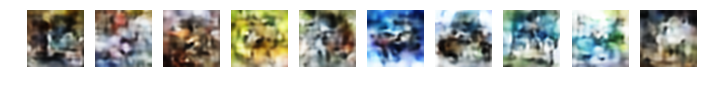

Epoch 1151 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1693.80;
train labelled reconstruction loss: 1693.52; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1703.95; test labelled classification loss: 1.39; test accuracy: 0.620
Epoch 1152 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1693.88;
train labelled reconstruction loss: 1693.43; train labelled classification loss: 0.05; train accuracy: 0.989
test labelled reconstruction loss: 1704.24; test labelled classification loss: 1.38; test accuracy: 0.624
Epoch 1153 of 2000 took 35.39s;
train unlabelled reconstruction loss: 1693.72;
train labelled reconstruction loss: 1693.14; train labelled classification loss: 0.05; train accuracy: 0.991
test labelled reconstruction loss: 1703.97; test labelled classification loss: 1.41; test accuracy: 0.620
Epoch 1154 of 2000 took 35.55s;
train unlabelled reconstruction loss: 1693.72;
train labelled reconstruction loss: 169

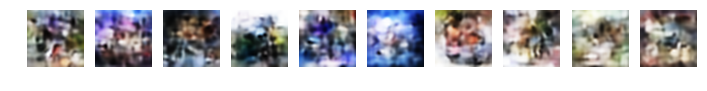

Epoch 1161 of 2000 took 35.43s;
train unlabelled reconstruction loss: 1693.69;
train labelled reconstruction loss: 1693.22; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1704.11; test labelled classification loss: 1.41; test accuracy: 0.619
Epoch 1162 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 1693.30; train labelled classification loss: 0.05; train accuracy: 0.992
test labelled reconstruction loss: 1704.49; test labelled classification loss: 1.43; test accuracy: 0.619
Epoch 1163 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 1693.51; train labelled classification loss: 0.04; train accuracy: 0.990
test labelled reconstruction loss: 1704.32; test labelled classification loss: 1.39; test accuracy: 0.625
Epoch 1164 of 2000 took 35.99s;
train unlabelled reconstruction loss: 1693.71;
train labelled reconstruction loss: 169

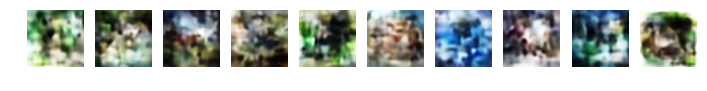

Epoch 1171 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1693.69;
train labelled reconstruction loss: 1693.21; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1704.43; test labelled classification loss: 1.41; test accuracy: 0.626
Epoch 1172 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1693.73;
train labelled reconstruction loss: 1693.57; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1704.53; test labelled classification loss: 1.39; test accuracy: 0.626
Epoch 1173 of 2000 took 35.24s;
train unlabelled reconstruction loss: 1693.86;
train labelled reconstruction loss: 1693.53; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1703.94; test labelled classification loss: 1.38; test accuracy: 0.631
Epoch 1174 of 2000 took 36.01s;
train unlabelled reconstruction loss: 1693.71;
train labelled reconstruction loss: 169

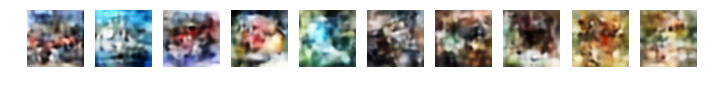

Epoch 1181 of 2000 took 34.94s;
train unlabelled reconstruction loss: 1693.67;
train labelled reconstruction loss: 1693.56; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1705.14; test labelled classification loss: 1.42; test accuracy: 0.621
Epoch 1182 of 2000 took 36.03s;
train unlabelled reconstruction loss: 1693.67;
train labelled reconstruction loss: 1693.50; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1704.50; test labelled classification loss: 1.39; test accuracy: 0.628
Epoch 1183 of 2000 took 36.09s;
train unlabelled reconstruction loss: 1693.73;
train labelled reconstruction loss: 1693.22; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1704.19; test labelled classification loss: 1.40; test accuracy: 0.620
Epoch 1184 of 2000 took 36.05s;
train unlabelled reconstruction loss: 1693.64;
train labelled reconstruction loss: 169

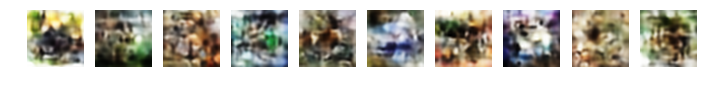

Epoch 1191 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1693.65;
train labelled reconstruction loss: 1693.57; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1704.22; test labelled classification loss: 1.42; test accuracy: 0.619
Epoch 1192 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1693.65;
train labelled reconstruction loss: 1693.31; train labelled classification loss: 0.04; train accuracy: 0.993
test labelled reconstruction loss: 1705.15; test labelled classification loss: 1.41; test accuracy: 0.630
Epoch 1193 of 2000 took 35.54s;
train unlabelled reconstruction loss: 1693.85;
train labelled reconstruction loss: 1693.55; train labelled classification loss: 0.04; train accuracy: 0.993
test labelled reconstruction loss: 1704.10; test labelled classification loss: 1.40; test accuracy: 0.634
Epoch 1194 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1693.69;
train labelled reconstruction loss: 169

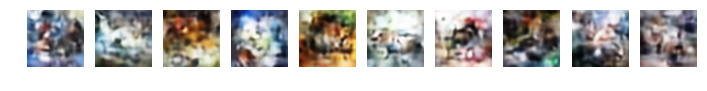

Epoch 1201 of 2000 took 35.41s;
train unlabelled reconstruction loss: 1693.74;
train labelled reconstruction loss: 1693.36; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1705.04; test labelled classification loss: 1.42; test accuracy: 0.626
Epoch 1202 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1693.66;
train labelled reconstruction loss: 1693.05; train labelled classification loss: 0.04; train accuracy: 0.993
test labelled reconstruction loss: 1704.20; test labelled classification loss: 1.41; test accuracy: 0.625
Epoch 1203 of 2000 took 35.71s;
train unlabelled reconstruction loss: 1693.77;
train labelled reconstruction loss: 1693.67; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1704.35; test labelled classification loss: 1.41; test accuracy: 0.625
Epoch 1204 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1693.55;
train labelled reconstruction loss: 169

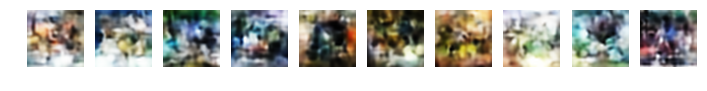

Epoch 1211 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1693.60;
train labelled reconstruction loss: 1693.31; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1704.78; test labelled classification loss: 1.42; test accuracy: 0.629
Epoch 1212 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 1693.39; train labelled classification loss: 0.04; train accuracy: 0.994
test labelled reconstruction loss: 1704.57; test labelled classification loss: 1.41; test accuracy: 0.629
Epoch 1213 of 2000 took 35.33s;
train unlabelled reconstruction loss: 1693.77;
train labelled reconstruction loss: 1693.61; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1705.44; test labelled classification loss: 1.43; test accuracy: 0.620
Epoch 1214 of 2000 took 35.56s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 169

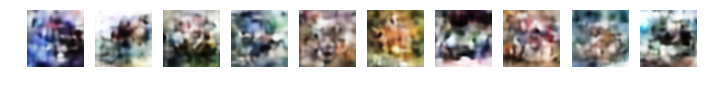

Epoch 1221 of 2000 took 34.59s;
train unlabelled reconstruction loss: 1693.69;
train labelled reconstruction loss: 1693.10; train labelled classification loss: 0.04; train accuracy: 0.991
test labelled reconstruction loss: 1704.30; test labelled classification loss: 1.44; test accuracy: 0.628
Epoch 1222 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1693.73;
train labelled reconstruction loss: 1693.19; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1704.17; test labelled classification loss: 1.42; test accuracy: 0.622
Epoch 1223 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1693.68;
train labelled reconstruction loss: 1693.18; train labelled classification loss: 0.04; train accuracy: 0.993
test labelled reconstruction loss: 1704.26; test labelled classification loss: 1.42; test accuracy: 0.628
Epoch 1224 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1693.68;
train labelled reconstruction loss: 169

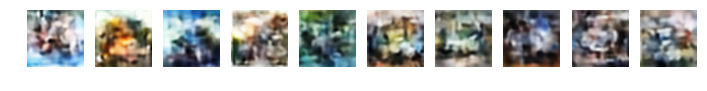

Epoch 1231 of 2000 took 35.64s;
train unlabelled reconstruction loss: 1693.70;
train labelled reconstruction loss: 1693.18; train labelled classification loss: 0.04; train accuracy: 0.994
test labelled reconstruction loss: 1704.64; test labelled classification loss: 1.44; test accuracy: 0.627
Epoch 1232 of 2000 took 35.41s;
train unlabelled reconstruction loss: 1693.66;
train labelled reconstruction loss: 1693.50; train labelled classification loss: 0.04; train accuracy: 0.993
test labelled reconstruction loss: 1704.40; test labelled classification loss: 1.41; test accuracy: 0.633
Epoch 1233 of 2000 took 35.00s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1693.77; train labelled classification loss: 0.04; train accuracy: 0.993
test labelled reconstruction loss: 1704.83; test labelled classification loss: 1.40; test accuracy: 0.635
Epoch 1234 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1693.70;
train labelled reconstruction loss: 169

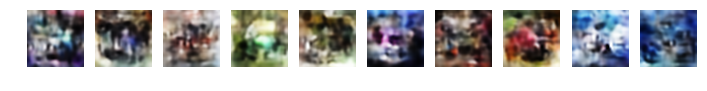

Epoch 1241 of 2000 took 35.45s;
train unlabelled reconstruction loss: 1694.01;
train labelled reconstruction loss: 1694.06; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.74; test labelled classification loss: 1.44; test accuracy: 0.623
Epoch 1242 of 2000 took 35.52s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 1693.22; train labelled classification loss: 0.03; train accuracy: 0.996
test labelled reconstruction loss: 1704.51; test labelled classification loss: 1.43; test accuracy: 0.623
Epoch 1243 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1693.73;
train labelled reconstruction loss: 1693.24; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1704.80; test labelled classification loss: 1.47; test accuracy: 0.624
Epoch 1244 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1693.78;
train labelled reconstruction loss: 169

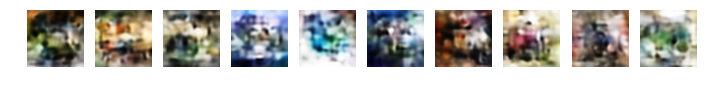

Epoch 1251 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1693.28; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1705.04; test labelled classification loss: 1.44; test accuracy: 0.633
Epoch 1252 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1693.76;
train labelled reconstruction loss: 1693.24; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1704.48; test labelled classification loss: 1.45; test accuracy: 0.629
Epoch 1253 of 2000 took 35.54s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1693.43; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1704.30; test labelled classification loss: 1.42; test accuracy: 0.628
Epoch 1254 of 2000 took 35.26s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 169

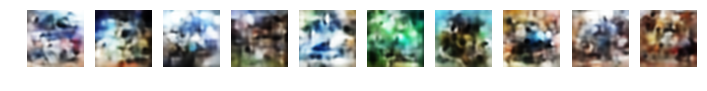

Epoch 1261 of 2000 took 35.42s;
train unlabelled reconstruction loss: 1693.70;
train labelled reconstruction loss: 1695.55; train labelled classification loss: 0.04; train accuracy: 0.993
test labelled reconstruction loss: 1705.96; test labelled classification loss: 1.44; test accuracy: 0.632
Epoch 1262 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1693.97;
train labelled reconstruction loss: 1693.11; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.38; test labelled classification loss: 1.42; test accuracy: 0.632
Epoch 1263 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1693.58;
train labelled reconstruction loss: 1693.25; train labelled classification loss: 0.04; train accuracy: 0.993
test labelled reconstruction loss: 1704.68; test labelled classification loss: 1.46; test accuracy: 0.626
Epoch 1264 of 2000 took 35.59s;
train unlabelled reconstruction loss: 1693.56;
train labelled reconstruction loss: 169

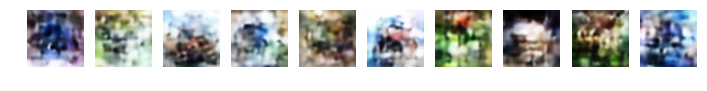

Epoch 1271 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1693.62;
train labelled reconstruction loss: 1693.27; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1704.62; test labelled classification loss: 1.43; test accuracy: 0.629
Epoch 1272 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1693.83;
train labelled reconstruction loss: 1693.33; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1705.24; test labelled classification loss: 1.45; test accuracy: 0.625
Epoch 1273 of 2000 took 35.26s;
train unlabelled reconstruction loss: 1693.68;
train labelled reconstruction loss: 1693.17; train labelled classification loss: 0.04; train accuracy: 0.990
test labelled reconstruction loss: 1704.76; test labelled classification loss: 1.50; test accuracy: 0.621
Epoch 1274 of 2000 took 35.69s;
train unlabelled reconstruction loss: 1693.66;
train labelled reconstruction loss: 169

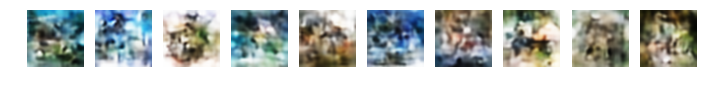

Epoch 1281 of 2000 took 35.18s;
train unlabelled reconstruction loss: 1693.62;
train labelled reconstruction loss: 1693.40; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1704.17; test labelled classification loss: 1.43; test accuracy: 0.625
Epoch 1282 of 2000 took 35.75s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1693.12; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.67; test labelled classification loss: 1.43; test accuracy: 0.630
Epoch 1283 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1693.78;
train labelled reconstruction loss: 1693.58; train labelled classification loss: 0.04; train accuracy: 0.992
test labelled reconstruction loss: 1704.59; test labelled classification loss: 1.40; test accuracy: 0.630
Epoch 1284 of 2000 took 35.69s;
train unlabelled reconstruction loss: 1693.76;
train labelled reconstruction loss: 169

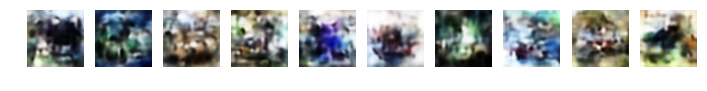

Epoch 1291 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1693.75;
train labelled reconstruction loss: 1693.30; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1705.02; test labelled classification loss: 1.42; test accuracy: 0.631
Epoch 1292 of 2000 took 35.74s;
train unlabelled reconstruction loss: 1693.63;
train labelled reconstruction loss: 1693.33; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1704.73; test labelled classification loss: 1.45; test accuracy: 0.633
Epoch 1293 of 2000 took 35.12s;
train unlabelled reconstruction loss: 1693.64;
train labelled reconstruction loss: 1693.14; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1704.88; test labelled classification loss: 1.44; test accuracy: 0.630
Epoch 1294 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1693.64;
train labelled reconstruction loss: 169

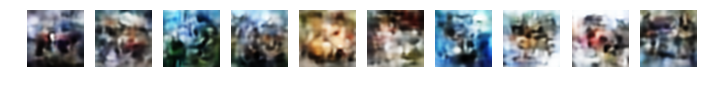

Epoch 1301 of 2000 took 34.92s;
train unlabelled reconstruction loss: 1693.71;
train labelled reconstruction loss: 1693.24; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1704.54; test labelled classification loss: 1.43; test accuracy: 0.626
Epoch 1302 of 2000 took 36.00s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 1693.47; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.28; test labelled classification loss: 1.45; test accuracy: 0.633
Epoch 1303 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1693.70;
train labelled reconstruction loss: 1693.26; train labelled classification loss: 0.03; train accuracy: 0.992
test labelled reconstruction loss: 1704.65; test labelled classification loss: 1.43; test accuracy: 0.632
Epoch 1304 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1693.76;
train labelled reconstruction loss: 169

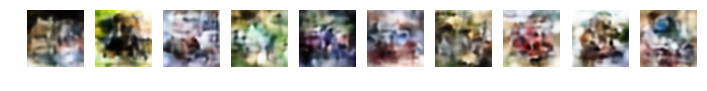

Epoch 1311 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1693.75;
train labelled reconstruction loss: 1693.20; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1705.00; test labelled classification loss: 1.48; test accuracy: 0.624
Epoch 1312 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.22; train labelled classification loss: 0.03; train accuracy: 0.996
test labelled reconstruction loss: 1704.20; test labelled classification loss: 1.46; test accuracy: 0.629
Epoch 1313 of 2000 took 35.59s;
train unlabelled reconstruction loss: 1693.96;
train labelled reconstruction loss: 1693.29; train labelled classification loss: 0.03; train accuracy: 0.996
test labelled reconstruction loss: 1704.75; test labelled classification loss: 1.45; test accuracy: 0.626
Epoch 1314 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1693.63;
train labelled reconstruction loss: 169

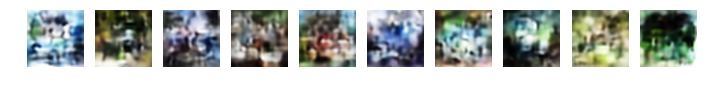

Epoch 1321 of 2000 took 35.43s;
train unlabelled reconstruction loss: 1694.00;
train labelled reconstruction loss: 1693.79; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1704.99; test labelled classification loss: 1.47; test accuracy: 0.628
Epoch 1322 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1693.58;
train labelled reconstruction loss: 1693.05; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.36; test labelled classification loss: 1.46; test accuracy: 0.630
Epoch 1323 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1693.80;
train labelled reconstruction loss: 1693.25; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.47; test labelled classification loss: 1.47; test accuracy: 0.629
Epoch 1324 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1693.55;
train labelled reconstruction loss: 169

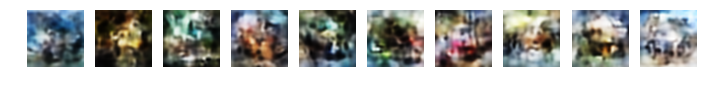

Epoch 1331 of 2000 took 35.90s;
train unlabelled reconstruction loss: 1693.65;
train labelled reconstruction loss: 1692.90; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1704.56; test labelled classification loss: 1.44; test accuracy: 0.631
Epoch 1332 of 2000 took 35.52s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1693.01; train labelled classification loss: 0.04; train accuracy: 0.990
test labelled reconstruction loss: 1704.59; test labelled classification loss: 1.45; test accuracy: 0.634
Epoch 1333 of 2000 took 35.35s;
train unlabelled reconstruction loss: 1693.53;
train labelled reconstruction loss: 1693.24; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1704.77; test labelled classification loss: 1.47; test accuracy: 0.629
Epoch 1334 of 2000 took 35.75s;
train unlabelled reconstruction loss: 1693.56;
train labelled reconstruction loss: 169

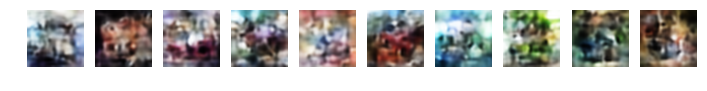

Epoch 1341 of 2000 took 35.33s;
train unlabelled reconstruction loss: 1693.60;
train labelled reconstruction loss: 1693.24; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.40; test labelled classification loss: 1.44; test accuracy: 0.622
Epoch 1342 of 2000 took 35.84s;
train unlabelled reconstruction loss: 1693.69;
train labelled reconstruction loss: 1693.33; train labelled classification loss: 0.03; train accuracy: 0.996
test labelled reconstruction loss: 1704.50; test labelled classification loss: 1.44; test accuracy: 0.630
Epoch 1343 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1693.64;
train labelled reconstruction loss: 1693.17; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1704.31; test labelled classification loss: 1.42; test accuracy: 0.634
Epoch 1344 of 2000 took 35.50s;
train unlabelled reconstruction loss: 1693.53;
train labelled reconstruction loss: 169

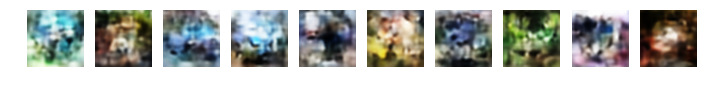

Epoch 1351 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1693.62;
train labelled reconstruction loss: 1693.37; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.80; test labelled classification loss: 1.43; test accuracy: 0.633
Epoch 1352 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1693.88;
train labelled reconstruction loss: 1693.06; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1704.74; test labelled classification loss: 1.45; test accuracy: 0.629
Epoch 1353 of 2000 took 35.38s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.25; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.21; test labelled classification loss: 1.47; test accuracy: 0.624
Epoch 1354 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1693.70;
train labelled reconstruction loss: 169

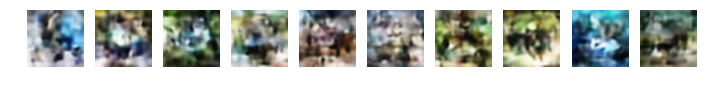

Epoch 1361 of 2000 took 35.31s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1693.27; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.78; test labelled classification loss: 1.45; test accuracy: 0.635
Epoch 1362 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1693.57;
train labelled reconstruction loss: 1693.45; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1704.69; test labelled classification loss: 1.47; test accuracy: 0.631
Epoch 1363 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1693.54;
train labelled reconstruction loss: 1693.16; train labelled classification loss: 0.03; train accuracy: 0.991
test labelled reconstruction loss: 1704.42; test labelled classification loss: 1.49; test accuracy: 0.629
Epoch 1364 of 2000 took 35.73s;
train unlabelled reconstruction loss: 1693.56;
train labelled reconstruction loss: 169

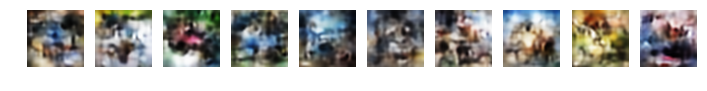

Epoch 1371 of 2000 took 35.74s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 1693.13; train labelled classification loss: 0.03; train accuracy: 0.992
test labelled reconstruction loss: 1704.41; test labelled classification loss: 1.45; test accuracy: 0.627
Epoch 1372 of 2000 took 35.71s;
train unlabelled reconstruction loss: 1693.58;
train labelled reconstruction loss: 1693.72; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1704.66; test labelled classification loss: 1.48; test accuracy: 0.633
Epoch 1373 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1693.54;
train labelled reconstruction loss: 1693.10; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1705.09; test labelled classification loss: 1.45; test accuracy: 0.629
Epoch 1374 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1693.42;
train labelled reconstruction loss: 169

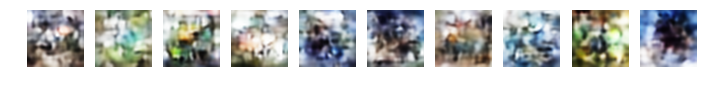

Epoch 1381 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1693.59;
train labelled reconstruction loss: 1693.66; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.50; test labelled classification loss: 1.45; test accuracy: 0.634
Epoch 1382 of 2000 took 35.60s;
train unlabelled reconstruction loss: 1693.54;
train labelled reconstruction loss: 1693.19; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.70; test labelled classification loss: 1.47; test accuracy: 0.631
Epoch 1383 of 2000 took 35.14s;
train unlabelled reconstruction loss: 1693.54;
train labelled reconstruction loss: 1693.13; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.65; test labelled classification loss: 1.47; test accuracy: 0.622
Epoch 1384 of 2000 took 35.44s;
train unlabelled reconstruction loss: 1693.60;
train labelled reconstruction loss: 169

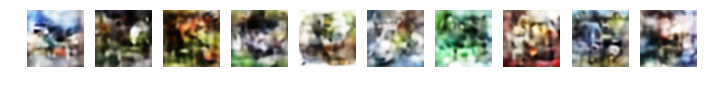

Epoch 1391 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1693.01; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.71; test labelled classification loss: 1.45; test accuracy: 0.630
Epoch 1392 of 2000 took 35.48s;
train unlabelled reconstruction loss: 1693.56;
train labelled reconstruction loss: 1693.30; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1705.21; test labelled classification loss: 1.49; test accuracy: 0.627
Epoch 1393 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1693.44;
train labelled reconstruction loss: 1693.31; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1704.87; test labelled classification loss: 1.47; test accuracy: 0.633
Epoch 1394 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1693.44;
train labelled reconstruction loss: 169

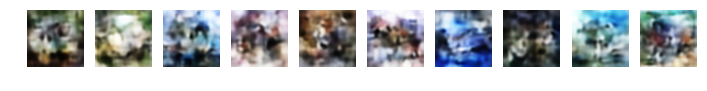

Epoch 1401 of 2000 took 35.89s;
train unlabelled reconstruction loss: 1693.66;
train labelled reconstruction loss: 1693.47; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.95; test labelled classification loss: 1.49; test accuracy: 0.630
Epoch 1402 of 2000 took 35.56s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.07; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1704.65; test labelled classification loss: 1.46; test accuracy: 0.640
Epoch 1403 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1693.59;
train labelled reconstruction loss: 1693.11; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.49; test labelled classification loss: 1.46; test accuracy: 0.629
Epoch 1404 of 2000 took 35.36s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 169

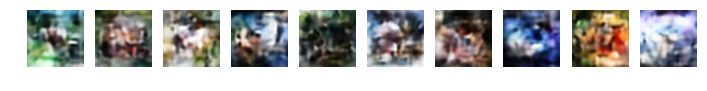

Epoch 1411 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1693.52;
train labelled reconstruction loss: 1693.10; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1704.49; test labelled classification loss: 1.47; test accuracy: 0.628
Epoch 1412 of 2000 took 35.35s;
train unlabelled reconstruction loss: 1693.81;
train labelled reconstruction loss: 1694.16; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1705.19; test labelled classification loss: 1.45; test accuracy: 0.631
Epoch 1413 of 2000 took 35.65s;
train unlabelled reconstruction loss: 1693.52;
train labelled reconstruction loss: 1693.11; train labelled classification loss: 0.03; train accuracy: 0.995
test labelled reconstruction loss: 1704.65; test labelled classification loss: 1.51; test accuracy: 0.627
Epoch 1414 of 2000 took 35.45s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 169

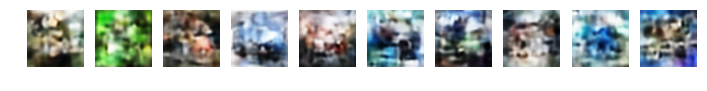

Epoch 1421 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1693.36;
train labelled reconstruction loss: 1693.20; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.19; test labelled classification loss: 1.48; test accuracy: 0.634
Epoch 1422 of 2000 took 35.56s;
train unlabelled reconstruction loss: 1693.60;
train labelled reconstruction loss: 1693.40; train labelled classification loss: 0.03; train accuracy: 0.996
test labelled reconstruction loss: 1705.00; test labelled classification loss: 1.50; test accuracy: 0.629
Epoch 1423 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1693.60;
train labelled reconstruction loss: 1693.25; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1705.18; test labelled classification loss: 1.53; test accuracy: 0.628
Epoch 1424 of 2000 took 35.29s;
train unlabelled reconstruction loss: 1693.48;
train labelled reconstruction loss: 169

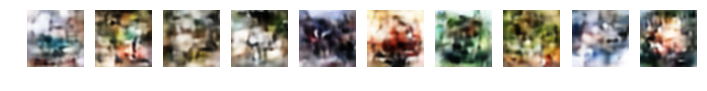

Epoch 1431 of 2000 took 35.60s;
train unlabelled reconstruction loss: 1693.49;
train labelled reconstruction loss: 1693.35; train labelled classification loss: 0.03; train accuracy: 0.994
test labelled reconstruction loss: 1705.57; test labelled classification loss: 1.50; test accuracy: 0.631
Epoch 1432 of 2000 took 35.54s;
train unlabelled reconstruction loss: 1693.48;
train labelled reconstruction loss: 1693.45; train labelled classification loss: 0.02; train accuracy: 0.994
test labelled reconstruction loss: 1705.36; test labelled classification loss: 1.48; test accuracy: 0.631
Epoch 1433 of 2000 took 35.93s;
train unlabelled reconstruction loss: 1693.65;
train labelled reconstruction loss: 1693.03; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.23; test labelled classification loss: 1.49; test accuracy: 0.634
Epoch 1434 of 2000 took 35.76s;
train unlabelled reconstruction loss: 1693.58;
train labelled reconstruction loss: 169

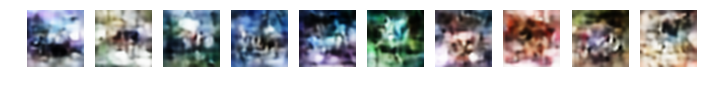

Epoch 1441 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1693.55;
train labelled reconstruction loss: 1693.10; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1704.64; test labelled classification loss: 1.46; test accuracy: 0.635
Epoch 1442 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1693.56;
train labelled reconstruction loss: 1693.38; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1705.24; test labelled classification loss: 1.47; test accuracy: 0.641
Epoch 1443 of 2000 took 35.62s;
train unlabelled reconstruction loss: 1693.59;
train labelled reconstruction loss: 1693.02; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.93; test labelled classification loss: 1.49; test accuracy: 0.633
Epoch 1444 of 2000 took 35.09s;
train unlabelled reconstruction loss: 1693.74;
train labelled reconstruction loss: 169

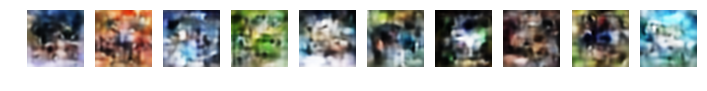

Epoch 1451 of 2000 took 35.46s;
train unlabelled reconstruction loss: 1693.51;
train labelled reconstruction loss: 1693.13; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1704.40; test labelled classification loss: 1.48; test accuracy: 0.633
Epoch 1452 of 2000 took 35.64s;
train unlabelled reconstruction loss: 1693.53;
train labelled reconstruction loss: 1693.31; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.82; test labelled classification loss: 1.49; test accuracy: 0.630
Epoch 1453 of 2000 took 35.97s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1693.09; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1705.25; test labelled classification loss: 1.49; test accuracy: 0.632
Epoch 1454 of 2000 took 35.78s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 169

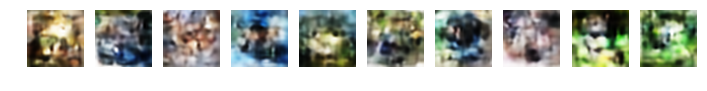

Epoch 1461 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1693.55;
train labelled reconstruction loss: 1692.98; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.31; test labelled classification loss: 1.47; test accuracy: 0.633
Epoch 1462 of 2000 took 35.48s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.37; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1705.36; test labelled classification loss: 1.48; test accuracy: 0.633
Epoch 1463 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1693.02; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1704.39; test labelled classification loss: 1.47; test accuracy: 0.633
Epoch 1464 of 2000 took 35.54s;
train unlabelled reconstruction loss: 1693.40;
train labelled reconstruction loss: 169

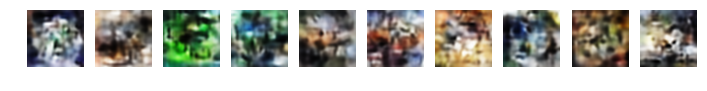

Epoch 1471 of 2000 took 36.12s;
train unlabelled reconstruction loss: 1693.52;
train labelled reconstruction loss: 1693.43; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.00; test labelled classification loss: 1.50; test accuracy: 0.634
Epoch 1472 of 2000 took 35.47s;
train unlabelled reconstruction loss: 1693.57;
train labelled reconstruction loss: 1693.21; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.20; test labelled classification loss: 1.45; test accuracy: 0.638
Epoch 1473 of 2000 took 36.02s;
train unlabelled reconstruction loss: 1693.60;
train labelled reconstruction loss: 1693.05; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1704.28; test labelled classification loss: 1.51; test accuracy: 0.632
Epoch 1474 of 2000 took 36.10s;
train unlabelled reconstruction loss: 1693.51;
train labelled reconstruction loss: 169

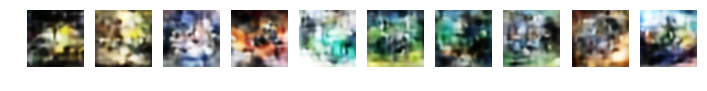

Epoch 1481 of 2000 took 35.87s;
train unlabelled reconstruction loss: 1693.62;
train labelled reconstruction loss: 1692.97; train labelled classification loss: 0.02; train accuracy: 0.998
test labelled reconstruction loss: 1704.77; test labelled classification loss: 1.53; test accuracy: 0.636
Epoch 1482 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1694.94;
train labelled reconstruction loss: 1693.07; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1705.25; test labelled classification loss: 1.47; test accuracy: 0.636
Epoch 1483 of 2000 took 35.58s;
train unlabelled reconstruction loss: 1693.68;
train labelled reconstruction loss: 1693.24; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.51; test labelled classification loss: 1.46; test accuracy: 0.634
Epoch 1484 of 2000 took 35.59s;
train unlabelled reconstruction loss: 1693.58;
train labelled reconstruction loss: 169

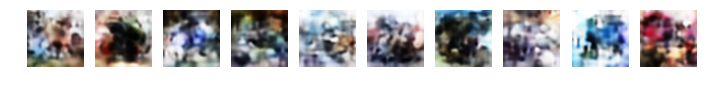

Epoch 1491 of 2000 took 35.24s;
train unlabelled reconstruction loss: 1693.82;
train labelled reconstruction loss: 1693.06; train labelled classification loss: 0.03; train accuracy: 0.993
test labelled reconstruction loss: 1704.93; test labelled classification loss: 1.48; test accuracy: 0.631
Epoch 1492 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1693.44;
train labelled reconstruction loss: 1693.37; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1704.63; test labelled classification loss: 1.48; test accuracy: 0.635
Epoch 1493 of 2000 took 35.21s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.08; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1705.10; test labelled classification loss: 1.50; test accuracy: 0.634
Epoch 1494 of 2000 took 35.52s;
train unlabelled reconstruction loss: 1693.48;
train labelled reconstruction loss: 169

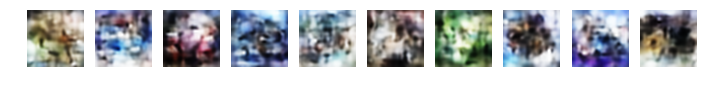

Epoch 1501 of 2000 took 35.79s;
train unlabelled reconstruction loss: 1693.58;
train labelled reconstruction loss: 1693.16; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1704.53; test labelled classification loss: 1.48; test accuracy: 0.639
Epoch 1502 of 2000 took 35.66s;
train unlabelled reconstruction loss: 1693.24;
train labelled reconstruction loss: 1692.89; train labelled classification loss: 0.02; train accuracy: 0.994
test labelled reconstruction loss: 1704.82; test labelled classification loss: 1.51; test accuracy: 0.631
Epoch 1503 of 2000 took 35.34s;
train unlabelled reconstruction loss: 1693.63;
train labelled reconstruction loss: 1692.83; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.61; test labelled classification loss: 1.53; test accuracy: 0.628
Epoch 1504 of 2000 took 35.53s;
train unlabelled reconstruction loss: 1693.35;
train labelled reconstruction loss: 169

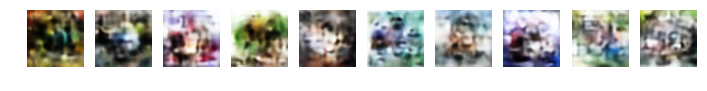

Epoch 1511 of 2000 took 35.67s;
train unlabelled reconstruction loss: 1693.42;
train labelled reconstruction loss: 1692.95; train labelled classification loss: 0.02; train accuracy: 0.994
test labelled reconstruction loss: 1705.03; test labelled classification loss: 1.52; test accuracy: 0.629
Epoch 1512 of 2000 took 35.19s;
train unlabelled reconstruction loss: 1693.60;
train labelled reconstruction loss: 1693.66; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.42; test labelled classification loss: 1.49; test accuracy: 0.630
Epoch 1513 of 2000 took 35.88s;
train unlabelled reconstruction loss: 1693.53;
train labelled reconstruction loss: 1693.21; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1704.67; test labelled classification loss: 1.50; test accuracy: 0.629
Epoch 1514 of 2000 took 35.72s;
train unlabelled reconstruction loss: 1693.42;
train labelled reconstruction loss: 169

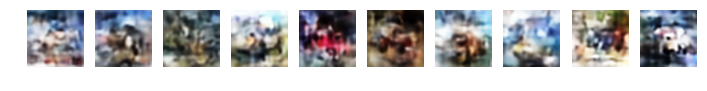

Epoch 1521 of 2000 took 35.95s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.41; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.12; test labelled classification loss: 1.53; test accuracy: 0.629
Epoch 1522 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1693.73;
train labelled reconstruction loss: 1693.16; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1704.67; test labelled classification loss: 1.51; test accuracy: 0.631
Epoch 1523 of 2000 took 35.98s;
train unlabelled reconstruction loss: 1693.33;
train labelled reconstruction loss: 1693.08; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1705.37; test labelled classification loss: 1.54; test accuracy: 0.627
Epoch 1524 of 2000 took 34.93s;
train unlabelled reconstruction loss: 1693.79;
train labelled reconstruction loss: 169

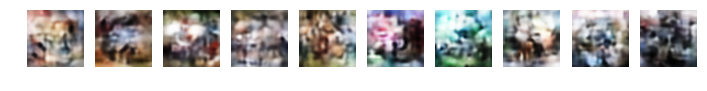

Epoch 1531 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1693.40;
train labelled reconstruction loss: 1693.14; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1705.21; test labelled classification loss: 1.52; test accuracy: 0.634
Epoch 1532 of 2000 took 35.48s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.03; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1704.58; test labelled classification loss: 1.53; test accuracy: 0.636
Epoch 1533 of 2000 took 35.42s;
train unlabelled reconstruction loss: 1693.54;
train labelled reconstruction loss: 1693.36; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.94; test labelled classification loss: 1.54; test accuracy: 0.628
Epoch 1534 of 2000 took 35.71s;
train unlabelled reconstruction loss: 1693.32;
train labelled reconstruction loss: 169

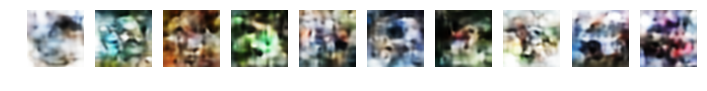

Epoch 1541 of 2000 took 35.95s;
train unlabelled reconstruction loss: 1693.42;
train labelled reconstruction loss: 1693.23; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1705.14; test labelled classification loss: 1.50; test accuracy: 0.637
Epoch 1542 of 2000 took 35.60s;
train unlabelled reconstruction loss: 1693.65;
train labelled reconstruction loss: 1692.98; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1704.71; test labelled classification loss: 1.54; test accuracy: 0.629
Epoch 1543 of 2000 took 35.97s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.45; train labelled classification loss: 0.02; train accuracy: 0.998
test labelled reconstruction loss: 1704.42; test labelled classification loss: 1.54; test accuracy: 0.635
Epoch 1544 of 2000 took 35.26s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 169

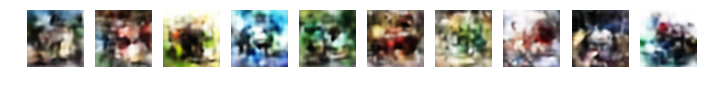

Epoch 1551 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1692.87; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.81; test labelled classification loss: 1.52; test accuracy: 0.638
Epoch 1552 of 2000 took 35.27s;
train unlabelled reconstruction loss: 1693.33;
train labelled reconstruction loss: 1693.42; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.97; test labelled classification loss: 1.49; test accuracy: 0.638
Epoch 1553 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1693.63;
train labelled reconstruction loss: 1693.66; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.57; test labelled classification loss: 1.52; test accuracy: 0.634
Epoch 1554 of 2000 took 35.80s;
train unlabelled reconstruction loss: 1693.52;
train labelled reconstruction loss: 169

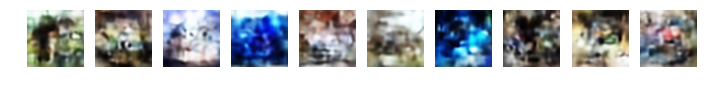

Epoch 1561 of 2000 took 35.91s;
train unlabelled reconstruction loss: 1693.48;
train labelled reconstruction loss: 1693.34; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1704.58; test labelled classification loss: 1.51; test accuracy: 0.633
Epoch 1562 of 2000 took 35.83s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.35; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.44; test labelled classification loss: 1.49; test accuracy: 0.640
Epoch 1563 of 2000 took 35.86s;
train unlabelled reconstruction loss: 1693.51;
train labelled reconstruction loss: 1693.20; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.94; test labelled classification loss: 1.54; test accuracy: 0.632
Epoch 1564 of 2000 took 35.37s;
train unlabelled reconstruction loss: 1693.72;
train labelled reconstruction loss: 169

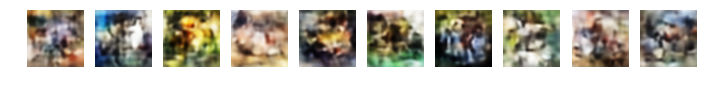

Epoch 1571 of 2000 took 35.75s;
train unlabelled reconstruction loss: 1693.37;
train labelled reconstruction loss: 1692.99; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1704.80; test labelled classification loss: 1.52; test accuracy: 0.636
Epoch 1572 of 2000 took 35.05s;
train unlabelled reconstruction loss: 1693.43;
train labelled reconstruction loss: 1693.39; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.64; test labelled classification loss: 1.53; test accuracy: 0.638
Epoch 1573 of 2000 took 35.77s;
train unlabelled reconstruction loss: 1693.41;
train labelled reconstruction loss: 1693.04; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.91; test labelled classification loss: 1.53; test accuracy: 0.633
Epoch 1574 of 2000 took 35.28s;
train unlabelled reconstruction loss: 1693.40;
train labelled reconstruction loss: 169

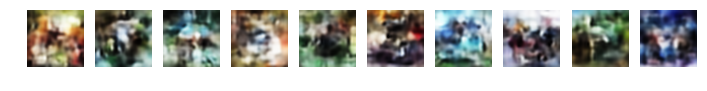

Epoch 1581 of 2000 took 35.85s;
train unlabelled reconstruction loss: 1693.32;
train labelled reconstruction loss: 1693.13; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.95; test labelled classification loss: 1.51; test accuracy: 0.633
Epoch 1582 of 2000 took 35.68s;
train unlabelled reconstruction loss: 1693.33;
train labelled reconstruction loss: 1692.87; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.52; test labelled classification loss: 1.52; test accuracy: 0.636
Epoch 1583 of 2000 took 35.70s;
train unlabelled reconstruction loss: 1693.42;
train labelled reconstruction loss: 1693.23; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.76; test labelled classification loss: 1.52; test accuracy: 0.633
Epoch 1584 of 2000 took 35.42s;
train unlabelled reconstruction loss: 1693.30;
train labelled reconstruction loss: 169

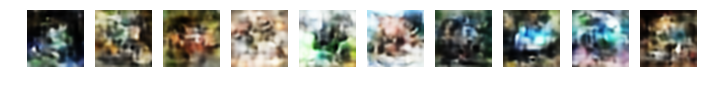

Epoch 1591 of 2000 took 36.03s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 1693.13; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1704.66; test labelled classification loss: 1.55; test accuracy: 0.629
Epoch 1592 of 2000 took 35.15s;
train unlabelled reconstruction loss: 1693.33;
train labelled reconstruction loss: 1693.15; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.79; test labelled classification loss: 1.52; test accuracy: 0.640
Epoch 1593 of 2000 took 35.92s;
train unlabelled reconstruction loss: 1693.36;
train labelled reconstruction loss: 1693.07; train labelled classification loss: 0.02; train accuracy: 0.994
test labelled reconstruction loss: 1705.23; test labelled classification loss: 1.54; test accuracy: 0.630
Epoch 1594 of 2000 took 35.81s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 169

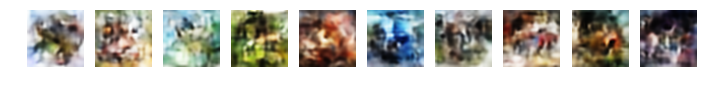

Epoch 1601 of 2000 took 35.90s;
train unlabelled reconstruction loss: 1693.92;
train labelled reconstruction loss: 1693.18; train labelled classification loss: 0.02; train accuracy: 0.998
test labelled reconstruction loss: 1704.64; test labelled classification loss: 1.56; test accuracy: 0.638
Epoch 1602 of 2000 took 35.82s;
train unlabelled reconstruction loss: 1693.38;
train labelled reconstruction loss: 1693.01; train labelled classification loss: 0.02; train accuracy: 0.998
test labelled reconstruction loss: 1705.30; test labelled classification loss: 1.54; test accuracy: 0.639
Epoch 1603 of 2000 took 35.97s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1692.90; train labelled classification loss: 0.02; train accuracy: 0.998
test labelled reconstruction loss: 1705.44; test labelled classification loss: 1.50; test accuracy: 0.646
Epoch 1604 of 2000 took 35.29s;
train unlabelled reconstruction loss: 1693.88;
train labelled reconstruction loss: 169

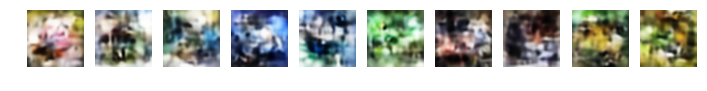

Epoch 1611 of 2000 took 22.73s;
train unlabelled reconstruction loss: 1693.34;
train labelled reconstruction loss: 1693.38; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.19; test labelled classification loss: 1.51; test accuracy: 0.636
Epoch 1612 of 2000 took 22.62s;
train unlabelled reconstruction loss: 1693.54;
train labelled reconstruction loss: 1693.14; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1704.93; test labelled classification loss: 1.54; test accuracy: 0.636
Epoch 1613 of 2000 took 22.61s;
train unlabelled reconstruction loss: 1693.53;
train labelled reconstruction loss: 1695.38; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.30; test labelled classification loss: 1.55; test accuracy: 0.632
Epoch 1614 of 2000 took 22.60s;
train unlabelled reconstruction loss: 1693.87;
train labelled reconstruction loss: 169

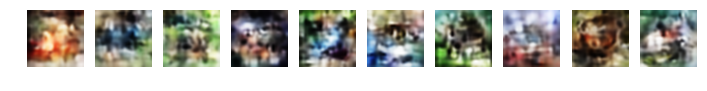

Epoch 1621 of 2000 took 22.80s;
train unlabelled reconstruction loss: 1693.22;
train labelled reconstruction loss: 1693.16; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1705.10; test labelled classification loss: 1.53; test accuracy: 0.636
Epoch 1622 of 2000 took 22.74s;
train unlabelled reconstruction loss: 1693.33;
train labelled reconstruction loss: 1693.16; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.05; test labelled classification loss: 1.53; test accuracy: 0.635
Epoch 1623 of 2000 took 22.61s;
train unlabelled reconstruction loss: 1693.28;
train labelled reconstruction loss: 1692.93; train labelled classification loss: 0.01; train accuracy: 0.999
test labelled reconstruction loss: 1704.89; test labelled classification loss: 1.53; test accuracy: 0.630
Epoch 1624 of 2000 took 22.69s;
train unlabelled reconstruction loss: 1693.22;
train labelled reconstruction loss: 169

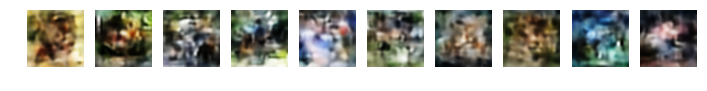

Epoch 1631 of 2000 took 22.68s;
train unlabelled reconstruction loss: 1693.41;
train labelled reconstruction loss: 1692.97; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.18; test labelled classification loss: 1.58; test accuracy: 0.633
Epoch 1632 of 2000 took 22.71s;
train unlabelled reconstruction loss: 1693.86;
train labelled reconstruction loss: 1693.19; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.54; test labelled classification loss: 1.54; test accuracy: 0.640
Epoch 1633 of 2000 took 22.80s;
train unlabelled reconstruction loss: 1693.43;
train labelled reconstruction loss: 1693.35; train labelled classification loss: 0.02; train accuracy: 0.995
test labelled reconstruction loss: 1704.66; test labelled classification loss: 1.56; test accuracy: 0.627
Epoch 1634 of 2000 took 22.84s;
train unlabelled reconstruction loss: 1693.35;
train labelled reconstruction loss: 169

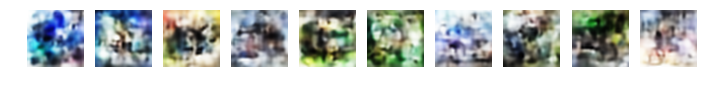

Epoch 1641 of 2000 took 22.81s;
train unlabelled reconstruction loss: 1693.45;
train labelled reconstruction loss: 1693.22; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.69; test labelled classification loss: 1.55; test accuracy: 0.639
Epoch 1642 of 2000 took 22.80s;
train unlabelled reconstruction loss: 1693.37;
train labelled reconstruction loss: 1692.92; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1705.31; test labelled classification loss: 1.57; test accuracy: 0.635
Epoch 1643 of 2000 took 22.57s;
train unlabelled reconstruction loss: 1693.63;
train labelled reconstruction loss: 1693.04; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.55; test labelled classification loss: 1.56; test accuracy: 0.635
Epoch 1644 of 2000 took 22.58s;
train unlabelled reconstruction loss: 1693.40;
train labelled reconstruction loss: 169

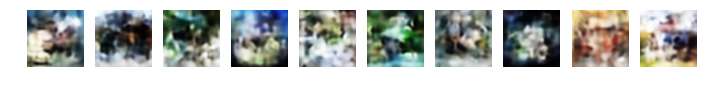

Epoch 1651 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1694.02;
train labelled reconstruction loss: 1692.90; train labelled classification loss: 0.02; train accuracy: 0.994
test labelled reconstruction loss: 1704.71; test labelled classification loss: 1.51; test accuracy: 0.636
Epoch 1652 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1693.41;
train labelled reconstruction loss: 1693.16; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.92; test labelled classification loss: 1.57; test accuracy: 0.632
Epoch 1653 of 2000 took 22.57s;
train unlabelled reconstruction loss: 1693.35;
train labelled reconstruction loss: 1692.97; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.38; test labelled classification loss: 1.55; test accuracy: 0.639
Epoch 1654 of 2000 took 22.49s;
train unlabelled reconstruction loss: 1693.34;
train labelled reconstruction loss: 169

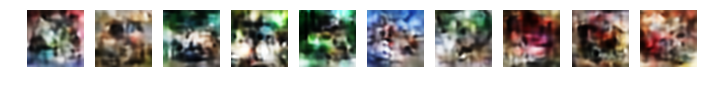

Epoch 1661 of 2000 took 22.82s;
train unlabelled reconstruction loss: 1693.43;
train labelled reconstruction loss: 1692.87; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.62; test labelled classification loss: 1.62; test accuracy: 0.625
Epoch 1662 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.32;
train labelled reconstruction loss: 1693.06; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.00; test labelled classification loss: 1.55; test accuracy: 0.632
Epoch 1663 of 2000 took 22.65s;
train unlabelled reconstruction loss: 1693.59;
train labelled reconstruction loss: 1693.25; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1704.86; test labelled classification loss: 1.54; test accuracy: 0.640
Epoch 1664 of 2000 took 22.64s;
train unlabelled reconstruction loss: 1694.15;
train labelled reconstruction loss: 169

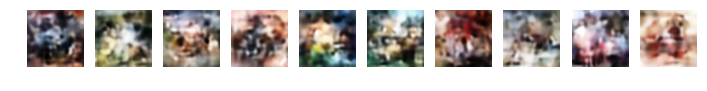

Epoch 1671 of 2000 took 22.86s;
train unlabelled reconstruction loss: 1693.38;
train labelled reconstruction loss: 1693.11; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1706.18; test labelled classification loss: 1.56; test accuracy: 0.635
Epoch 1672 of 2000 took 22.86s;
train unlabelled reconstruction loss: 1693.46;
train labelled reconstruction loss: 1692.63; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.99; test labelled classification loss: 1.59; test accuracy: 0.631
Epoch 1673 of 2000 took 22.80s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 1692.70; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.97; test labelled classification loss: 1.58; test accuracy: 0.633
Epoch 1674 of 2000 took 22.77s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 169

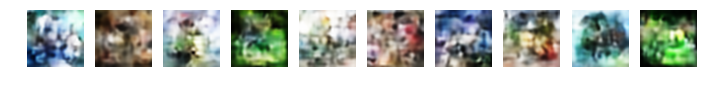

Epoch 1681 of 2000 took 22.82s;
train unlabelled reconstruction loss: 1693.49;
train labelled reconstruction loss: 1692.81; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.91; test labelled classification loss: 1.54; test accuracy: 0.639
Epoch 1682 of 2000 took 23.05s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 1692.70; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.49; test labelled classification loss: 1.57; test accuracy: 0.632
Epoch 1683 of 2000 took 22.84s;
train unlabelled reconstruction loss: 1693.42;
train labelled reconstruction loss: 1693.07; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1704.85; test labelled classification loss: 1.54; test accuracy: 0.641
Epoch 1684 of 2000 took 22.75s;
train unlabelled reconstruction loss: 1693.38;
train labelled reconstruction loss: 169

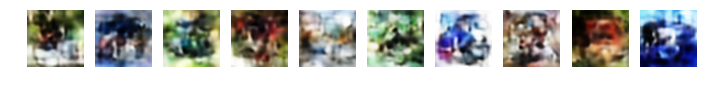

Epoch 1691 of 2000 took 22.58s;
train unlabelled reconstruction loss: 1693.49;
train labelled reconstruction loss: 1693.05; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.28; test labelled classification loss: 1.60; test accuracy: 0.630
Epoch 1692 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.37;
train labelled reconstruction loss: 1693.26; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.10; test labelled classification loss: 1.59; test accuracy: 0.631
Epoch 1693 of 2000 took 22.52s;
train unlabelled reconstruction loss: 1693.72;
train labelled reconstruction loss: 1692.87; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.18; test labelled classification loss: 1.58; test accuracy: 0.637
Epoch 1694 of 2000 took 22.59s;
train unlabelled reconstruction loss: 1693.38;
train labelled reconstruction loss: 169

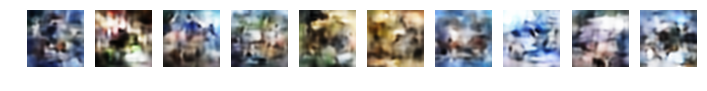

Epoch 1701 of 2000 took 22.77s;
train unlabelled reconstruction loss: 1693.93;
train labelled reconstruction loss: 1693.12; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.77; test labelled classification loss: 1.58; test accuracy: 0.639
Epoch 1702 of 2000 took 22.81s;
train unlabelled reconstruction loss: 1693.50;
train labelled reconstruction loss: 1693.14; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.22; test labelled classification loss: 1.59; test accuracy: 0.634
Epoch 1703 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1693.61;
train labelled reconstruction loss: 1692.90; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.93; test labelled classification loss: 1.59; test accuracy: 0.635
Epoch 1704 of 2000 took 22.78s;
train unlabelled reconstruction loss: 1693.38;
train labelled reconstruction loss: 169

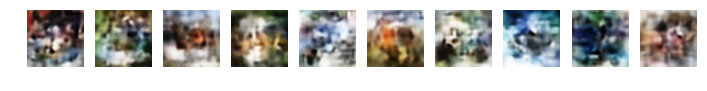

Epoch 1711 of 2000 took 22.59s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1692.99; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.99; test labelled classification loss: 1.59; test accuracy: 0.636
Epoch 1712 of 2000 took 22.72s;
train unlabelled reconstruction loss: 1693.36;
train labelled reconstruction loss: 1692.99; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.16; test labelled classification loss: 1.55; test accuracy: 0.638
Epoch 1713 of 2000 took 22.74s;
train unlabelled reconstruction loss: 1693.41;
train labelled reconstruction loss: 1692.81; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.54; test labelled classification loss: 1.60; test accuracy: 0.628
Epoch 1714 of 2000 took 22.59s;
train unlabelled reconstruction loss: 1693.29;
train labelled reconstruction loss: 169

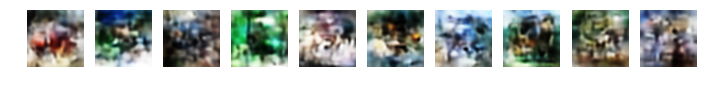

Epoch 1721 of 2000 took 22.64s;
train unlabelled reconstruction loss: 1693.62;
train labelled reconstruction loss: 1695.20; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1706.16; test labelled classification loss: 1.55; test accuracy: 0.642
Epoch 1722 of 2000 took 22.63s;
train unlabelled reconstruction loss: 1693.63;
train labelled reconstruction loss: 1692.98; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.08; test labelled classification loss: 1.57; test accuracy: 0.640
Epoch 1723 of 2000 took 22.92s;
train unlabelled reconstruction loss: 1693.35;
train labelled reconstruction loss: 1693.06; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.62; test labelled classification loss: 1.56; test accuracy: 0.637
Epoch 1724 of 2000 took 22.72s;
train unlabelled reconstruction loss: 1693.25;
train labelled reconstruction loss: 169

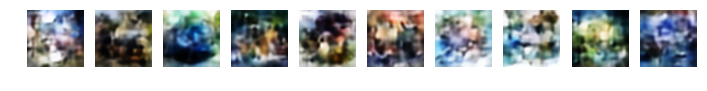

Epoch 1731 of 2000 took 22.64s;
train unlabelled reconstruction loss: 1693.62;
train labelled reconstruction loss: 1693.17; train labelled classification loss: 0.01; train accuracy: 0.999
test labelled reconstruction loss: 1704.59; test labelled classification loss: 1.58; test accuracy: 0.637
Epoch 1732 of 2000 took 22.54s;
train unlabelled reconstruction loss: 1693.50;
train labelled reconstruction loss: 1693.86; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.74; test labelled classification loss: 1.59; test accuracy: 0.631
Epoch 1733 of 2000 took 22.46s;
train unlabelled reconstruction loss: 1693.54;
train labelled reconstruction loss: 1693.10; train labelled classification loss: 0.02; train accuracy: 0.997
test labelled reconstruction loss: 1704.80; test labelled classification loss: 1.59; test accuracy: 0.632
Epoch 1734 of 2000 took 22.64s;
train unlabelled reconstruction loss: 1693.41;
train labelled reconstruction loss: 169

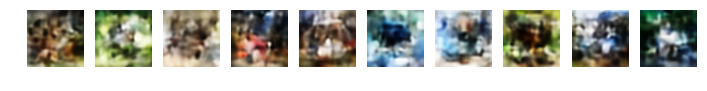

Epoch 1741 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1693.26;
train labelled reconstruction loss: 1693.22; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.09; test labelled classification loss: 1.57; test accuracy: 0.642
Epoch 1742 of 2000 took 22.57s;
train unlabelled reconstruction loss: 1693.20;
train labelled reconstruction loss: 1693.21; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.82; test labelled classification loss: 1.60; test accuracy: 0.629
Epoch 1743 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1693.67;
train labelled reconstruction loss: 1693.38; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.39; test labelled classification loss: 1.56; test accuracy: 0.645
Epoch 1744 of 2000 took 22.65s;
train unlabelled reconstruction loss: 1693.33;
train labelled reconstruction loss: 169

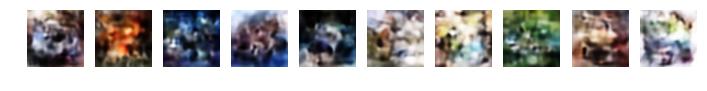

Epoch 1751 of 2000 took 22.70s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 1692.96; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.43; test labelled classification loss: 1.54; test accuracy: 0.643
Epoch 1752 of 2000 took 22.55s;
train unlabelled reconstruction loss: 1693.76;
train labelled reconstruction loss: 1693.05; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1706.20; test labelled classification loss: 1.54; test accuracy: 0.645
Epoch 1753 of 2000 took 22.53s;
train unlabelled reconstruction loss: 1693.41;
train labelled reconstruction loss: 1692.88; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.84; test labelled classification loss: 1.57; test accuracy: 0.643
Epoch 1754 of 2000 took 22.47s;
train unlabelled reconstruction loss: 1693.48;
train labelled reconstruction loss: 169

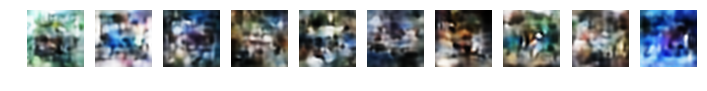

Epoch 1761 of 2000 took 22.63s;
train unlabelled reconstruction loss: 1693.41;
train labelled reconstruction loss: 1693.25; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.86; test labelled classification loss: 1.61; test accuracy: 0.633
Epoch 1762 of 2000 took 22.82s;
train unlabelled reconstruction loss: 1693.37;
train labelled reconstruction loss: 1693.03; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1706.22; test labelled classification loss: 1.59; test accuracy: 0.637
Epoch 1763 of 2000 took 22.94s;
train unlabelled reconstruction loss: 1693.29;
train labelled reconstruction loss: 1692.74; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.40; test labelled classification loss: 1.57; test accuracy: 0.640
Epoch 1764 of 2000 took 22.90s;
train unlabelled reconstruction loss: 1693.32;
train labelled reconstruction loss: 169

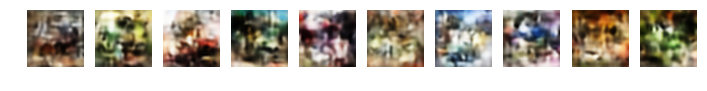

Epoch 1771 of 2000 took 22.61s;
train unlabelled reconstruction loss: 1693.21;
train labelled reconstruction loss: 1692.79; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.98; test labelled classification loss: 1.59; test accuracy: 0.631
Epoch 1772 of 2000 took 22.75s;
train unlabelled reconstruction loss: 1693.17;
train labelled reconstruction loss: 1692.92; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.09; test labelled classification loss: 1.60; test accuracy: 0.637
Epoch 1773 of 2000 took 22.54s;
train unlabelled reconstruction loss: 1693.36;
train labelled reconstruction loss: 1692.73; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.77; test labelled classification loss: 1.63; test accuracy: 0.641
Epoch 1774 of 2000 took 22.73s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 169

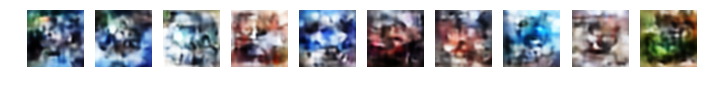

Epoch 1781 of 2000 took 22.52s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 1693.37; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1705.51; test labelled classification loss: 1.62; test accuracy: 0.639
Epoch 1782 of 2000 took 22.64s;
train unlabelled reconstruction loss: 1693.34;
train labelled reconstruction loss: 1692.72; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.25; test labelled classification loss: 1.58; test accuracy: 0.637
Epoch 1783 of 2000 took 22.58s;
train unlabelled reconstruction loss: 1693.27;
train labelled reconstruction loss: 1692.92; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.11; test labelled classification loss: 1.62; test accuracy: 0.630
Epoch 1784 of 2000 took 22.52s;
train unlabelled reconstruction loss: 1693.40;
train labelled reconstruction loss: 169

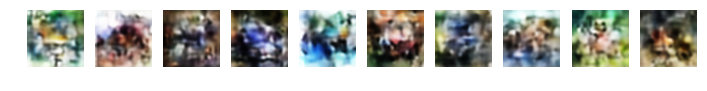

Epoch 1791 of 2000 took 22.63s;
train unlabelled reconstruction loss: 1693.24;
train labelled reconstruction loss: 1692.95; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.20; test labelled classification loss: 1.60; test accuracy: 0.635
Epoch 1792 of 2000 took 22.78s;
train unlabelled reconstruction loss: 1693.40;
train labelled reconstruction loss: 1692.91; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.39; test labelled classification loss: 1.57; test accuracy: 0.642
Epoch 1793 of 2000 took 22.56s;
train unlabelled reconstruction loss: 1693.45;
train labelled reconstruction loss: 1693.02; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.09; test labelled classification loss: 1.59; test accuracy: 0.634
Epoch 1794 of 2000 took 22.77s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 169

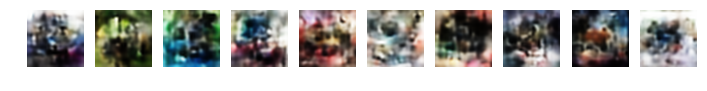

Epoch 1801 of 2000 took 22.71s;
train unlabelled reconstruction loss: 1693.73;
train labelled reconstruction loss: 1693.07; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1704.83; test labelled classification loss: 1.60; test accuracy: 0.641
Epoch 1802 of 2000 took 22.54s;
train unlabelled reconstruction loss: 1694.04;
train labelled reconstruction loss: 1693.12; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1704.61; test labelled classification loss: 1.60; test accuracy: 0.637
Epoch 1803 of 2000 took 22.71s;
train unlabelled reconstruction loss: 1693.32;
train labelled reconstruction loss: 1693.15; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.77; test labelled classification loss: 1.59; test accuracy: 0.636
Epoch 1804 of 2000 took 22.71s;
train unlabelled reconstruction loss: 1693.33;
train labelled reconstruction loss: 169

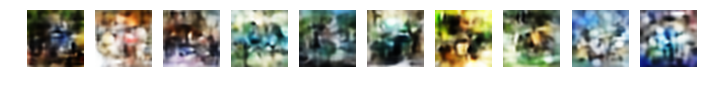

Epoch 1811 of 2000 took 22.61s;
train unlabelled reconstruction loss: 1693.29;
train labelled reconstruction loss: 1693.30; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1706.31; test labelled classification loss: 1.61; test accuracy: 0.639
Epoch 1812 of 2000 took 22.69s;
train unlabelled reconstruction loss: 1693.38;
train labelled reconstruction loss: 1692.72; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1705.23; test labelled classification loss: 1.62; test accuracy: 0.632
Epoch 1813 of 2000 took 22.54s;
train unlabelled reconstruction loss: 1693.27;
train labelled reconstruction loss: 1692.71; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.28; test labelled classification loss: 1.62; test accuracy: 0.639
Epoch 1814 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.46;
train labelled reconstruction loss: 169

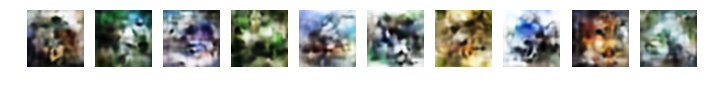

Epoch 1821 of 2000 took 22.62s;
train unlabelled reconstruction loss: 1693.40;
train labelled reconstruction loss: 1693.16; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.58; test labelled classification loss: 1.61; test accuracy: 0.641
Epoch 1822 of 2000 took 22.70s;
train unlabelled reconstruction loss: 1693.35;
train labelled reconstruction loss: 1692.99; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.24; test labelled classification loss: 1.62; test accuracy: 0.635
Epoch 1823 of 2000 took 22.63s;
train unlabelled reconstruction loss: 1693.28;
train labelled reconstruction loss: 1692.69; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1704.85; test labelled classification loss: 1.62; test accuracy: 0.639
Epoch 1824 of 2000 took 22.76s;
train unlabelled reconstruction loss: 1693.58;
train labelled reconstruction loss: 169

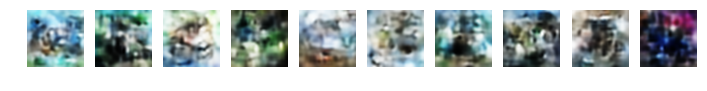

Epoch 1831 of 2000 took 22.83s;
train unlabelled reconstruction loss: 1693.36;
train labelled reconstruction loss: 1692.83; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.04; test labelled classification loss: 1.59; test accuracy: 0.642
Epoch 1832 of 2000 took 22.72s;
train unlabelled reconstruction loss: 1693.28;
train labelled reconstruction loss: 1692.63; train labelled classification loss: 0.02; train accuracy: 0.996
test labelled reconstruction loss: 1704.88; test labelled classification loss: 1.65; test accuracy: 0.631
Epoch 1833 of 2000 took 22.74s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 1693.50; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.78; test labelled classification loss: 1.64; test accuracy: 0.641
Epoch 1834 of 2000 took 22.79s;
train unlabelled reconstruction loss: 1693.37;
train labelled reconstruction loss: 169

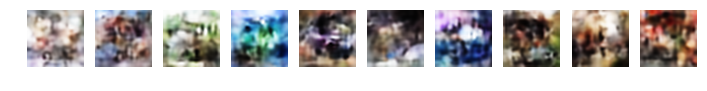

Epoch 1841 of 2000 took 22.54s;
train unlabelled reconstruction loss: 1693.33;
train labelled reconstruction loss: 1693.28; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1706.22; test labelled classification loss: 1.60; test accuracy: 0.632
Epoch 1842 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.76;
train labelled reconstruction loss: 1693.39; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.63; test labelled classification loss: 1.63; test accuracy: 0.634
Epoch 1843 of 2000 took 22.58s;
train unlabelled reconstruction loss: 1693.50;
train labelled reconstruction loss: 1692.93; train labelled classification loss: 0.01; train accuracy: 0.995
test labelled reconstruction loss: 1705.41; test labelled classification loss: 1.57; test accuracy: 0.643
Epoch 1844 of 2000 took 22.60s;
train unlabelled reconstruction loss: 1693.47;
train labelled reconstruction loss: 169

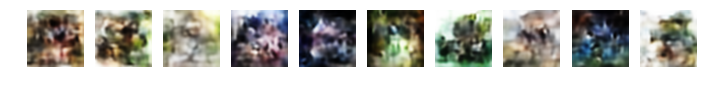

Epoch 1851 of 2000 took 22.75s;
train unlabelled reconstruction loss: 1693.42;
train labelled reconstruction loss: 1692.85; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.49; test labelled classification loss: 1.58; test accuracy: 0.640
Epoch 1852 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.46;
train labelled reconstruction loss: 1693.01; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1705.44; test labelled classification loss: 1.62; test accuracy: 0.635
Epoch 1853 of 2000 took 22.88s;
train unlabelled reconstruction loss: 1693.26;
train labelled reconstruction loss: 1692.69; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.03; test labelled classification loss: 1.62; test accuracy: 0.632
Epoch 1854 of 2000 took 22.69s;
train unlabelled reconstruction loss: 1693.14;
train labelled reconstruction loss: 169

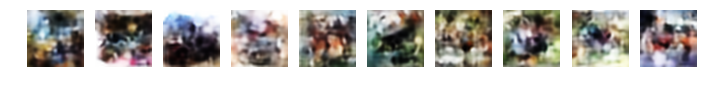

Epoch 1861 of 2000 took 22.49s;
train unlabelled reconstruction loss: 1693.29;
train labelled reconstruction loss: 1692.93; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.71; test labelled classification loss: 1.61; test accuracy: 0.637
Epoch 1862 of 2000 took 22.78s;
train unlabelled reconstruction loss: 1693.23;
train labelled reconstruction loss: 1693.13; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.74; test labelled classification loss: 1.64; test accuracy: 0.636
Epoch 1863 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1693.30;
train labelled reconstruction loss: 1692.94; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1704.88; test labelled classification loss: 1.63; test accuracy: 0.634
Epoch 1864 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1693.83;
train labelled reconstruction loss: 169

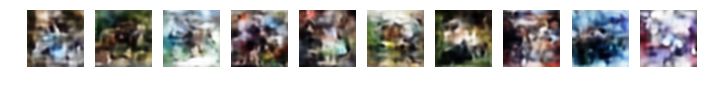

Epoch 1871 of 2000 took 22.62s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 1692.67; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.72; test labelled classification loss: 1.63; test accuracy: 0.641
Epoch 1872 of 2000 took 22.81s;
train unlabelled reconstruction loss: 1693.50;
train labelled reconstruction loss: 1692.78; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.95; test labelled classification loss: 1.67; test accuracy: 0.637
Epoch 1873 of 2000 took 22.91s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 1692.89; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.86; test labelled classification loss: 1.63; test accuracy: 0.639
Epoch 1874 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1694.22;
train labelled reconstruction loss: 169

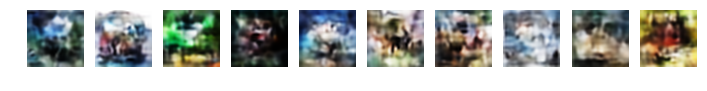

Epoch 1881 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.46;
train labelled reconstruction loss: 1693.97; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.67; test labelled classification loss: 1.63; test accuracy: 0.629
Epoch 1882 of 2000 took 22.63s;
train unlabelled reconstruction loss: 1693.52;
train labelled reconstruction loss: 1693.89; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1705.40; test labelled classification loss: 1.61; test accuracy: 0.643
Epoch 1883 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1693.39;
train labelled reconstruction loss: 1692.73; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.38; test labelled classification loss: 1.61; test accuracy: 0.634
Epoch 1884 of 2000 took 22.87s;
train unlabelled reconstruction loss: 1693.38;
train labelled reconstruction loss: 169

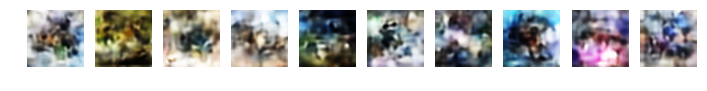

Epoch 1891 of 2000 took 22.56s;
train unlabelled reconstruction loss: 1693.33;
train labelled reconstruction loss: 1692.96; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.99; test labelled classification loss: 1.65; test accuracy: 0.637
Epoch 1892 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.81;
train labelled reconstruction loss: 1693.22; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1705.17; test labelled classification loss: 1.66; test accuracy: 0.632
Epoch 1893 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1693.29;
train labelled reconstruction loss: 1692.78; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1705.20; test labelled classification loss: 1.63; test accuracy: 0.638
Epoch 1894 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.38;
train labelled reconstruction loss: 169

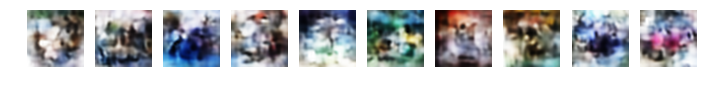

Epoch 1901 of 2000 took 22.78s;
train unlabelled reconstruction loss: 1693.58;
train labelled reconstruction loss: 1693.13; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.38; test labelled classification loss: 1.62; test accuracy: 0.638
Epoch 1902 of 2000 took 22.79s;
train unlabelled reconstruction loss: 1693.39;
train labelled reconstruction loss: 1692.89; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1704.98; test labelled classification loss: 1.62; test accuracy: 0.640
Epoch 1903 of 2000 took 22.70s;
train unlabelled reconstruction loss: 1693.73;
train labelled reconstruction loss: 1692.84; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.04; test labelled classification loss: 1.67; test accuracy: 0.631
Epoch 1904 of 2000 took 22.66s;
train unlabelled reconstruction loss: 1693.68;
train labelled reconstruction loss: 169

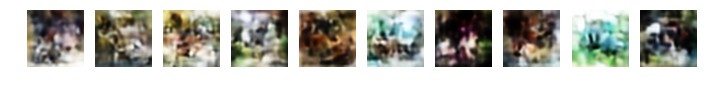

Epoch 1911 of 2000 took 22.74s;
train unlabelled reconstruction loss: 1693.39;
train labelled reconstruction loss: 1693.26; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.36; test labelled classification loss: 1.63; test accuracy: 0.642
Epoch 1912 of 2000 took 22.74s;
train unlabelled reconstruction loss: 1694.32;
train labelled reconstruction loss: 1693.00; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.33; test labelled classification loss: 1.71; test accuracy: 0.628
Epoch 1913 of 2000 took 22.59s;
train unlabelled reconstruction loss: 1693.85;
train labelled reconstruction loss: 1693.82; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1705.23; test labelled classification loss: 1.64; test accuracy: 0.639
Epoch 1914 of 2000 took 22.78s;
train unlabelled reconstruction loss: 1693.57;
train labelled reconstruction loss: 169

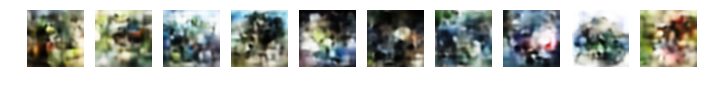

Epoch 1921 of 2000 took 22.63s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 1693.01; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.52; test labelled classification loss: 1.62; test accuracy: 0.635
Epoch 1922 of 2000 took 22.74s;
train unlabelled reconstruction loss: 1693.32;
train labelled reconstruction loss: 1692.83; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.26; test labelled classification loss: 1.63; test accuracy: 0.639
Epoch 1923 of 2000 took 22.75s;
train unlabelled reconstruction loss: 1693.68;
train labelled reconstruction loss: 1692.99; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1706.25; test labelled classification loss: 1.63; test accuracy: 0.638
Epoch 1924 of 2000 took 22.70s;
train unlabelled reconstruction loss: 1693.97;
train labelled reconstruction loss: 169

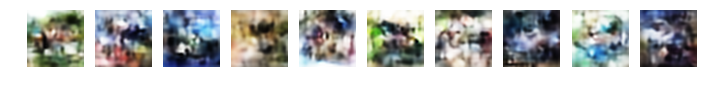

Epoch 1931 of 2000 took 22.57s;
train unlabelled reconstruction loss: 1693.30;
train labelled reconstruction loss: 1692.87; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.17; test labelled classification loss: 1.67; test accuracy: 0.628
Epoch 1932 of 2000 took 22.60s;
train unlabelled reconstruction loss: 1693.31;
train labelled reconstruction loss: 1693.00; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1705.37; test labelled classification loss: 1.62; test accuracy: 0.636
Epoch 1933 of 2000 took 22.68s;
train unlabelled reconstruction loss: 1693.34;
train labelled reconstruction loss: 1692.80; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.08; test labelled classification loss: 1.64; test accuracy: 0.633
Epoch 1934 of 2000 took 22.82s;
train unlabelled reconstruction loss: 1693.22;
train labelled reconstruction loss: 169

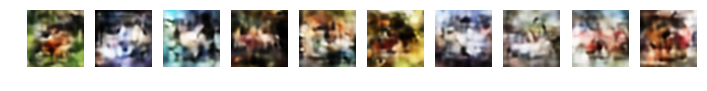

Epoch 1941 of 2000 took 22.81s;
train unlabelled reconstruction loss: 1693.27;
train labelled reconstruction loss: 1692.86; train labelled classification loss: 0.01; train accuracy: 0.996
test labelled reconstruction loss: 1706.42; test labelled classification loss: 1.66; test accuracy: 0.637
Epoch 1942 of 2000 took 22.72s;
train unlabelled reconstruction loss: 1693.46;
train labelled reconstruction loss: 1693.22; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.65; test labelled classification loss: 1.61; test accuracy: 0.643
Epoch 1943 of 2000 took 22.81s;
train unlabelled reconstruction loss: 1693.32;
train labelled reconstruction loss: 1692.80; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.44; test labelled classification loss: 1.64; test accuracy: 0.638
Epoch 1944 of 2000 took 22.88s;
train unlabelled reconstruction loss: 1693.36;
train labelled reconstruction loss: 169

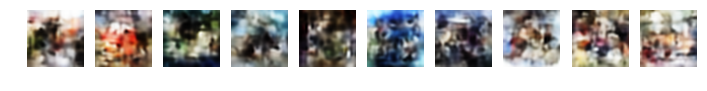

Epoch 1951 of 2000 took 22.56s;
train unlabelled reconstruction loss: 1693.19;
train labelled reconstruction loss: 1692.71; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.10; test labelled classification loss: 1.65; test accuracy: 0.638
Epoch 1952 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.89;
train labelled reconstruction loss: 1693.25; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.68; test labelled classification loss: 1.64; test accuracy: 0.643
Epoch 1953 of 2000 took 22.62s;
train unlabelled reconstruction loss: 1693.23;
train labelled reconstruction loss: 1692.83; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1704.72; test labelled classification loss: 1.59; test accuracy: 0.645
Epoch 1954 of 2000 took 22.65s;
train unlabelled reconstruction loss: 1693.25;
train labelled reconstruction loss: 169

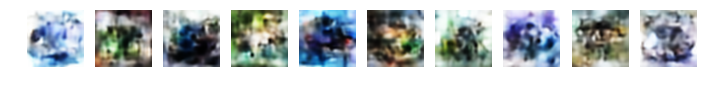

Epoch 1961 of 2000 took 22.78s;
train unlabelled reconstruction loss: 1693.23;
train labelled reconstruction loss: 1693.39; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.30; test labelled classification loss: 1.69; test accuracy: 0.638
Epoch 1962 of 2000 took 22.65s;
train unlabelled reconstruction loss: 1693.20;
train labelled reconstruction loss: 1692.82; train labelled classification loss: 0.01; train accuracy: 0.995
test labelled reconstruction loss: 1704.95; test labelled classification loss: 1.68; test accuracy: 0.632
Epoch 1963 of 2000 took 22.55s;
train unlabelled reconstruction loss: 1693.86;
train labelled reconstruction loss: 1692.96; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.27; test labelled classification loss: 1.66; test accuracy: 0.636
Epoch 1964 of 2000 took 22.70s;
train unlabelled reconstruction loss: 1693.25;
train labelled reconstruction loss: 169

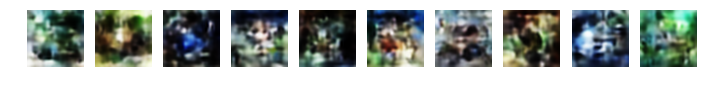

Epoch 1971 of 2000 took 22.60s;
train unlabelled reconstruction loss: 1694.50;
train labelled reconstruction loss: 1692.83; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.51; test labelled classification loss: 1.67; test accuracy: 0.637
Epoch 1972 of 2000 took 22.70s;
train unlabelled reconstruction loss: 1693.39;
train labelled reconstruction loss: 1692.78; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.03; test labelled classification loss: 1.67; test accuracy: 0.631
Epoch 1973 of 2000 took 22.70s;
train unlabelled reconstruction loss: 1693.36;
train labelled reconstruction loss: 1692.69; train labelled classification loss: 0.01; train accuracy: 0.999
test labelled reconstruction loss: 1705.14; test labelled classification loss: 1.67; test accuracy: 0.641
Epoch 1974 of 2000 took 22.56s;
train unlabelled reconstruction loss: 1693.40;
train labelled reconstruction loss: 169

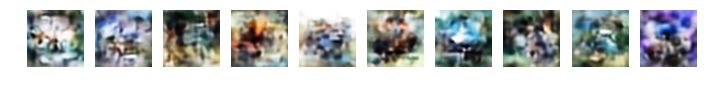

Epoch 1981 of 2000 took 22.52s;
train unlabelled reconstruction loss: 1693.43;
train labelled reconstruction loss: 1692.84; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.57; test labelled classification loss: 1.65; test accuracy: 0.637
Epoch 1982 of 2000 took 22.71s;
train unlabelled reconstruction loss: 1693.21;
train labelled reconstruction loss: 1692.84; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.19; test labelled classification loss: 1.66; test accuracy: 0.637
Epoch 1983 of 2000 took 22.78s;
train unlabelled reconstruction loss: 1693.11;
train labelled reconstruction loss: 1692.80; train labelled classification loss: 0.01; train accuracy: 0.998
test labelled reconstruction loss: 1705.07; test labelled classification loss: 1.66; test accuracy: 0.639
Epoch 1984 of 2000 took 22.62s;
train unlabelled reconstruction loss: 1693.24;
train labelled reconstruction loss: 169

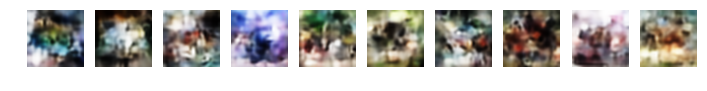

Epoch 1991 of 2000 took 22.65s;
train unlabelled reconstruction loss: 1694.13;
train labelled reconstruction loss: 1697.35; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1706.84; test labelled classification loss: 1.62; test accuracy: 0.640
Epoch 1992 of 2000 took 22.64s;
train unlabelled reconstruction loss: 1693.56;
train labelled reconstruction loss: 1692.96; train labelled classification loss: 0.01; train accuracy: 0.997
test labelled reconstruction loss: 1705.59; test labelled classification loss: 1.67; test accuracy: 0.634
Epoch 1993 of 2000 took 22.67s;
train unlabelled reconstruction loss: 1693.32;
train labelled reconstruction loss: 1692.96; train labelled classification loss: 0.01; train accuracy: 0.999
test labelled reconstruction loss: 1705.50; test labelled classification loss: 1.65; test accuracy: 0.642
Epoch 1994 of 2000 took 22.59s;
train unlabelled reconstruction loss: 1693.13;
train labelled reconstruction loss: 169

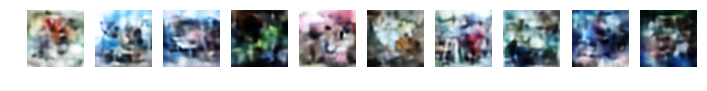

In [50]:
latent_dim = 300

num_epochs = 2000
save_every = 100

name_prefix = 'wae_gan_m2_results/'

#try:
if True:
    #vae = cuda_wrapper(VAE(latent_dim, input_shape))
    #vae.load_state_dict(torch.load(name_prefix + 'vae.pt'))
    #print("Found pretrained VAE")
#except:
    #print("Didn't found pretrained VAE; training...")
    
    wae = cuda_wrapper(WAE_WGAN_SemiSupervised(input_shape, latent_dim, output_size, regularization_factor=0.2))
    optimizer = optim.Adam(
        list(wae.proposal_generator.parameters()) + list(wae.generative_network.parameters()), 
        lr=1e-3, betas=(0.9, 0.9)
    )
    optimizer_discriminator = optim.Adam(wae.proposal_discriminator.parameters(), lr=1e-3, betas=(0.9, 0.9))
    optimizer_supervised_labelled = optim.Adam(wae.classifier.parameters(), lr=1e-5, betas=(0.9, 0.9))
    optimizer_supervised_unlabelled = optim.Adam(wae.classifier.parameters(), lr=1e-4, betas=(0.9, 0.9))

    for epoch in range(num_epochs):
        start_time = time()
    
        cum_loss = 0
        batch_count = 0
        
        for X_batch, _ in train_loader_unlabelled:
            X_batch = cuda_wrapper(Variable(X_batch))

            loss, loss_discriminator, _, _ = wae.batch_loss(X_batch)
            cum_loss += loss.data[0]
        
            do_discriminator_update = (
                epoch * len(train_loader.dataset.train_labels) // X_batch.shape[0] + batch_count
            ) % 10 > 0
        
            if do_discriminator_update:
                optimizer_discriminator.zero_grad()
                loss_discriminator.backward()
                optimizer_discriminator.step()
            else:
                optimizer.zero_grad()
                optimizer_supervised_unlabelled.zero_grad()
                loss.backward()
                optimizer.step()
                optimizer_supervised_unlabelled.step()
            batch_count += 1
    
        mean_train_unlabelled_reconstruction_loss = cum_loss / batch_count

        cum_loss = 0
        cum_loss_supervised = 0
        cum_acc = 0
        batch_count = 0
        
        for X_batch, y_batch in train_loader_labelled:
            X_batch = cuda_wrapper(Variable(X_batch))
            y_batch = cuda_wrapper(Variable(y_batch))

            loss, loss_discriminator, loss_supervised, acc = wae.batch_loss(X_batch, y_batch)
            cum_loss += loss.data[0]
            cum_loss_supervised += loss_supervised.data[0]
            
            cum_acc += acc.data[0]
        
            do_discriminator_update = (
                epoch * len(train_loader.dataset.train_labels) // X_batch.shape[0] + batch_count
            ) % 10 > 0
        
            if do_discriminator_update:
                optimizer_discriminator.zero_grad()
                loss_discriminator.backward()
                optimizer_discriminator.step()
            else:
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
            optimizer_supervised_labelled.zero_grad()
            loss_supervised.backward()
            optimizer_supervised_labelled.step()
            batch_count += 1
    
        mean_train_labelled_reconstruction_loss = cum_loss / batch_count
        mean_train_labelled_classification_loss = cum_loss_supervised / batch_count
        mean_train_accuracy = cum_acc / batch_count

        cum_loss = 0
        cum_loss_supervised = 0
        cum_acc = 0
        batch_count = 0
        
        for X_batch, y_batch in test_loader:
            X_batch = cuda_wrapper(Variable(X_batch))
            y_batch = cuda_wrapper(Variable(y_batch))

            loss, loss_discriminator, loss_supervised, acc = wae.batch_loss(X_batch, y_batch)
            cum_loss += loss.data[0]
            cum_loss_supervised += loss_supervised.data[0]
        
            cum_acc += acc.data[0]
        
            batch_count += 1
            
        mean_test_labelled_reconstruction_loss = cum_loss / batch_count
        mean_test_labelled_classification_loss = cum_loss_supervised / batch_count
        mean_test_accuracy = cum_acc / batch_count

        print('Epoch {} of {} took {:.2f}s;'.format(epoch+1, num_epochs, time() - start_time))
        print('train unlabelled reconstruction loss: {:.2f};'.format(
            mean_train_unlabelled_reconstruction_loss
        ))
        print('train labelled reconstruction loss: {:.2f}; train labelled classification loss: {:.2f}; train accuracy: {:.3f}'.format(
            mean_train_labelled_reconstruction_loss, mean_train_labelled_classification_loss, mean_train_accuracy
        ))
        print('test labelled reconstruction loss: {:.2f}; test labelled classification loss: {:.2f}; test accuracy: {:.3f}'.format(
            mean_test_labelled_reconstruction_loss, mean_test_labelled_classification_loss, mean_test_accuracy
        ))
        
        if (epoch+1) % 10 == 0:
            show_images(wae.generate_samples(cuda_wrapper(Variable(torch.arange(output_size).long()))))
            plt.show()
    
        if (epoch+1) % save_every == 0:
            torch.save(wae.state_dict(), name_prefix + 'wae_gan_m2.pt')
        
    print()


In [41]:
def show_images(x):
    plt.figure(figsize=(12, 12 / 10 * (x.shape[0] // 10 + 1)))
    for i in range(x.shape[0]):
        plt.subplot(x.shape[0] // 10 + 1, 10, i + 1)
        plt.imshow(np.transpose(x.data[i].cpu().numpy(), axes=(1,2,0)), cmap='Greys_r', vmin=0, vmax=1, interpolation='lanczos')
        plt.axis('off')

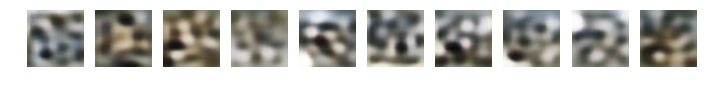

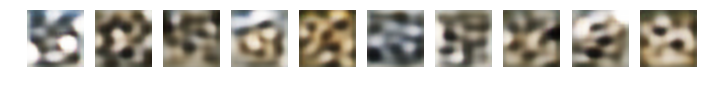

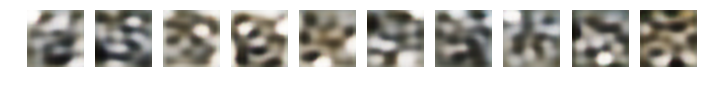

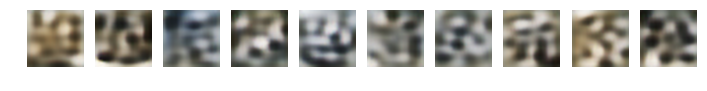

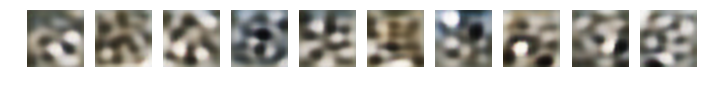

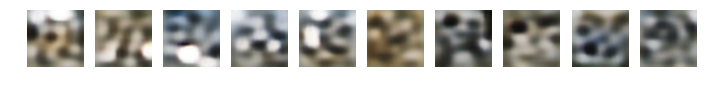

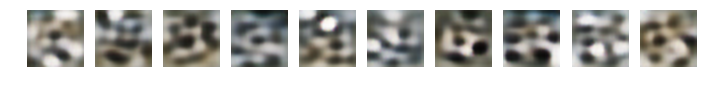

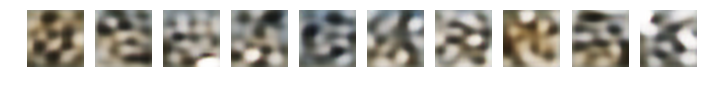

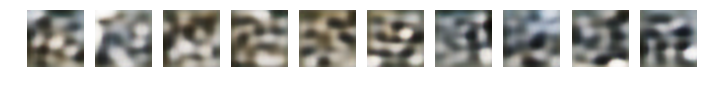

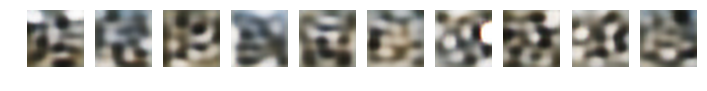

In [33]:
for label in range(10):
    show_images(wae.generate_samples(10))
    plt.show()

**Tangent prop**

In [24]:
def constrain_loss_function(model, vae, batch_gen=None, reparam_invariant=True, use_all_classes=False):
    latent_dim = vae.latent_size
    
    if reparam_invariant:
        if batch_gen is None:
            z_gen = cuda_wrapper(
                Variable(torch.normal(std=torch.ones(batch_size, latent_dim)))
            ) # [batch_size x latent_dim]
            X_gen = Variable(vae.generative_distr(z_gen).data, requires_grad=True) # [batch_size x C x H x W]
        else:
            X_gen, _ = next(batch_gen)
            X_gen = cuda_wrapper(Variable(X_gen, requires_grad=True))
        z_inferred = vae.sample_latent(vae.proposal_distr(X_gen)) # [batch_size x latent_dim]
    else:
        if batch_gen is None:
            z_inferred = cuda_wrapper(
                Variable(torch.normal(std=torch.ones(batch_size, latent_dim)), requires_grad=True)
            ) # [batch_size x latent_dim]
        else:
            X, _ = next(batch_gen)
            X = cuda_wrapper(Variable(X))
            mu_inferred, sigma_inferred = vae.proposal_distr(X)
            z_inferred = cuda_wrapper(
                Variable(torch.normal(means=mu_inferred.data, std=sigma_inferred.data), requires_grad=True)
            ) # [batch_size x latent_dim]
    X_inferred = vae.generative_distr(z_inferred) # [batch_size x C x H x W]
    model_output = model(X_inferred) # [batch_size x num_classes]
    
    if use_all_classes:
        grad_output_wrt_input_for_each_class = []
        for output in torch.unbind(torch.sum(model_output, dim=0)):
            grad_output_wrt_input_for_each_class.append(
                autograd.grad([output], [X_gen if reparam_invariant else z_inferred], create_graph=True)[0]
            ) # [batch_size x latent_dim]
        grad_output_wrt_input = torch.stack(
            grad_output_wrt_input_for_each_class
        ) # [num_classes x batch_size x latent_dim]
        return torch.sum(grad_output_wrt_input ** 2) / batch_size
    else:
        y = np.random.choice(output_size)
        output = torch.sum(model_output, dim=0)[y]
        grad_output_wrt_input = autograd.grad(
            [output], [X_gen if reparam_invariant else z_inferred], create_graph=True
        )[0]
        return output_size * torch.sum(grad_output_wrt_input ** 2) / batch_size

**Training**

In [25]:
class ModelConvolutional(nn.Module):
    def __init__(
        self, input_shape, output_size 
    ):
        super(type(self), self).__init__()
        assert input_shape[1] == input_shape[2]
        self.layers = nn.ModuleList([
            nn.Dropout(p=0.2),
            nn.Conv2d(input_shape[0], 96, 3, padding=1),
            nn.BatchNorm2d(96),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(96, 96, 3, padding=1),
            nn.BatchNorm2d(96),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(96, 96, 3, padding=1),
            nn.BatchNorm2d(96),
            nn.LeakyReLU(negative_slope=0.2),
            nn.MaxPool2d(2),
            nn.BatchNorm2d(96),
            
            nn.Dropout(p=0.5),
            nn.Conv2d(96, 192, 3, padding=1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(192, 192, 3, padding=1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(192, 192, 3, padding=1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.MaxPool2d(2),
            nn.BatchNorm2d(192),
            
            nn.Dropout(p=0.5),
            nn.Conv2d(192, 192, 3),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(192, 192, 1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Conv2d(192, 192, 1),
            nn.BatchNorm2d(192),
            nn.LeakyReLU(negative_slope=0.2),
            nn.AvgPool2d(6)
        ])
        self.output_layer = nn.utils.weight_norm(nn.Linear(192, 10))
        
    def forward(self, X):
        for layer in self.layers:
            X = layer(X)
        X = X.view(X.shape[0], -1)
        return F.log_softmax(self.output_layer(X), dim=1)

In [48]:
train_losses = {}
train_accs = {}

test_losses = {}
test_accs = {}

In [66]:
num_epochs = 100
save_every = 50

modes = ['tangent_prop_reparam_invariant_stochastic_eta=' + str(eta) for eta in [0, 1e-3, 1e-2, 1e-1]]

loss_function = nn.NLLLoss()

for mode in modes[1:]:
    mode_name = mode + '_labelled=4000_epochs=' + str(num_epochs)
    eta = float(mode.split('=')[1])

    print('Mode:', mode)
    print(mode_name)
    print('eta =', eta)
    print()
    
    train_losses[mode] = []
    train_accs[mode] = []
    
    test_losses[mode] = []
    test_accs[mode] = []

    torch.manual_seed(123)
    np.random.seed(123)
    model = cuda_wrapper(ModelConvolutional(input_shape, output_size))
    optimizer = optim.Adam(model.parameters(), lr=3e-4, betas=(0.5, 0.999))
    #scheduler = optim.lr_scheduler.LambdaLR(optimizer, lambda k: ((num_epochs-k)/200 if k >= num_epochs-200 else 1))
    
    for epoch in range(num_epochs):
        start_time = time()
    
        #scheduler.step()
    
        cum_loss_data = 0
        cum_loss_constrain = 0
        cum_loss_full = 0
        cum_acc = 0
        batch_count = 0

        model.train()
        for X, y in train_loader_labelled:
            X, y = cuda_wrapper(Variable(X)), cuda_wrapper(Variable(y))
            prediction = model(X)
            loss_data = loss_function(prediction, y)
            cum_loss_data += loss_data.data[0]
        
            #X_random = cuda_wrapper(Variable(next(random_input_gen), requires_grad=True))
            #loss_constrain = constrain_loss_function(model(X_random), X_random)
            if mode == 'no_reg':
                loss_constrain = cuda_wrapper(Variable(torch.zeros(1)))
            elif mode == 'tangent_prop':
                loss_constrain = constrain_loss_function(model, vae, reparam_invariant=False, use_all_classes=True)
            elif mode.startswith('tangent_prop_reparam_invariant_stochastic'):
                loss_constrain = constrain_loss_function(model, vae, reparam_invariant=True, use_all_classes=False)
            else:
                raise NotImplementedError
            cum_loss_constrain += loss_constrain.data[0]
        
            loss_full = loss_data + eta * loss_constrain
            cum_loss_full += loss_full.data[0]
            
            acc = torch.mean((torch.max(prediction, dim=-1)[1] == y).float())
            cum_acc += acc.data[0]
        
            optimizer.zero_grad()
            loss_full.backward()
            optimizer.step()
            batch_count += 1
            
        mean_train_loss_data = cum_loss_data / batch_count
        mean_train_loss_constrain = cum_loss_constrain / batch_count
        mean_train_loss_full = cum_loss_full / batch_count
        mean_train_acc = cum_acc / batch_count

        train_losses[mode].append(mean_train_loss_data)
        train_accs[mode].append(mean_train_acc)
        
        cum_loss_data = 0
        cum_loss_constrain = 0
        cum_acc = 0
        batch_count = 0

        model.eval()
        for X, y in test_loader:
            X, y = cuda_wrapper(Variable(X)), cuda_wrapper(Variable(y))
            prediction = model(X)
            loss_data = loss_function(prediction, y)
            cum_loss_data += loss_data.data[0]
        
            #if mode == 'no_reg':
            #    loss_constrain = cuda_wrapper(Variable(torch.zeros(1)))
            #elif mode == 'tangent_prop':
            #    loss_constrain = constrain_loss_function(model, vae, reparam_invariant=False, use_all_classes=True)
            #elif mode == 'tangent_prop_reparam_invariant_stochastic':
            #    loss_constrain = constrain_loss_function(model, vae, reparam_invariant=True, use_all_classes=False)
            #else:
            #    raise NotImplementedError
            #cum_loss_constrain += loss_constrain.data[0]
        
            acc = torch.mean((torch.max(prediction, dim=-1)[1] == y).float())
            cum_acc += acc.data[0]
        
            batch_count += 1
            
        mean_test_loss_data = cum_loss_data / batch_count
        mean_test_loss_constrain = cum_loss_constrain / batch_count
        mean_test_acc = cum_acc / batch_count

        test_losses[mode].append(mean_test_loss_data)
        test_accs[mode].append(mean_test_acc)
        
        print('Epoch {} of {} took {:.2f}s;'.format(epoch+1, num_epochs, time() - start_time))
        print('train loss:')
        print(
            'data term: {:.2f}, constrain term: {:.2f}, full: {:.2f}'.format(
                mean_train_loss_data, mean_train_loss_constrain, mean_train_loss_full
            )
        )
        print('train acc: {:.2f}'.format(mean_train_acc))
        print('test loss:')
        print(
            'data term: {:.2f}, constrain term: {:.2f}'.format(
                mean_test_loss_data, mean_test_loss_constrain
            )
        )
        print('test acc: {:.2f}'.format(mean_test_acc))
        print()
        
        if (epoch+1) % save_every == 0:
            with open(name_prefix + mode_name + '/train_losses.pkl', 'wb') as f:
                pickle.dump(np.array(train_losses[mode]), f)
            with open(name_prefix + mode_name + '/test_losses.pkl', 'wb') as f:
                pickle.dump(np.array(test_losses[mode]), f)
            with open(name_prefix + mode_name + '/train_accs.pkl', 'wb') as f:
                pickle.dump(np.array(train_accs[mode]), f)
            with open(name_prefix + mode_name + '/test_accs.pkl', 'wb') as f:
                pickle.dump(np.array(test_accs[mode]), f)

            torch.save(model.state_dict(), name_prefix + mode_name + '/model.pt')



Mode: tangent_prop_reparam_invariant_stochastic_eta=0.001
tangent_prop_reparam_invariant_stochastic_eta=0.001_labelled=4000_epochs=100
eta = 0.001

Epoch 1 of 100 took 19.24s;
train loss:
data term: 1.95, constrain term: 0.07, full: 1.95
train acc: 0.27
test loss:
data term: 2.02, constrain term: 0.00
test acc: 0.24

Epoch 2 of 100 took 19.22s;
train loss:
data term: 1.76, constrain term: 0.30, full: 1.76
train acc: 0.35
test loss:
data term: 1.93, constrain term: 0.00
test acc: 0.28

Epoch 3 of 100 took 19.22s;
train loss:
data term: 1.66, constrain term: 0.49, full: 1.66
train acc: 0.39
test loss:
data term: 1.77, constrain term: 0.00
test acc: 0.35

Epoch 4 of 100 took 19.14s;
train loss:
data term: 1.60, constrain term: 0.75, full: 1.60
train acc: 0.42
test loss:
data term: 1.78, constrain term: 0.00
test acc: 0.34

Epoch 5 of 100 took 19.19s;
train loss:
data term: 1.54, constrain term: 0.95, full: 1.55
train acc: 0.44
test loss:
data term: 1.70, constrain term: 0.00
test acc: 0.3

Epoch 48 of 100 took 19.22s;
train loss:
data term: 0.48, constrain term: 14.74, full: 0.50
train acc: 0.84
test loss:
data term: 1.25, constrain term: 0.00
test acc: 0.61

Epoch 49 of 100 took 19.23s;
train loss:
data term: 0.47, constrain term: 15.29, full: 0.49
train acc: 0.84
test loss:
data term: 1.25, constrain term: 0.00
test acc: 0.63

Epoch 50 of 100 took 19.24s;
train loss:
data term: 0.47, constrain term: 15.14, full: 0.49
train acc: 0.85
test loss:
data term: 1.32, constrain term: 0.00
test acc: 0.60

Epoch 51 of 100 took 19.32s;
train loss:
data term: 0.45, constrain term: 15.73, full: 0.47
train acc: 0.86
test loss:
data term: 1.31, constrain term: 0.00
test acc: 0.61

Epoch 52 of 100 took 19.22s;
train loss:
data term: 0.42, constrain term: 16.15, full: 0.43
train acc: 0.87
test loss:
data term: 1.12, constrain term: 0.00
test acc: 0.65

Epoch 53 of 100 took 19.23s;
train loss:
data term: 0.41, constrain term: 16.84, full: 0.43
train acc: 0.87
test loss:
data term: 1.41,

Epoch 96 of 100 took 19.36s;
train loss:
data term: 0.14, constrain term: 9.96, full: 0.15
train acc: 0.96
test loss:
data term: 1.16, constrain term: 0.00
test acc: 0.66

Epoch 97 of 100 took 19.34s;
train loss:
data term: 0.14, constrain term: 8.80, full: 0.15
train acc: 0.96
test loss:
data term: 1.38, constrain term: 0.00
test acc: 0.61

Epoch 98 of 100 took 19.50s;
train loss:
data term: 0.15, constrain term: 9.15, full: 0.16
train acc: 0.95
test loss:
data term: 1.23, constrain term: 0.00
test acc: 0.65

Epoch 99 of 100 took 19.50s;
train loss:
data term: 0.14, constrain term: 8.25, full: 0.15
train acc: 0.96
test loss:
data term: 1.22, constrain term: 0.00
test acc: 0.64

Epoch 100 of 100 took 19.32s;
train loss:
data term: 0.14, constrain term: 8.35, full: 0.14
train acc: 0.96
test loss:
data term: 1.28, constrain term: 0.00
test acc: 0.63

Mode: tangent_prop_reparam_invariant_stochastic_eta=0.01
tangent_prop_reparam_invariant_stochastic_eta=0.01_labelled=4000_epochs=100
eta = 

Epoch 43 of 100 took 19.17s;
train loss:
data term: 0.59, constrain term: 1.06, full: 0.60
train acc: 0.81
test loss:
data term: 1.36, constrain term: 0.00
test acc: 0.56

Epoch 44 of 100 took 19.15s;
train loss:
data term: 0.57, constrain term: 0.93, full: 0.58
train acc: 0.81
test loss:
data term: 1.29, constrain term: 0.00
test acc: 0.56

Epoch 45 of 100 took 19.18s;
train loss:
data term: 0.57, constrain term: 0.86, full: 0.58
train acc: 0.81
test loss:
data term: 1.09, constrain term: 0.00
test acc: 0.62

Epoch 46 of 100 took 19.23s;
train loss:
data term: 0.55, constrain term: 0.79, full: 0.56
train acc: 0.82
test loss:
data term: 1.15, constrain term: 0.00
test acc: 0.61

Epoch 47 of 100 took 19.36s;
train loss:
data term: 0.52, constrain term: 0.76, full: 0.53
train acc: 0.83
test loss:
data term: 1.21, constrain term: 0.00
test acc: 0.59

Epoch 48 of 100 took 19.20s;
train loss:
data term: 0.53, constrain term: 0.72, full: 0.54
train acc: 0.82
test loss:
data term: 1.23, const

Epoch 91 of 100 took 19.23s;
train loss:
data term: 0.16, constrain term: 0.22, full: 0.16
train acc: 0.95
test loss:
data term: 1.26, constrain term: 0.00
test acc: 0.59

Epoch 92 of 100 took 19.25s;
train loss:
data term: 0.16, constrain term: 0.22, full: 0.16
train acc: 0.95
test loss:
data term: 1.35, constrain term: 0.00
test acc: 0.57

Epoch 93 of 100 took 19.18s;
train loss:
data term: 0.15, constrain term: 0.22, full: 0.15
train acc: 0.96
test loss:
data term: 1.39, constrain term: 0.00
test acc: 0.55

Epoch 94 of 100 took 19.25s;
train loss:
data term: 0.14, constrain term: 0.21, full: 0.15
train acc: 0.96
test loss:
data term: 1.46, constrain term: 0.00
test acc: 0.54

Epoch 95 of 100 took 19.23s;
train loss:
data term: 0.15, constrain term: 0.22, full: 0.15
train acc: 0.96
test loss:
data term: 1.39, constrain term: 0.00
test acc: 0.54

Epoch 96 of 100 took 19.32s;
train loss:
data term: 0.13, constrain term: 0.21, full: 0.13
train acc: 0.96
test loss:
data term: 1.35, const

Epoch 38 of 100 took 19.17s;
train loss:
data term: 0.71, constrain term: 0.07, full: 0.72
train acc: 0.76
test loss:
data term: 1.21, constrain term: 0.00
test acc: 0.59

Epoch 39 of 100 took 19.15s;
train loss:
data term: 0.70, constrain term: 0.07, full: 0.71
train acc: 0.76
test loss:
data term: 1.26, constrain term: 0.00
test acc: 0.57

Epoch 40 of 100 took 19.16s;
train loss:
data term: 0.66, constrain term: 0.06, full: 0.67
train acc: 0.78
test loss:
data term: 1.37, constrain term: 0.00
test acc: 0.55

Epoch 41 of 100 took 19.12s;
train loss:
data term: 0.64, constrain term: 0.06, full: 0.65
train acc: 0.79
test loss:
data term: 1.23, constrain term: 0.00
test acc: 0.59

Epoch 42 of 100 took 19.13s;
train loss:
data term: 0.62, constrain term: 0.06, full: 0.63
train acc: 0.79
test loss:
data term: 1.39, constrain term: 0.00
test acc: 0.53

Epoch 43 of 100 took 19.17s;
train loss:
data term: 0.61, constrain term: 0.07, full: 0.62
train acc: 0.79
test loss:
data term: 1.26, const

Epoch 86 of 100 took 19.31s;
train loss:
data term: 0.19, constrain term: 0.03, full: 0.20
train acc: 0.94
test loss:
data term: 1.45, constrain term: 0.00
test acc: 0.52

Epoch 87 of 100 took 19.56s;
train loss:
data term: 0.19, constrain term: 0.03, full: 0.20
train acc: 0.94
test loss:
data term: 1.54, constrain term: 0.00
test acc: 0.48

Epoch 88 of 100 took 19.51s;
train loss:
data term: 0.19, constrain term: 0.03, full: 0.19
train acc: 0.94
test loss:
data term: 1.46, constrain term: 0.00
test acc: 0.50

Epoch 89 of 100 took 19.37s;
train loss:
data term: 0.18, constrain term: 0.03, full: 0.19
train acc: 0.94
test loss:
data term: 1.39, constrain term: 0.00
test acc: 0.53

Epoch 90 of 100 took 19.53s;
train loss:
data term: 0.18, constrain term: 0.03, full: 0.18
train acc: 0.94
test loss:
data term: 1.66, constrain term: 0.00
test acc: 0.47

Epoch 91 of 100 took 19.31s;
train loss:
data term: 0.17, constrain term: 0.03, full: 0.18
train acc: 0.95
test loss:
data term: 1.49, const

In [38]:
from pandas import ewma, DataFrame

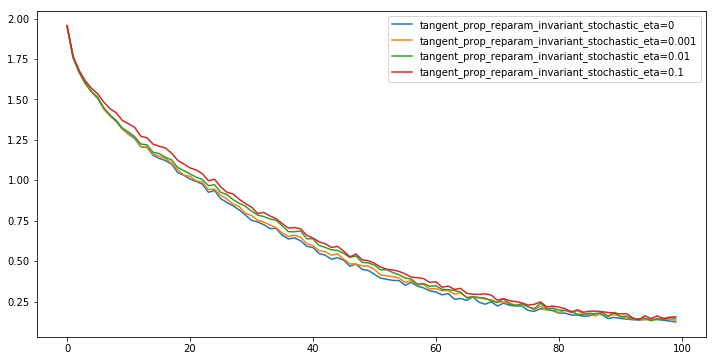

In [67]:
plt.figure(figsize=(12, 6))

for mode in modes:
    plt.plot(train_losses[mode])
plt.legend(modes)

/home/golikov/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: FutureWarning: pd.ewm_mean is deprecated for DataFrame and will be removed in a future version, replace with 
	DataFrame.ewm(alpha=0.1,min_periods=0,adjust=True,ignore_na=False).mean()
  after removing the cwd from sys.path.


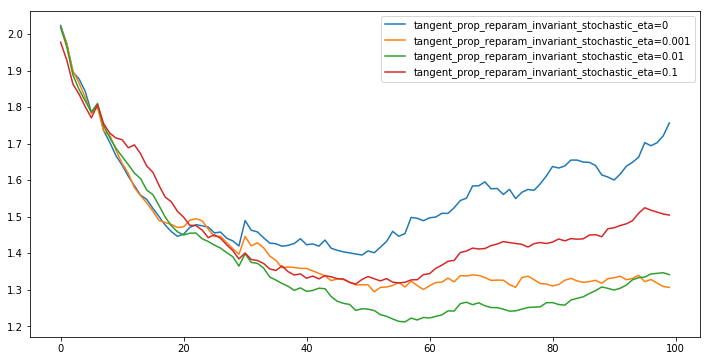

In [71]:
plt.figure(figsize=(12, 6))

for mode in modes:
    plt.plot(ewma(DataFrame(test_losses[mode]), alpha=0.1))
plt.legend(modes)

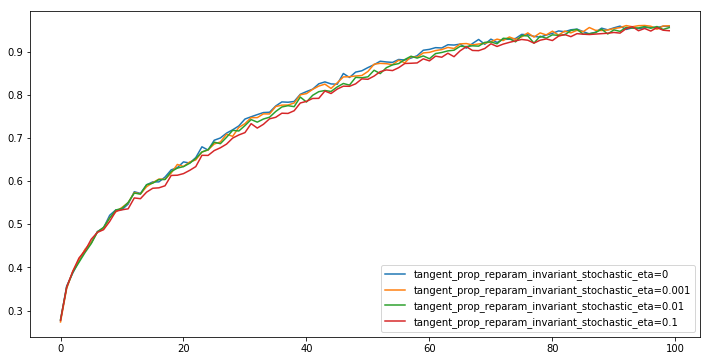

In [69]:
plt.figure(figsize=(12, 6))

for mode in modes:
    plt.plot(train_accs[mode])
plt.legend(modes)

/home/golikov/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: FutureWarning: pd.ewm_mean is deprecated for DataFrame and will be removed in a future version, replace with 
	DataFrame.ewm(alpha=0.1,min_periods=0,adjust=True,ignore_na=False).mean()
  after removing the cwd from sys.path.


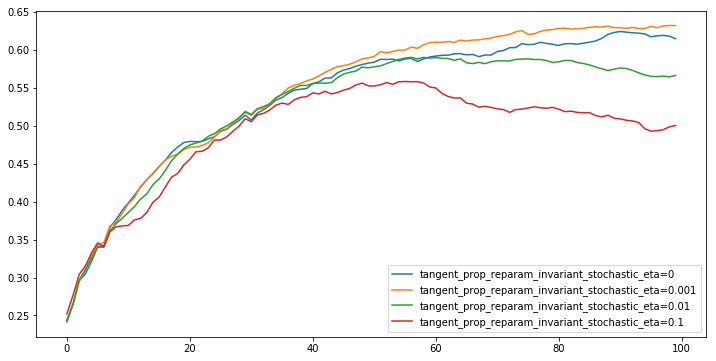

In [72]:
plt.figure(figsize=(12, 6))

for mode in modes:
    plt.plot(ewma(DataFrame(test_accs[mode]), alpha=0.1))
plt.legend(modes)